<a href="https://colab.research.google.com/github/VioIchigo/Course-Projects/blob/master/Copy_of_hw4_notebook.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

[![Open In Colab](https://colab.research.google.com/assets/colab-badge.svg)](https://colab.research.google.com/github/rll/deepul/blob/master/homeworks/hw4/hw4_notebook.ipynb)

# Getting Started

## Overview
This semester, all homeworks will be conducted through Google Colab notebooks. All code for the homework assignment will be written and run in this notebook. Running in Colab will automatically provide a GPU, but you may also run this notebook locally by following [these instructions](https://research.google.com/colaboratory/local-runtimes.html) if you wish to use your own GPU.

You will save images in the notebooks to use and fill out a given LaTeX template which will be submitted to Gradescope, along with your notebook code.

## Using Colab
On the left-hand side, you can click the different icons to see a Table of Contents of the assignment, as well as local files accessible through the notebook.

Make sure to go to **Runtime -> Change runtime type** and select **GPU** as the hardware accelerator. This allows you to use a GPU. Run the cells below to get started on the assignment. Note that a session is open for a maximum of 12 hours, and using too much GPU compute may result in restricted access for a short period of time. Please start the homework early so you have ample time to work.

**If you loaded this notebook from clicking "Open in Colab" from github, you will need to save it to your own Google Drive to keep your work.**

## General Tips
In each homework problem, you will implement a GAN model and run it on a dataset. We provide the expected outputs to help as a sanity check.

Feel free to print whatever output (e.g. debugging code, training code, etc) you want, as the graded submission will be the submitted pdf with images.

After you complete the assignment, download all of the image outputted in the results/ folder and upload them to the figure folder in the given latex template.

Run the cells below to download and load up the starter code.

In [ ]:
!if [ -d deepul ]; then rm -Rf deepul; fi
!git clone https://github.com/rll/deepul.git 
!pip install ./deepul
from deepul.hw4_helper import *
import deepul.pytorch_util as ptu
import warnings
warnings.filterwarnings('ignore')

Cloning into 'deepul'...
remote: Enumerating objects: 704, done.
remote: Total 704 (delta 0), reused 0 (delta 0), pack-reused 704
Receiving objects: 100% (704/704), 84.47 MiB | 11.44 MiB/s, done.
Resolving deltas: 100% (313/313), done.
Processing ./deepul
  Created wheel for deepul: filename=deepul-0.1.0-cp36-none-any.whl size=12725 sha256=cd33418da53af6e504b6827f5916282a462853a2ee04398b1d13d4d4f01e59bf
  Stored in directory: /tmp/pip-ephem-wheel-cache-r3fpuo47/wheels/39/1a/4b/a6f51db275abb2e5dae32540e06ed5011e792f162467bd3aa8
Successfully built deepul
  Found existing installation: deepul 0.1.0
    Uninstalling deepul-0.1.0:
      Successfully uninstalled deepul-0.1.0


# Question 1: Warmup [20pt]

In this question, we will train 3 different variants of GANs on an easy 1D dataset. 

Execute the cell below to visualize our datasets.

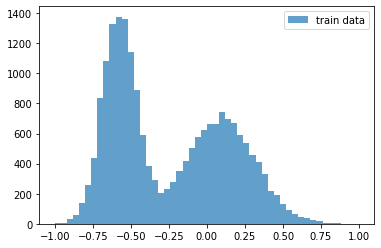

In [ ]:
visualize_q1_dataset()

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.utils.data as data
import torch.optim as optim
from scipy.stats import norm
from tqdm import trange, tqdm_notebook
from pdb import set_trace as st

# import deepul_helper.pytorch_util as ptu
# from deepul_helper.data import load_flow_demo_1, generate_1d_flow_data, NumpyDataset
# from deepul_helper.visualize import plot_hist, plot_train_curves, visualize_demo1_flow, plot_demo2_losses
# from deepul_helper.data import load_flow_demo_3, load_flow_demo_2, make_scatterplot

# def load_q1_data(n=20000):
#     assert n % 2 == 0
#     gaussian1 = np.random.normal(loc=-1, scale=0.25, size=(n//2,))
#     gaussian2 = np.random.normal(loc=0.5, scale=0.5, size=(n//2,))
#     data = (np.concatenate([gaussian1, gaussian2]) + 1).reshape([-1, 1])
#     scaled_data = (data - np.min(data)) / (np.max(data) - np.min(data) + 1e-8)
#     return 2 * scaled_data -1

# def load_q2_data(n=20000):
#     assert n % 2 == 0
#     gaussian1 = np.random.normal(loc=-1, scale=0.03, size=(n//2,))
#     gaussian2 = np.random.normal(loc=1, scale=0.03, size=(n//2,))
#     data = (np.concatenate([gaussian1, gaussian2]) + 1).reshape([-1, 1])
#     scaled_data = (data - np.min(data)) / (np.max(data) - np.min(data) + 1e-8)
#     return 2 * scaled_data - 1

# def load_warmup_data(n=20000):
#     gaussian1 = np.random.normal(loc=-1, scale=0.25, size=(n//2,))
#     data = gaussian1.reshape([-1, 1]) + 1
#     scaled_data = (data - np.min(data)) / (np.max(data) - np.min(data) + 1e-8)
#     return 2 * scaled_data -1


# train_data = load_q1_data()
# train_data2 = load_q2_data()
# warmup_data = load_warmup_data()

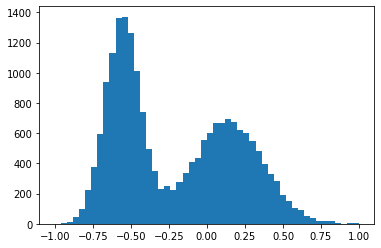

In [ ]:
plt.hist(train_data, bins=50)
plt.show()

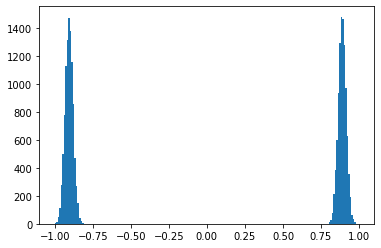

In [ ]:
plt.hist(train_data2, bins=200)
plt.show()

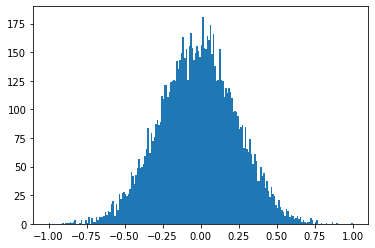

In [ ]:
plt.hist(warmup_data, bins=200)
plt.show()

## Part 1(a)
In this part, we'll train our generator and discriminator via the original minimax GAN objective:
<insert GAN Objective here>
$$min_{G} max_{D} \mathbb{E}_{x \sim p_{data}} [\log D(x)] + \mathbb{E}_{z \sim p(z)}[\log (1-D(G(z)))]$$

Use an MLP for both your generator and your discriminator, and train until the generated distribution resembles the target distribution. 



### Solution

In [ ]:
from pdb import set_trace as st
import numpy as np

class D_2d(nn.Module):
    def __init__(self, channel_dim, feature_dim):
        super(D_2d, self).__init__()
        self.main = nn.Sequential(
            nn.Linear(channel_dim, feature_dim),
            nn.LeakyReLU(),
            nn.Linear(feature_dim, feature_dim),
            nn.LeakyReLU(),
            nn.Linear(feature_dim, 1),
            nn.Sigmoid(),
        )


    def forward(self, x):
        output = self.main(x)
        return output

class G_2d(nn.Module):
    def __init__(self, channel_dim, feature_dim):
        super(G_2d, self).__init__()
        self.latent_dim = 1
        self.channel_dim = channel_dim
        self.main = nn.Sequential(
            nn.Linear(1, feature_dim),
            nn.LeakyReLU(),
            nn.Linear(feature_dim, feature_dim),
            nn.LeakyReLU(),
            nn.Linear(feature_dim, channel_dim),
        )

    def forward(self, x):
        output = self.main(x)
        output = nn.Tanh()(output)
        return output

    def loss(self, x):
        bs = x.shape[0]
        z = torch.Variable(torch.from_numpy(np.random.normal(0, 1, (bs, self.latent_dim)))).cuda()
        return self.cross_entropy(self.D(x), self.D(self(z)))

    def sample(self, n):
        z = torch.randn(n, self.latent_dim).cuda()
        out = self(z)
        return out


class GAN_2d(nn.Module):
    def __init__(self, D, G, mode=None):
        super(GAN_2d, self).__init__()
        self.D = D
        self.G = G
        self.cross_entropy = nn.BCELoss()
        self.mode = mode
        

    def D_loss(self, x):
        x = x.float()
        bs = x.shape[0]
        samples = self.G.sample(bs)

        pred = torch.cat((self.D(samples), self.D(x)), dim=0)
        labels = torch.cat((torch.zeros(bs), torch.ones(bs)), dim=0).cuda()
        return F.binary_cross_entropy(pred, labels)

    def G_loss(self, x):
        x = x.float()
        bs = x.shape[0]

        recon = self.D(self.G.sample(bs))
        labels = torch.ones(bs).cuda()
        return F.binary_cross_entropy(recon, labels)

    def loss(self, x):
      return -self.D_loss(x)


def train(model, train_loader, D_optimizer, G_optimizer, epoch):
  model.train()
  
  d_losses = []
  g_losses = []
  for x in train_loader:
    x = x.cuda().contiguous()
    loss1 = -model.loss(x)

    D_optimizer.zero_grad()
    loss1.backward()
    D_optimizer.step()

    loss2 = model.loss(x)
    G_optimizer.zero_grad()
    loss2.backward()
    G_optimizer.step()

    d_losses.append(loss1.item())
    g_losses.append(loss2.item())
  return d_losses, g_losses


def train_epochs(model, train_loader, train_args):
    epochs, lr, betas = train_args['epochs'], train_args['lr'], train_args['betas']
    D_optimizer = optim.Adam(model.D.parameters(), lr=lr, betas=betas)
    G_optimizer = optim.Adam(model.G.parameters(), lr=lr, betas=betas)

    d_losses = []
    g_losses = []
    for epoch in range(epochs):
        loss1, loss2 = train(model, train_loader, D_optimizer, G_optimizer, epoch)
        d_losses.extend(loss1)
        g_losses.extend(loss2)

    return d_losses, g_losses

def q1_a(train_data):
  """
  train_data: An (20000, 1) numpy array of floats in [-1, 1]

  Returns
  - a (# of training iterations,) numpy array of discriminator losses evaluated every minibatch
  - a numpy array of size (5000,) of samples drawn from your model at epoch #1
  - a numpy array of size (1000,) linearly spaced from [-1, 1]; hint: np.linspace
  - a numpy array of size (1000,), corresponding to the discriminator output (after sigmoid) 
      at each location in the previous array at epoch #1

  - a numpy array of size (5000,) of samples drawn from your model at the end of training
  - a numpy array of size (1000,) linearly spaced from [-1, 1]; hint: np.linspace
  - a numpy array of size (1000,), corresponding to the discriminator output (after sigmoid) 
      at each location in the previous array at the end of training
  """
  
  """ YOUR CODE HERE """
  _, channel_dim = train_data.shape
  feature_dim = 256
  betas=(0, 0.9)
  lr = 1e-4
  epochs = 5
  """model"""
  D = D_2d(channel_dim, feature_dim).cuda()
  G = G_2d(channel_dim, feature_dim).cuda()
  model = GAN_2d(D, G).cuda()

  initial_samples = G.sample(5000).detach().cpu().numpy()
  lins = np.linspace(-1, 1, 1000).reshape((-1, 1))
  initial_lins = G(torch.from_numpy(lins).cuda().float())
  initial_output = D(initial_lins).detach().cpu().numpy()

  """training"""
  train_loader = data.DataLoader(train_data, batch_size=128, shuffle=True)
  d_losses, g_losses = train_epochs(model, train_loader, dict(epochs=epochs, lr=lr, betas=betas))

  final_samples = G.sample(5000).detach().cpu().numpy()
  final_lins = G(torch.from_numpy(lins).cuda().float())
  final_output = D(final_lins).detach().cpu().numpy()
  final_lins, initial_lins = final_lins.detach().cpu().numpy(), initial_lins.detach().cpu().numpy()

  return d_losses, initial_samples, initial_lins, initial_output, final_samples, final_lins, final_output


### Results

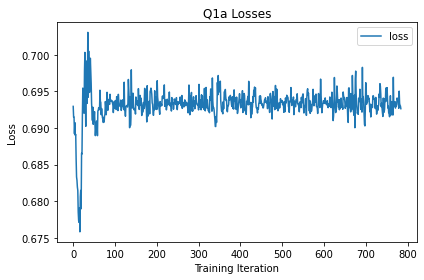

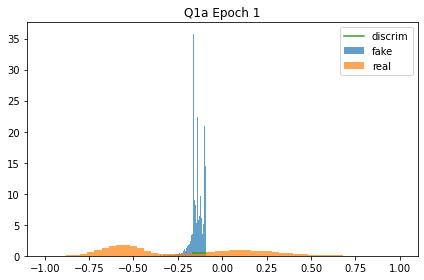

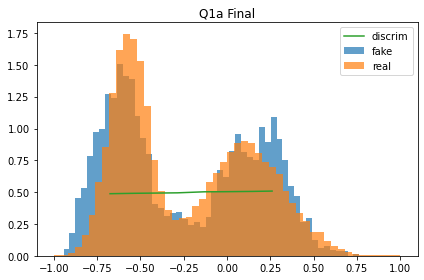

In [ ]:
q1_save_results('a', q1_a)

## Part 1(b)
Here, we'll use the non-saturating formulation of the GAN objective. Now, we have two separate losses:
$$L^{(D)} = \mathbb{E}_{x \sim p_{data}} [\log D(x)] + \mathbb{E}_{z \sim p(z)}[\log (1-D(G(z)))]$$
$$L^{(G} = - \mathbb{E}_{z \sim p(z)} \log(D(G(z))$$

 ### Solution

In [ ]:
def train(model, train_loader, D_optimizer, G_optimizer, epoch):
  model.train()
  
  d_losses = []
  g_losses = []
  for x in train_loader:
    x = x.cuda().contiguous()
    loss1 = model.D_loss(x)

    D_optimizer.zero_grad()
    loss1.backward()
    D_optimizer.step()

    loss2 = model.G_loss(x)
    G_optimizer.zero_grad()
    loss2.backward()
    G_optimizer.step()

    d_losses.append(loss1.item())
    g_losses.append(loss2.item())
  return d_losses, g_losses

def q1_b(train_data):
  """
  train_data: An (20000, 1) numpy array of floats in [-1, 1]

  Returns
  - a (# of training iterations,) numpy array of discriminator losses evaluated every minibatch
  - a numpy array of size (5000,) of samples drawn from your model at epoch #1
  - a numpy array of size (100,) linearly spaced from [-1, 1]; hint: np.linspace
  - a numpy array of size (100,), corresponding to the discriminator output (after sigmoid) 
      at each location in the previous array at epoch #1

  - a numpy array of size (5000,) of samples drawn from your model at the end of training
  - a numpy array of size (1000,) linearly spaced from [-1, 1]; hint: np.linspace
  - a numpy array of size (1000,), corresponding to the discriminator output (after sigmoid) 
      at each location in the previous array at the end of training
  """
  
  """ YOUR CODE HERE """
  _, channel_dim = train_data.shape
  feature_dim = 256
  betas=(0, 0.9)
  lr = 1e-4
  epochs = 2
  """model"""
  D = D_2d(channel_dim, feature_dim).cuda()
  G = G_2d(channel_dim, feature_dim).cuda()
  model = GAN_2d(D, G).cuda()

  initial_samples = G.sample(5000).detach().cpu().numpy()
  lins = np.linspace(-1, 1, 1000).reshape((-1, 1))
  initial_lins = G(torch.from_numpy(lins).cuda().float())
  initial_output = D(initial_lins).detach().cpu().numpy()

  """training"""
  train_loader = data.DataLoader(train_data, batch_size=128, shuffle=True)
  d_losses, g_losses = train_epochs(model, train_loader, dict(epochs=epochs, lr=lr, betas=betas))

  final_samples = G.sample(5000).detach().cpu().numpy()
  final_lins = G(torch.from_numpy(lins).cuda().float())
  final_output = D(final_lins).detach().cpu().numpy()
  final_lins, initial_lins = final_lins.detach().cpu().numpy(), initial_lins.detach().cpu().numpy()

  return d_losses, initial_samples, initial_lins, initial_output, final_samples, final_lins, final_output


 ### Results

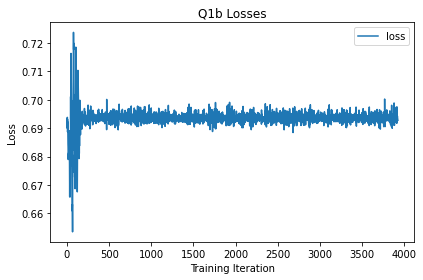

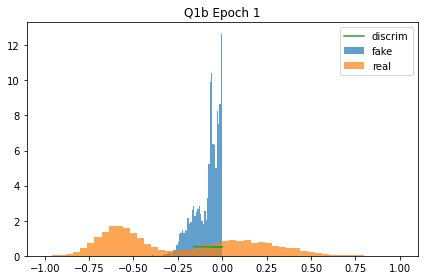

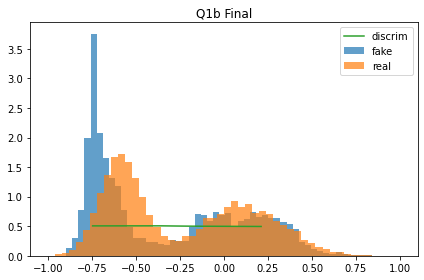

In [ ]:
q1_save_results('b', q1_b)

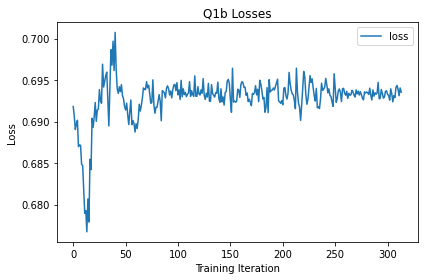

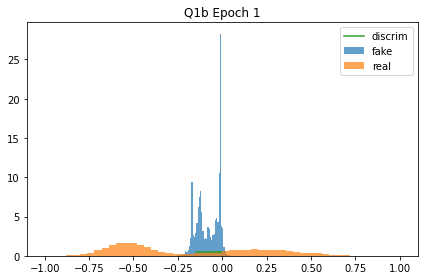

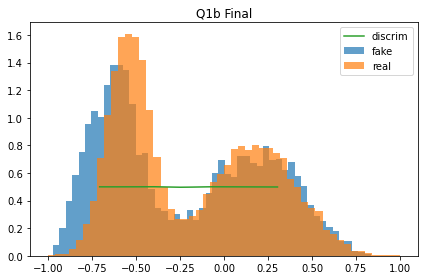

In [ ]:
q1_save_results('b', q1_b)

# Question 2: GANs on CIFAR-10 [35pt]

In this exercise, you will train GANs on CIFAR-10. Execute the cell below to visualize the dataset. 

Extracting ./data/cifar-10-python.tar.gz to ./data


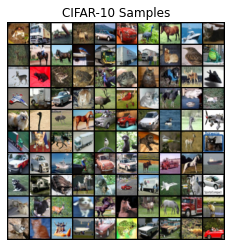

In [ ]:
visualize_q2_data()

 We'll use the CIFAR-10 architecture from the [SN-GAN paper](https://arxiv.org/pdf/1802.05957.pdf), with $z \in \mathbb R ^{128}$, with $z \sim \mathcal N (0, I_{128})$. Instead of upsampling via transposed convolutions and downsampling via pooling or striding, we'll use these DepthToSpace and SpaceToDepth methods for changing the spatial configuration of our hidden states. 

```
class DepthToSpace(nn.Module):
    def __init__(self, block_size):
        super().__init__()
        self.block_size = block_size
        self.block_size_sq = block_size * block_size

    def forward(self, input):
        output = input.permute(0, 2, 3, 1)
        (batch_size, d_height, d_width, d_depth) = output.size()
        s_depth = int(d_depth / self.block_size_sq)
        s_width = int(d_width * self.block_size)
        s_height = int(d_height * self.block_size)
        t_1 = output.reshape(batch_size, d_height, d_width, self.block_size_sq, s_depth)
        spl = t_1.split(self.block_size, 3)
        stack = [t_t.reshape(batch_size, d_height, s_width, s_depth) for t_t in spl]
        output = torch.stack(stack, 0).transpose(0, 1).permute(0, 2, 1, 3, 4).reshape(batch_size, s_height, s_width,
                                                                                      s_depth)
        output = output.permute(0, 3, 1, 2)
        return output


class SpaceToDepth(nn.Module):
    def __init__(self, block_size):
        super().__init__()
        self.block_size = block_size
        self.block_size_sq = block_size * block_size

    def forward(self, input):
        output = input.permute(0, 2, 3, 1)
        (batch_size, s_height, s_width, s_depth) = output.size()
        d_depth = s_depth * self.block_size_sq
        d_width = int(s_width / self.block_size)
        d_height = int(s_height / self.block_size)
        t_1 = output.split(self.block_size, 2)
        stack = [t_t.reshape(batch_size, d_height, d_depth) for t_t in t_1]
        output = torch.stack(stack, 1)
        output = output.permute(0, 2, 1, 3)
        output = output.permute(0, 3, 1, 2)
        return output

# Spatial Upsampling with Nearest Neighbors
Upsample_Conv2d(in_dim, out_dim, kernel_size=(3, 3), stride=1, padding=1):
    x = torch.cat([x, x, x, x], dim=1)
    DepthToSpace(block_size=2)
    Conv2d(in_dim, out_dim, kernel_size, stride=stride, padding=padding)


# Spatial Downsampling with Spatial Mean Pooling
Downsample_Conv2d(in_dim, out_dim, kernel_size=(3, 3), stride=1, padding=1):
        SpaceToDepth(2)
        torch.sum(x.chunk(4, dim=1)) / 4.0
        nn.Conv2d(in_dim, out_dim, kernel_size,
                              stride=stride, padding=padding, bias=bias)
```

Here's pseudocode for how we'll implement a ResBlockUp, used in the generator:

```
ResnetBlockUp(x, in_dim, kernel_size=(3, 3), n_filters=256):
    _x = x
    _x = nn.BatchNorm2d(in_dim)(_x)
    _x = nn.ReLU()(_x)
    _x = nn.Conv2d(in_dim, n_filters, kernel_size, padding=1)(_x)
    _x = nn.BatchNorm2d(n_filters)(_x)
    _x = nn.ReLU()(_x)
    residual = Upsample_Conv2d(n_filters, n_filters, kernel_size, padding=1)(_x)
    shortcut = Upsample_Conv2d(in_dim, n_filters, kernel_size=(1, 1), padding=0)(x)
    return residual + shortcut
```
The ResBlockDown module is similar, except it uses Downsample_Conv2d and omits the BatchNorm.

Finally, here's the architecture for the generator:
```
def Generator(*, n_samples=1024, n_filters=128):
    z = Normal(0, 1)([n_samples, 128])
    nn.Linear(128, 4*4*256)
    reshape output of linear layer
    ResnetBlockUp(in_dim=256, n_filters=n_filters),
    ResnetBlockUp(in_dim=n_filters, n_filters=n_filters),
    ResnetBlockUp(in_dim=n_filters, n_filters=n_filters),
    nn.BatchNorm2d(n_filters),
    nn.ReLU(),
    nn.Conv2d(n_filters, 3, kernel_size=(3, 3), padding=1),
    nn.Tanh()
```
Again, the discriminator has the same architecture, except with ResnetBlockDown and no BatchNorm.

**Hyperparameters**

We'll implement [WGAN-GP](https://arxiv.org/abs/1704.00028), which uses a gradient penalty to regularize the discriminator. Use the Adam optimizer with $\alpha = 2e-4$, $\beta_1 = 0$, $\beta_2 = 0.9$, $\lambda = 10$, $n_{critic} = 5$. Use a batch size of 256 and n_filters=128 within the ResBlocks. Train for at least 25000 gradient steps, with the learning rate linearly annealed to 0 over training. 

**You will provide the following deliverables**
1. Inception score (CIFAR-10 version) of the final model. We provide a utility that will automatically do this for you.
2. Fréchet inception distance (bonus, 5pts)
3. Discriminator loss across training
4. 100 samples. 

## Solution

In [ ]:
class DepthToSpace(nn.Module):
    def __init__(self, block_size):
        super().__init__()
        self.block_size = block_size
        self.block_size_sq = block_size * block_size

    def forward(self, input):
        output = input.permute(0, 2, 3, 1)
        (batch_size, d_height, d_width, d_depth) = output.size()
        s_depth = int(d_depth / self.block_size_sq)
        s_width = int(d_width * self.block_size)
        s_height = int(d_height * self.block_size)
        t_1 = output.reshape(batch_size, d_height, d_width, self.block_size_sq, s_depth)
        spl = t_1.split(self.block_size, 3)
        stack = [t_t.reshape(batch_size, d_height, s_width, s_depth) for t_t in spl]
        output = torch.stack(stack, 0).transpose(0, 1).permute(0, 2, 1, 3, 4).reshape(batch_size, s_height, s_width,
                                                                                      s_depth)
        output = output.permute(0, 3, 1, 2)
        return output


class SpaceToDepth(nn.Module):
    def __init__(self, block_size):
        super().__init__()
        self.block_size = block_size
        self.block_size_sq = block_size * block_size

    def forward(self, input):
        output = input.permute(0, 2, 3, 1).contiguous()
        (batch_size, s_height, s_width, s_depth) = output.size()
        d_depth = s_depth * self.block_size_sq
        d_width = int(s_width / self.block_size)
        d_height = int(s_height / self.block_size)
        t_1 = output.split(self.block_size, 2)
        stack = [t_t.reshape(batch_size, d_height, d_depth) for t_t in t_1]
        output = torch.stack(stack, 1)
        output = output.permute(0, 2, 1, 3).contiguous()
        output = output.permute(0, 3, 1, 2).contiguous()
        return output

# Spatial Upsampling with Nearest Neighbors
class Upsample_Conv2d(nn.Module):
    def __init__(self, in_dim, out_dim, kernel_size=(3, 3), stride=1, padding=1):
        super().__init__()
        self.main = nn.Sequential(
            DepthToSpace(block_size=2),
            nn.Conv2d(in_dim, out_dim, kernel_size, stride=stride, padding=padding),
        )

    def forward(self, x):
        x = torch.cat([x, x, x, x], dim=1)
        x = self.main(x)
        return x
 
 
# Spatial Downsampling with Spatial Mean Pooling
class Downsample_Conv2d(nn.Module):
    def __init__(self, in_dim, out_dim, kernel_size=(3, 3), stride=1, padding=1):
        super().__init__()
        self.ly1 = SpaceToDepth(2)
        self.ly2 = nn.Conv2d(in_dim, out_dim, kernel_size, stride=stride, padding=padding)

    def forward(self, x):
        x = self.ly1(x)
        B, D, _, _ = x.shape
        x = x.view(B, 4, D//4, *x.shape[2:])
        x = torch.sum(x, dim = 1) / 4.0 #[128, 128, 16, 16]
        x = self.ly2(x)
        return x


class ResnetBlockUp(nn.Module):
    def __init__(self, in_dim, kernel_size=(3, 3), n_filters=256):
        super().__init__()
        self.main = nn.Sequential(
            nn.BatchNorm2d(in_dim), #[128, 256, 4, 4]
            nn.ReLU(), 
            nn.Conv2d(in_dim, n_filters, kernel_size, padding=1), #[128, 128, 4, 4]
            nn.ReLU(),
            Upsample_Conv2d(n_filters, n_filters, kernel_size, padding=1),
        )

        self.short = Upsample_Conv2d(in_dim, n_filters, kernel_size=(1, 1), padding=0)


    def forward(self, x):
        residual = self.main(x)
        shortcut = self.short(x)
        return residual + shortcut #[128, 128, 8, 8]


class ResnetBlockDown(nn.Module):
    def __init__(self, in_dim, kernel_size=(3, 3), n_filters=256):
        super().__init__()
        self.main = nn.Sequential(
            Downsample_Conv2d(n_filters, n_filters, kernel_size, padding=1),
            nn.ReLU(),
            nn.Conv2d(in_dim, n_filters, kernel_size, padding=1),
        )

        self.short = Downsample_Conv2d(in_dim, n_filters, kernel_size=(1, 1), padding=0)


    def forward(self, x):
        residual = self.main(x)
        st()
        shortcut = self.short(x)
        return residual + shortcut
          
class G(nn.Module):
    def __init__(self, n_filters = 128):
        super().__init__()
        self.linear = nn.Linear(128, 4*4*256)
        self.net = nn.Sequential(
            ResnetBlockUp(in_dim=256, n_filters=n_filters),
            ResnetBlockUp(in_dim=n_filters, n_filters=n_filters),
            ResnetBlockUp(in_dim=n_filters, n_filters=n_filters),
            nn.BatchNorm2d(n_filters),
            nn.ReLU(),
            nn.Conv2d(n_filters, 3, kernel_size=(3, 3), padding=1),
            nn.Sigmoid()
            )
        self.dist = torch.distributions.Normal(0, 1)

    def forward(self, n_samples=1024): #sampling
        z = self.dist.sample([n_samples, 128]).cuda()
        bs = n_samples
        z = self.linear(z)
        z = z.view(bs, 256, 4, 4)
        samples = self.net(z)
        return samples
        
class D(nn.Module):
    def __init__(self, n_filters = 128):
        super().__init__()
        self.linear = nn.Linear(4*4*256, 128)
        self.net = nn.Sequential(
            nn.Conv2d(3, n_filters, kernel_size=(3, 3), padding=1),
            nn.ReLU(),
            ResnetBlockDown(in_dim=n_filters, n_filters=n_filters),
            ResnetBlockDown(in_dim=n_filters, n_filters=n_filters),
            ResnetBlockDown(in_dim=n_filters, n_filters=256),
            )

    def forward(self, x):
        #reshape output of linear layer
        x = x.float()
        bs = x.shape[0]
        x = self.net(x) #[128, 256, 4, 4]
        x = x.view(bs, -1)
        x = self.linear(x)
        return x


class GAN(nn.Module):
    def __init__(self, D, G, n_critic, improve = 1, mode=None):
        super(GAN, self).__init__()
        self.D = D
        self.G = G
        self.cross_entropy = nn.BCELoss()
        self.improve = improve
        self.mode = mode
        self.n_critic = n_critic
        self.lamb = 10


    def D_loss(self, x):
        x = x.float()
        bs = x.shape[0]
        samples = self.G(bs)
        samples = samples

        recon = self.D(samples)
        gradient_penalty = self.gradient_penalty(x, samples)

        return -torch.mean(self.D(x)) + torch.mean(recon) + self.lamb * gradient_penalty

    def G_loss(self, x):
        x = x.float()
        bs = x.shape[0]
        fake = self.G(bs)
        fake = self.D(fake)
        return -torch.mean(fake)

    def gradient_penalty(self, real, fake):
        bs = real.shape[0]
        epis = torch.from_numpy(np.random.uniform(0,1,bs)).view(bs, 1, 1, 1).cuda()
        x_hat = epis * real + ((1 - epis) * fake)
        interpolates = torch.autograd.Variable(x_hat, requires_grad=True)
        d_interpolates = self.D(interpolates)

        gradients = torch.autograd.grad(outputs=d_interpolates, inputs=interpolates,
                              grad_outputs=torch.ones(d_interpolates.size()).cuda(),
                              create_graph=True, retain_graph=True, only_inputs=True)[0]
        gradients = gradients.view(gradients.size(0), -1)
        gradient_penalty = ((gradients.norm(2, dim=1) - 1) ** 2).mean()
        return gradient_penalty



def train(model, train_loader, D_optimizer, G_optimizer, epoch):
  model.train()
  
  d_losses = []
  count = 1
  for x in train_loader:
    x = x.cuda().contiguous()

    loss1 = model.D_loss(x)

    D_optimizer.zero_grad()
    loss1.backward()
    D_optimizer.step()

    if count % model.n_critic == 0:

        loss2 = model.G_loss(x)
        G_optimizer.zero_grad()
        loss2.backward()
        G_optimizer.step()

    d_losses.append(loss1.item())
    count += 1
  return d_losses



def train_epochs(model, train_loader, train_args):
    epochs, lr, betas = train_args['epochs'], train_args['lr'], train_args['betas']
    D_optimizer = optim.Adam(model.D.parameters(), lr=lr, betas=betas)
    G_optimizer = optim.Adam(model.G.parameters(), lr=lr, betas=betas)

    d_losses = []
    for epoch in range(epochs):
        loss1 = train(model, train_loader, D_optimizer, G_optimizer, epoch)
        d_losses.extend(loss1)

        samples = model.G(1000).detach().cpu().numpy()
        samples = np.transpose(samples, (0, 2, 3, 1))
        print("epoch: ", epoch, ",loss: ", loss1)
        show_samples(samples[:100] * 255.0, fname='results/q2_samples.png', title=f'CIFAR-10 generated samples')

    return d_losses




def q2(train_data):
    """
    train_data: An (n_train, 3, 32, 32) numpy array of CIFAR-10 images with values in [0, 1]

    Returns
    - a (# of training iterations,) numpy array of WGAN critic train losses evaluated every minibatch
    - a (1000, 32, 32, 3) numpy array of samples from your model in [0, 1]. 
        The first 100 will be displayed, and the rest will be used to calculate the Inception score. 
    """

    """ YOUR CODE HERE """
    _, C, H, W = train_data.shape
    betas=(0, 0.9)
    lr = 2e-4
    epochs = 100
    n_critic = 5
    model = GAN(D(), G(), n_critic).cuda()
    train_loader = data.DataLoader(train_data, batch_size=128, shuffle=True)
    d_losses = train_epochs(model, train_loader, dict(epochs=epochs, lr=lr, betas=betas))
    samples = model.G(1000).detach().cpu().numpy()
    samples = np.transpose(samples, (0, 2, 3, 1))
    return d_losses, samples


## Results

In [ ]:
q2_save_results(q2)

Files already downloaded and verified
> <ipython-input-52-fd0abe9b260b>(107)forward()
-> shortcut = self.short(x)
(Pdb) x.shape
torch.Size([128, 128, 32, 32])
(Pdb) residual.shape
torch.Size([128, 128, 16, 16])


# Question 3: Representation Learning with BiGAN on MNIST [45pt]

In this part, we train a BiGAN on the MNIST dataset. Execute the cell below to visualize the dataset.

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


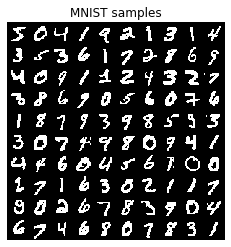

In [ ]:
visualize_q3_data()

In BiGAN, in addition to training a generator $G$ and a discriminator $D$, we train an encoder $E$ that maps from real images $x$ to latent codes $z$. The discriminator now must learn to jointly identify fake $z$, fake $x$, and paired $(x, z)$ that don't belong together. In the original [BiGAN paper](https://arxiv.org/pdf/1605.09782.pdf), they prove that the optimal $E$ learns to invert the generative mapping $G: z \rightarrow x$. Our overall minimax term is now
$$V(D, E, G) = \mathbb{E}_{x \sim p_x}[\mathbb{E}_{z \sim p_E(\cdot | x)}[\log D(x, z)]] + \mathbb{E}_{z \sim p_z}[\mathbb{E}_{x \sim p_G(\cdot | z)}[\log (1 - D(x, z))]]$$

**Architecture**

We will closely follow the MNIST architecture outlined in the original BiGAN paper, Appendix C.1, with one modification: instead of having $z \sim \text{Uniform}[-1, 1]$, we use $z \sim \mathcal N (0, 1)$ with $z \in \mathbb R ^{50}$. 

**Hyperparameters**

We make several modifications to what is listed in the BiGAN paper. We apply $l_2$ weight decay to all weights and decay the step size $\alpha$ linearly to 0 over the course of training. Weights are initialized via the default PyTorch manner. We recommend training for at least 100 epochs -- this part is much less computationally expensive than previous homeworks. 

**Reconstructions**

You should take the first 20 images from the MNIST training set and then display the reconstructions $x_{recon} = G(E(x))$. It's ok if your reconstructions are somewhat lossy; ours are too. We will provide a utility to show these. 

**Testing the representation**

We want to see how good a linear classifier $L$ we can learn such that 
$$y \approx L(E(x))$$
where $y$ is the appropriate label. Fix $E$ and learn a weight matrix $W$ such that your linear classifier is composed of passing $x$ through $E$, then multiplying by $W$, then applying a softmax nonlinearity. Train this via gradient descent with the cross-entropy loss. 

As a baseline, randomly initialize another network $E_{random}$ with the same architecture, fix its weights, and train a linear classifier on top, as done in the previous part.


**You will provide the following deliverables**
1. Plot of the minimax loss term. 
2. 100 samples from the BiGAN
3. A comparison of MNIST images $x$ with their reconstructions $G(E(x))$.
4. Test loss plot for the linear classifier trained on the pretrained encoder, and a randomly initialized encoder. 
5. Final test losses for the two linear classifiers. 

**Feel free to train the networks separately, save the necessary information, and simply use our function to generate the appropriate figures.**


## Solution

In [ ]:
class E(nn.Module):
    def __init__(self, out_dim=50):
        """ x -> E(x) """
        super().__init__()
        self.out_dim = out_dim
        self.img_dim = 28 * 28

        self.main = nn.Sequential(
            # x: [B, 1, 28, 28]
            nn.Linear(self.img_dim, 1024),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Linear(1024, 1024),
            nn.BatchNorm1d(1024),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Linear(1024, out_dim),
        )

    def forward(self, x):
        return self.main(x)


          
class G(nn.Module):
    def __init__(self, z_dim = 50):
        super().__init__()
        """ z -> G(z) """
        self.z_dim = z_dim
        self.img_dim = 28 * 28 

        self.main = nn.Sequential(
            nn.Linear(self.z_dim, 1024),
            nn.ReLU(),
            nn.Linear(1024, 1024),
            nn.BatchNorm1d(1024),
            nn.ReLU(),
            nn.Linear(1024, self.img_dim),
            nn.Tanh()
        )
        self.dist = torch.distributions.Normal(0, 1)


    def forward(self, n):
        samples = self.dist.sample([n, self.z_dim]).cuda()
        g_samples = self.main(samples)
        return samples, g_samples

    def recon(self, x):
        x = x.float()
        return self.main(x)


        
class D(nn.Module):
    def __init__(self):
        super().__init__()

        self.img_dim = 28 * 28 
        self.z_dim = 50 

        self.in_dim = self.img_dim + self.z_dim

        self.main = nn.Sequential(
            nn.Linear(self.in_dim, 1024),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Linear(1024, 1024),
            nn.BatchNorm1d(1024),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Linear(1024, 1),
            nn.Sigmoid(),
        )


    def forward(self, x):
        return self.main(x)



class BiGAN(nn.Module):
    def __init__(self, D, G, E):
        super(BiGAN, self).__init__()
        self.D = D
        self.G = G
        self.E = E

    def D_loss(self, x):
        x = x.float()
        bs = x.shape[0]
        z, g_z = self.G(bs) #50, img_dim

        e_x = self.E(x) #50

        zs = torch.cat([g_z, z], dim = -1)
        xs = torch.cat([x, e_x], dim = -1)
        d_zs = self.D(zs)
        d_xs = self.D(xs)

        loss1 = F.binary_cross_entropy(d_zs, torch.zeros(bs).cuda())
        loss2 = F.binary_cross_entropy(d_xs, torch.ones(bs).cuda())
        return loss1 + loss2


    def G_loss(self, x):
        return -self.D_loss(x)

def train(model, train_loader, D_optimizer, G_optimizer, epoch):
  model.train()
  
  d_losses = []
  for data_pair in train_loader:
    x = data_pair[0]
    label = data_pair[1]

    x = x.cuda().contiguous()
    bs = x.shape[0]
    x = x.view(bs, -1)
    loss1 = model.D_loss(x)

    D_optimizer.zero_grad()
    loss1.backward()
    D_optimizer.step()

    loss2 = model.G_loss(x)
    G_optimizer[0].zero_grad()
    G_optimizer[1].zero_grad()
    loss2.backward()
    G_optimizer[0].step()
    G_optimizer[1].step()

    d_losses.append(loss1.item())
    
  return d_losses

def normalize(data):
    return (data-data.min())/(data.max()-data.min())

def normalize255(data):
    return 255.*(data-data.min())/(data.max()-data.min())

def train_epochs(model, train_loader, test_loader, train_args, sample_data):
    epochs, lr, betas = train_args['epochs'], train_args['lr'], train_args['betas']
    D_optimizer = optim.Adam(model.D.parameters(), lr=lr, betas=betas, weight_decay = 2.5e-5)
    G_optimizer = [optim.Adam(model.G.parameters(), lr=lr, betas=betas, weight_decay = 2.5e-5), optim.Adam(model.E.parameters(), lr=lr, betas=betas, weight_decay = 2.5e-5)]

    d_losses = []
    for epoch in range(epochs):
        print("epoch: ", epoch)
        loss1 = train(model, train_loader, D_optimizer, G_optimizer, epoch)
        d_losses.extend(loss1)

        real = sample_data.reshape((20, -1)).cuda().float()
        recon = model.G.recon(model.E(real).cuda())*255.
        real = real.detach().cpu().numpy()
        recon = recon.detach().cpu().numpy()
        real = real.reshape((20, 28, 28, 1))
        recon = recon.reshape((20, 28, 28, 1))
        real = normalize255(real)
        recon = normalize255(recon)
        reconstructions = np.concatenate((real, recon), axis = 0)

        samples = model.G(100)[1].detach().cpu().numpy().reshape((100, 28, 28, 1))


        plot_gan_training(d_losses, 'Q3 Losses', 'results/q3_gan_losses.png')
        samples = normalize(samples)
        show_samples(samples * 255.0, fname='results/q3_samples.png', title='BiGAN generated samples')
        show_samples(reconstructions, nrow=20, fname='results/q3_reconstructions.png', title=f'BiGAN reconstructions')
    return d_losses



model = BiGAN(D(), G(), E()).cuda()
def q3(train_data, test_data):
    """
    train_data: A PyTorch dataset that contains (n_train, 28, 28) MNIST digits, normalized to [-1, 1]
                Documentation can be found at torchvision.datasets.MNIST, and it may be easiest to directly create a DataLoader from this variable
    test_data: A PyTorch dataset that contains (n_test, 28, 28) MNIST digits, normalized to [-1, 1]
                Documentation can be found at torchvision.datasets.MNIST

    Returns
    - a (# of training iterations,) numpy array of BiGAN minimax losses evaluated every minibatch
    - a (100, 28, 28, 1) numpy array of BiGAN samples that lie in [0, 1]
    - a (40, 28, 28, 1) numpy array of 20 real image / reconstruction pairs
    - a (# of training epochs,) numpy array of supervised cross-entropy losses on the BiGAN encoder evaluated every epoch 
    - a (# of training epochs,) numpy array of supervised cross-entropy losses on a random encoder evaluated every epoch 
    """

    """ YOUR CODE HERE """

    betas=(0.5, 0.999)
    lr = 2e-4
    epochs = 100
    global model
    train_loader = data.DataLoader(train_data, batch_size=128, shuffle=True)
    test_loader = data.DataLoader(test_data, batch_size=128, shuffle=True)
    d_losses = train_epochs(model, train_loader, test_loader, dict(epochs=epochs, lr=lr, betas=betas), sample_data = train_data.data[:20])
    return 

## Results

Extracting ./data/MNIST/raw/train-images-idx3-ubyte.gz to ./data/MNIST/raw


Extracting ./data/MNIST/raw/train-labels-idx1-ubyte.gz to ./data/MNIST/raw


Extracting ./data/MNIST/raw/t10k-images-idx3-ubyte.gz to ./data/MNIST/raw


Extracting ./data/MNIST/raw/t10k-labels-idx1-ubyte.gz to ./data/MNIST/raw
Processing...
Done!



epoch:  0


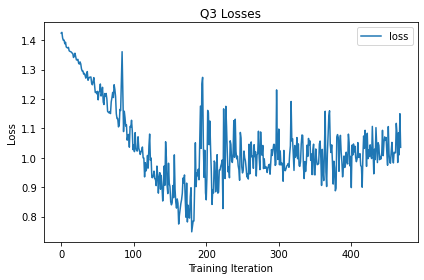

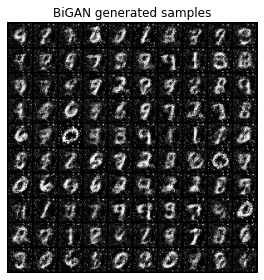

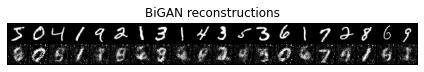

epoch:  1


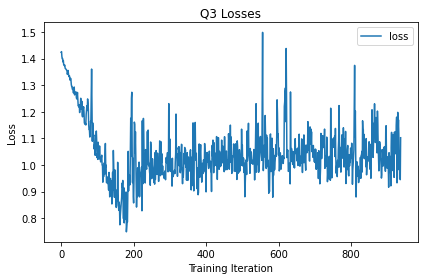

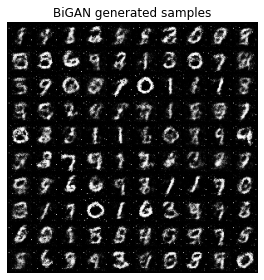

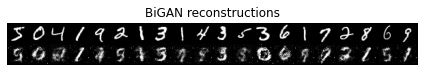

epoch:  2


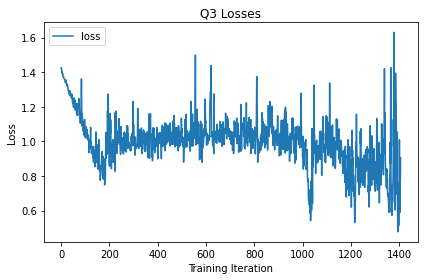

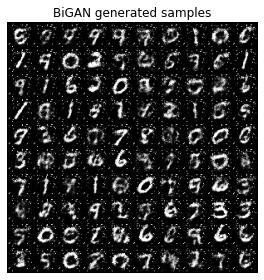

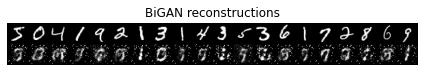

epoch:  3


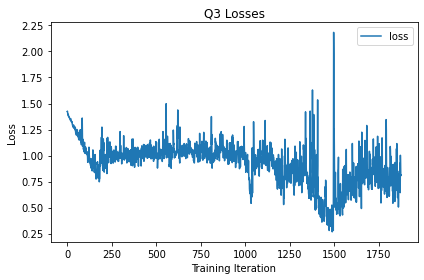

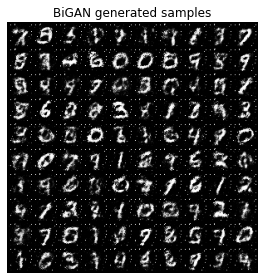

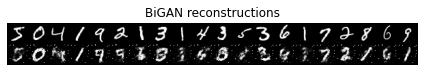

epoch:  4


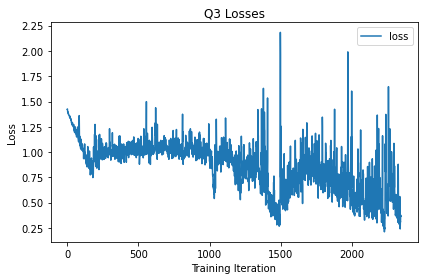

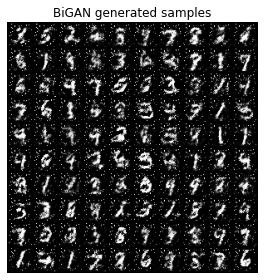

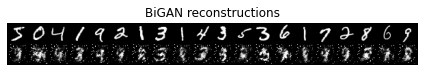

epoch:  5


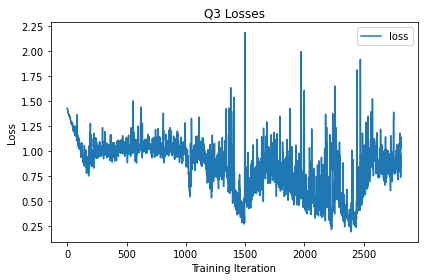

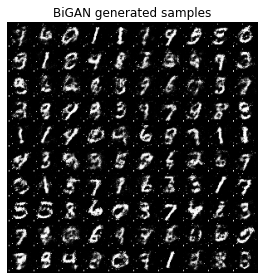

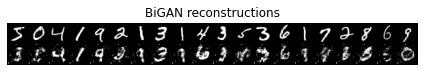

epoch:  6


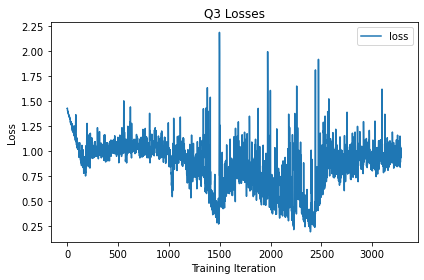

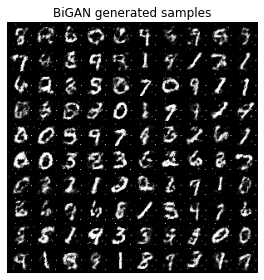

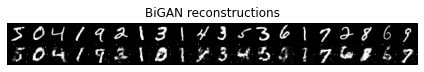

epoch:  7


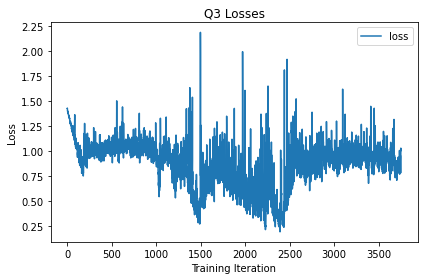

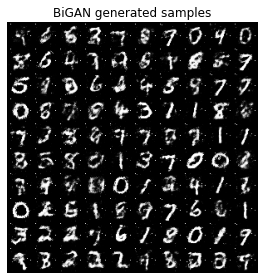

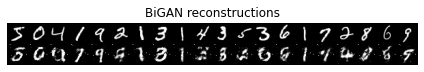

epoch:  8


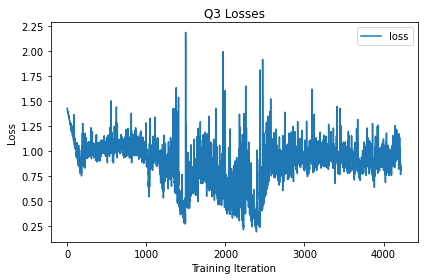

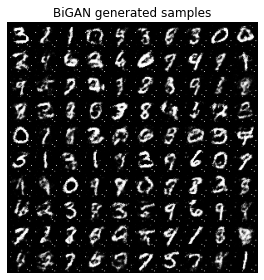

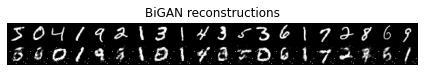

epoch:  9


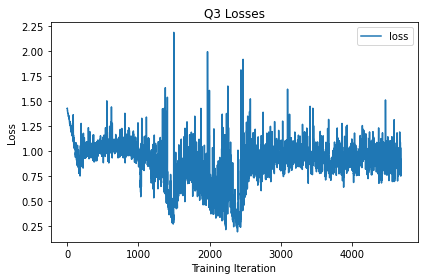

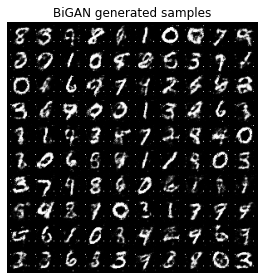

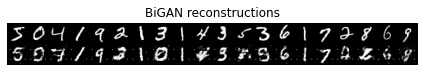

epoch:  10


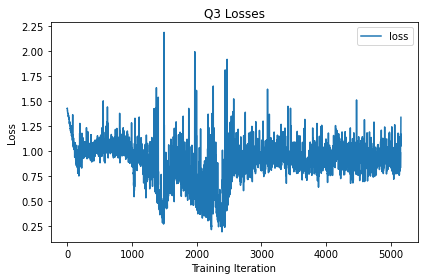

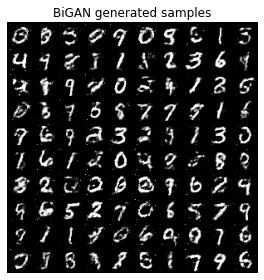

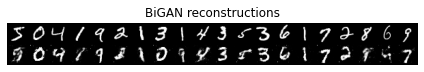

epoch:  11


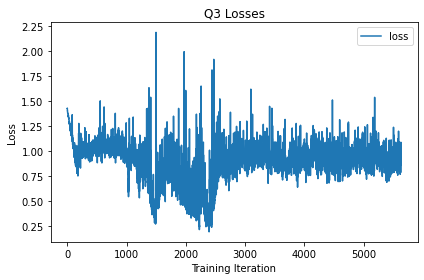

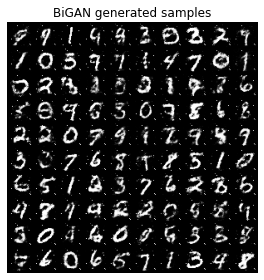

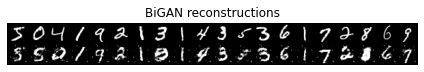

epoch:  12


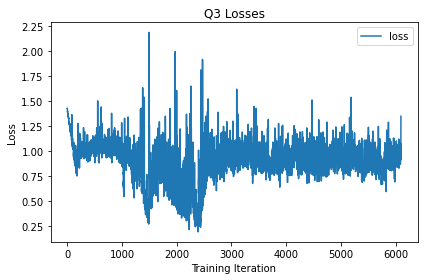

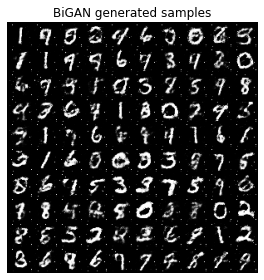

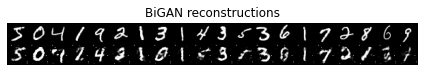

epoch:  13


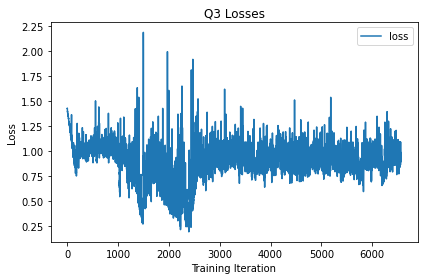

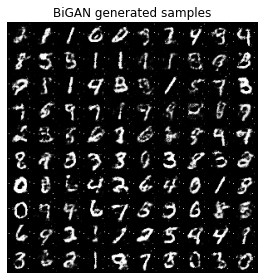

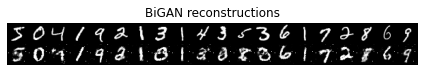

epoch:  14


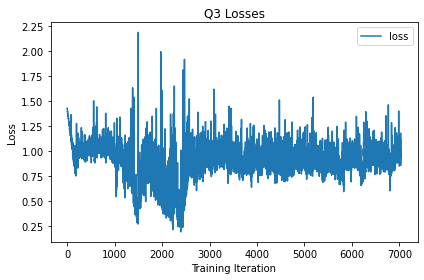

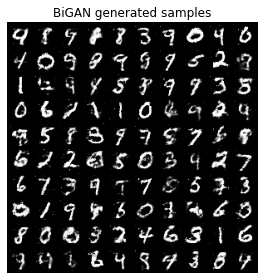

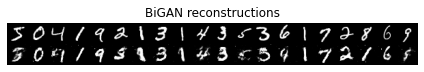

epoch:  15


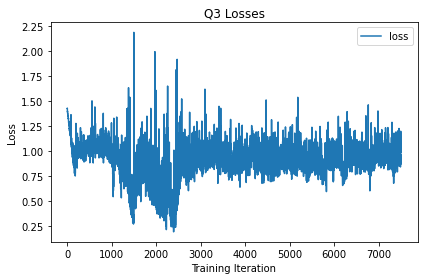

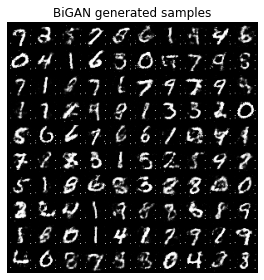

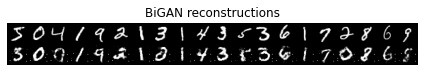

epoch:  16


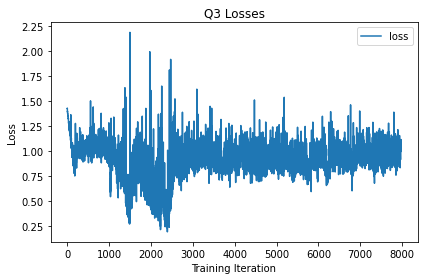

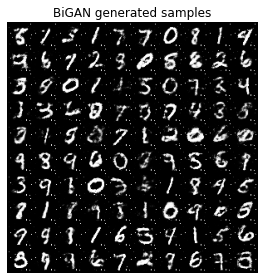

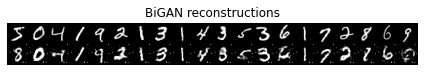

epoch:  17


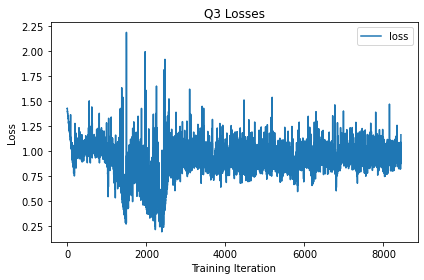

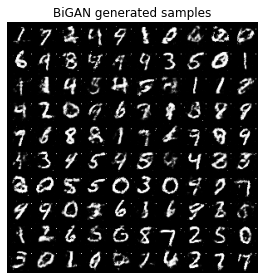

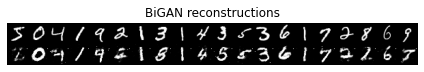

epoch:  18


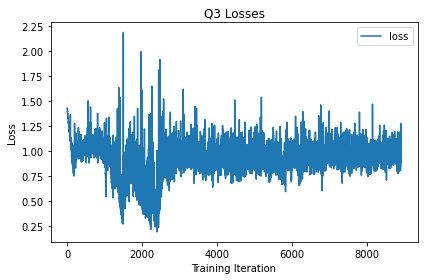

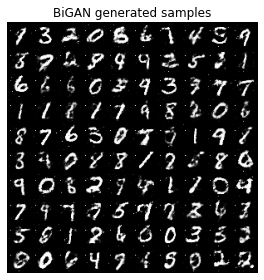

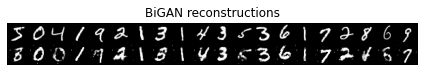

epoch:  19


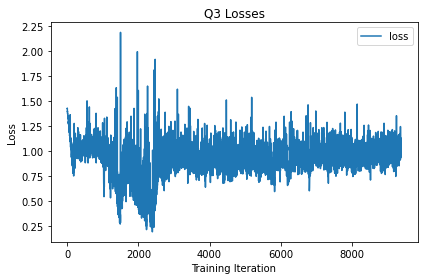

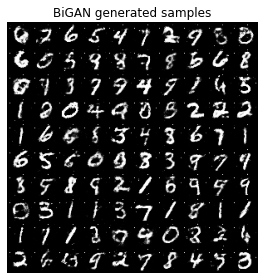

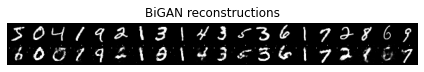

epoch:  20


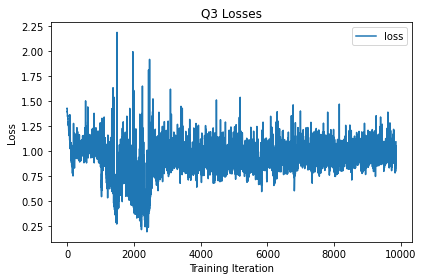

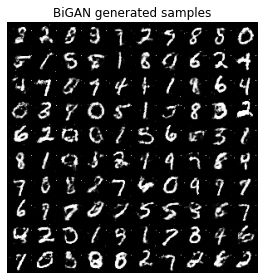

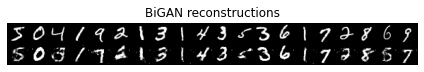

epoch:  21


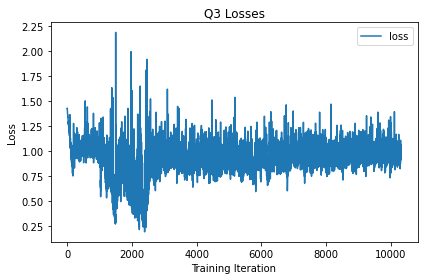

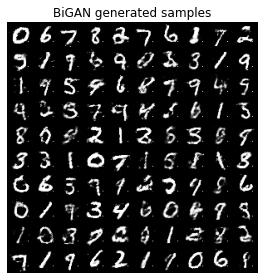

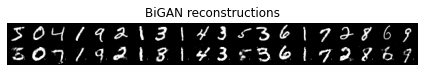

epoch:  22


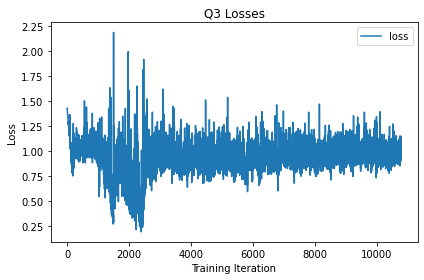

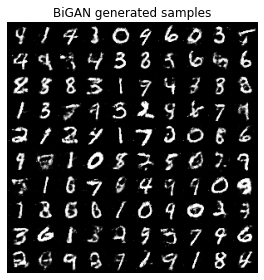

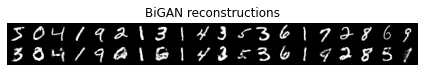

epoch:  23


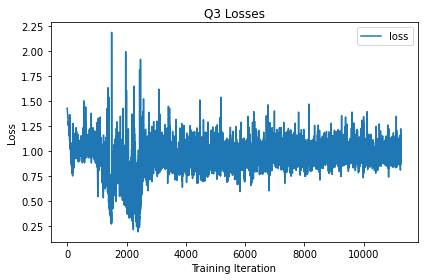

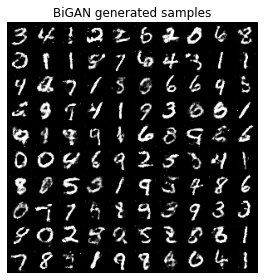

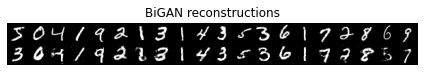

epoch:  24


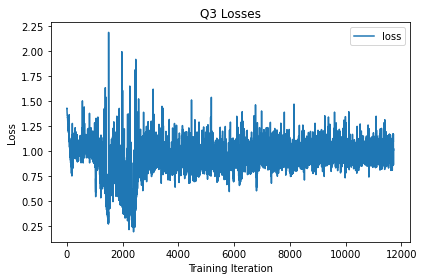

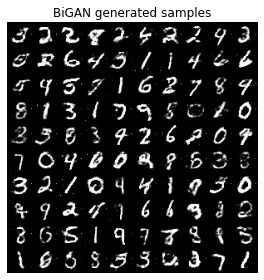

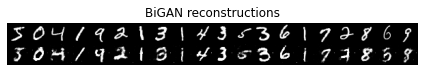

epoch:  25


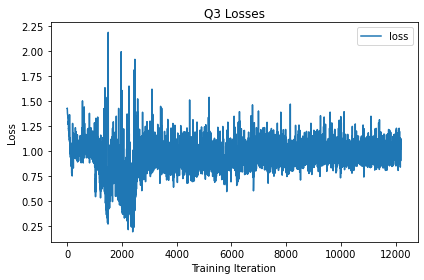

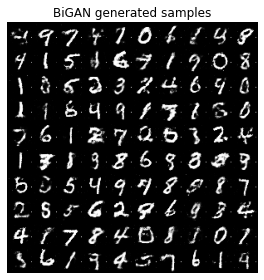

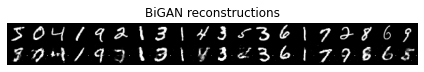

epoch:  26


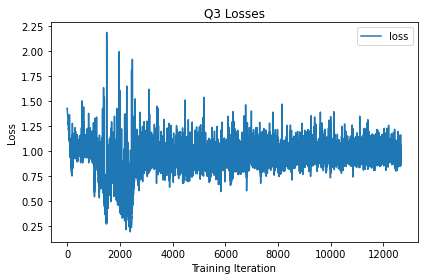

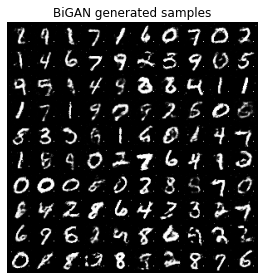

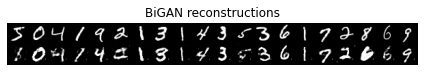

epoch:  27


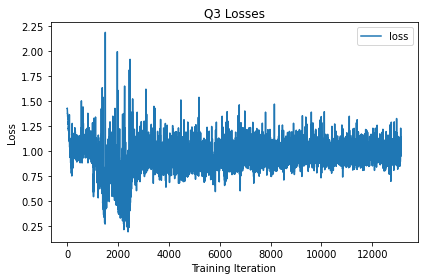

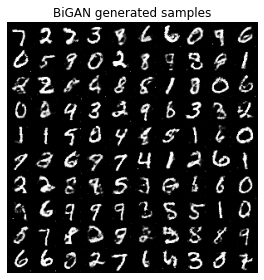

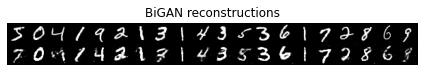

epoch:  28


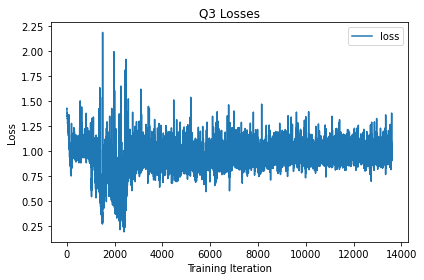

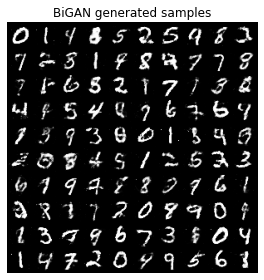

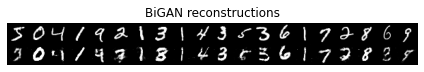

epoch:  29


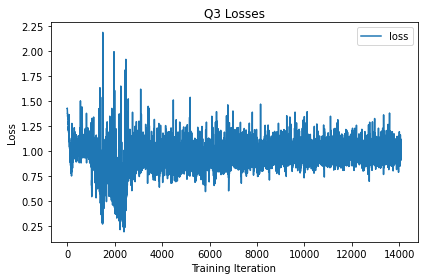

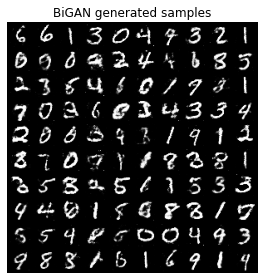

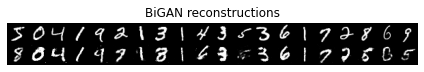

epoch:  30


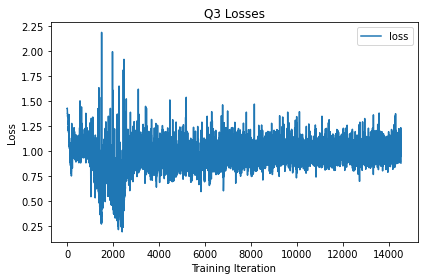

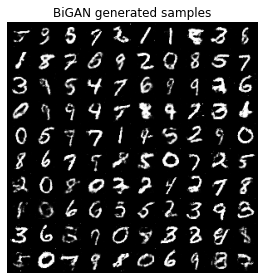

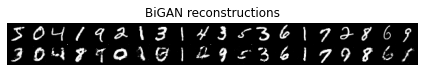

epoch:  31


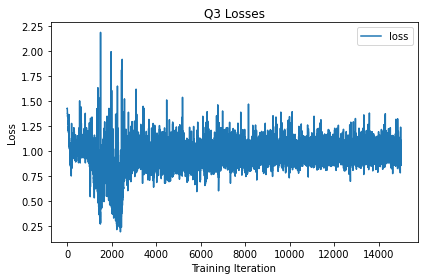

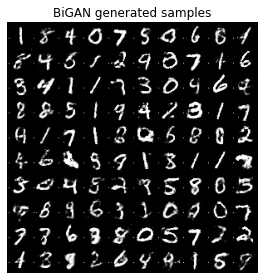

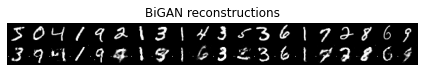

epoch:  32


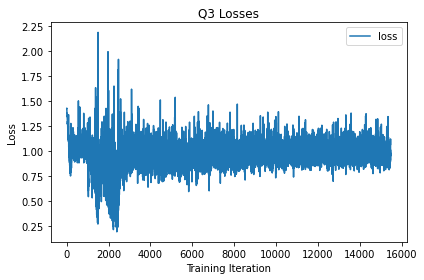

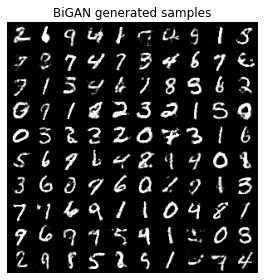

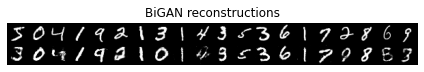

epoch:  33


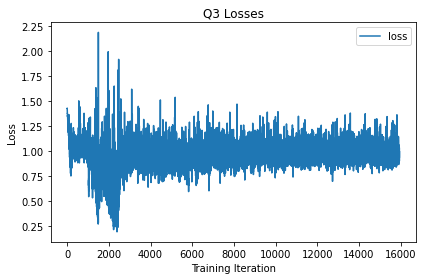

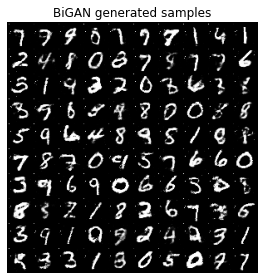

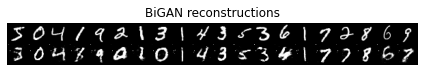

epoch:  34


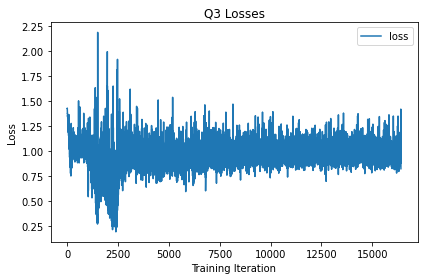

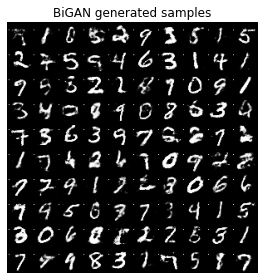

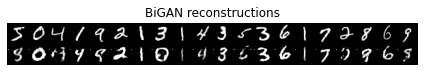

epoch:  35


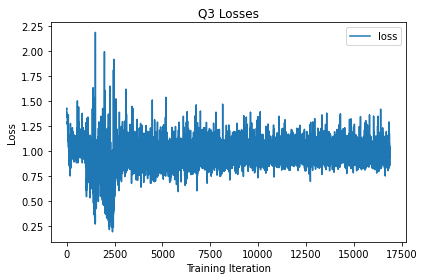

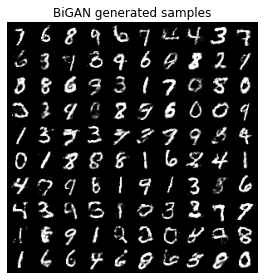

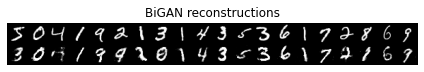

epoch:  36


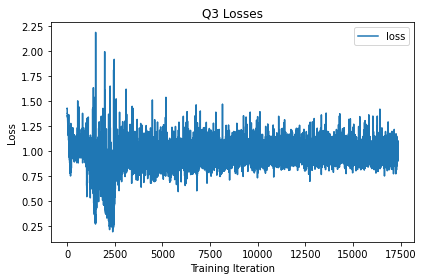

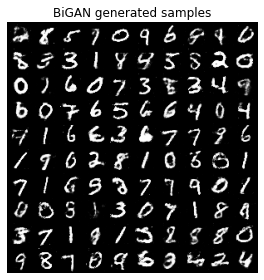

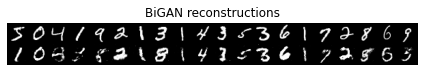

epoch:  37


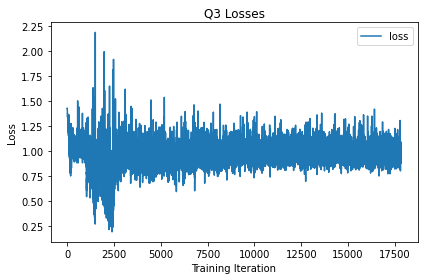

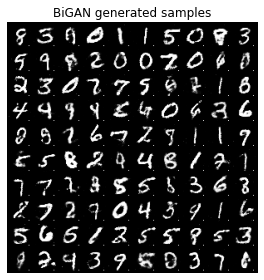

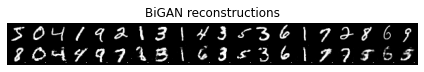

epoch:  38


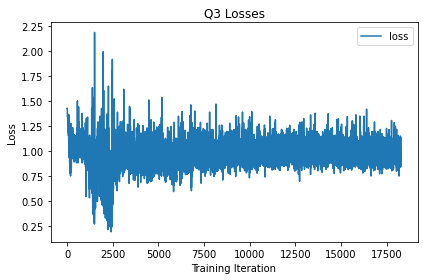

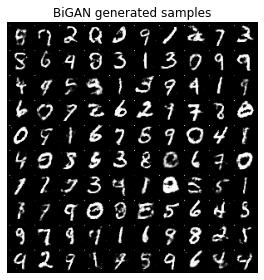

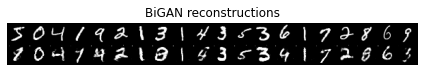

epoch:  39


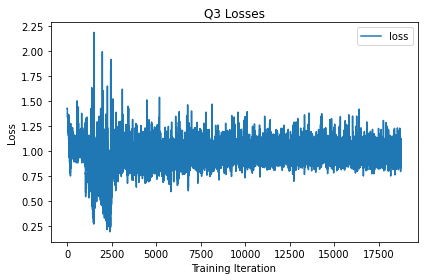

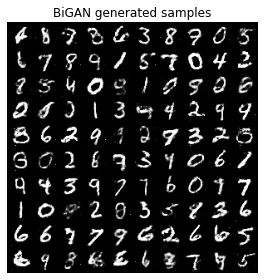

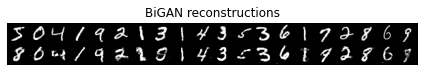

epoch:  40


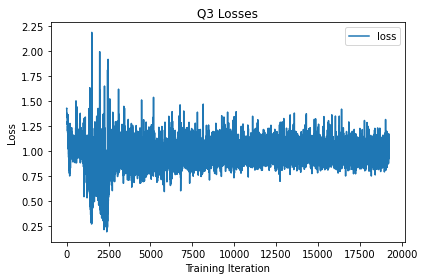

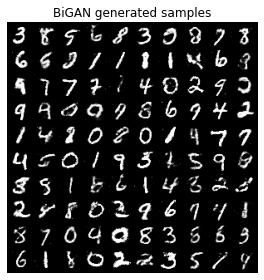

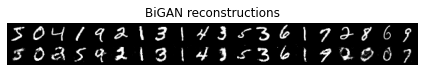

epoch:  41


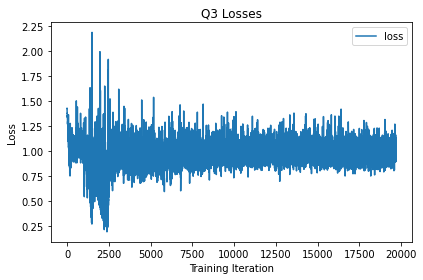

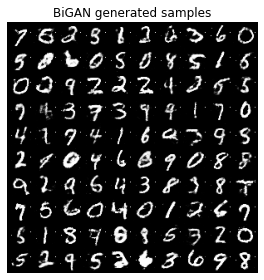

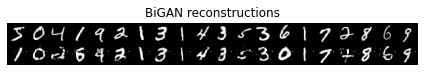

epoch:  42


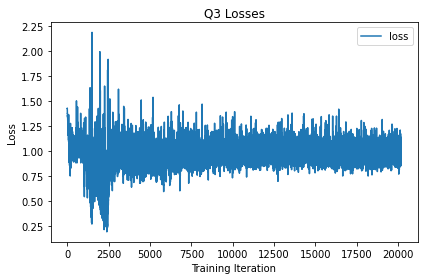

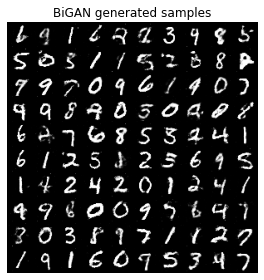

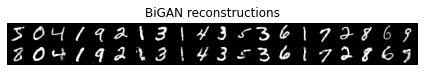

epoch:  43


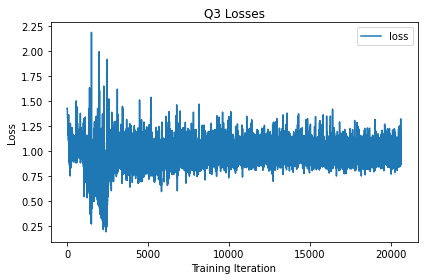

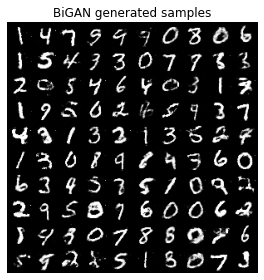

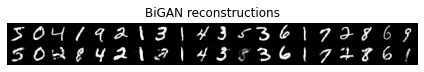

epoch:  44


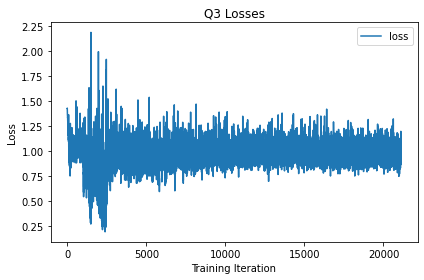

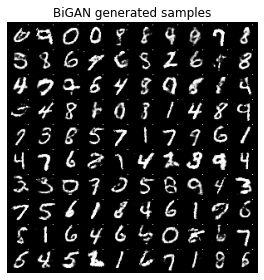

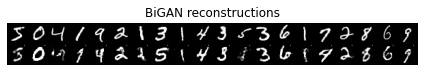

epoch:  45


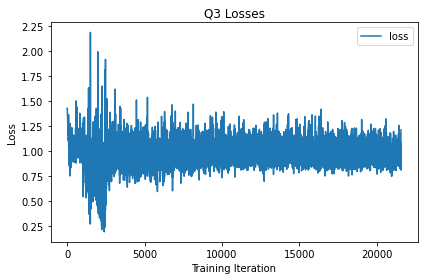

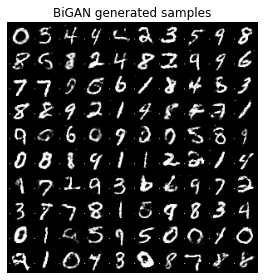

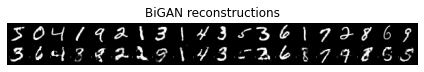

epoch:  46


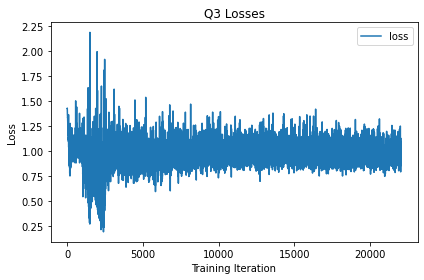

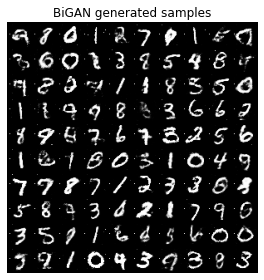

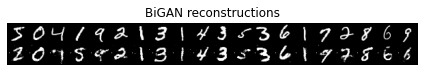

epoch:  47


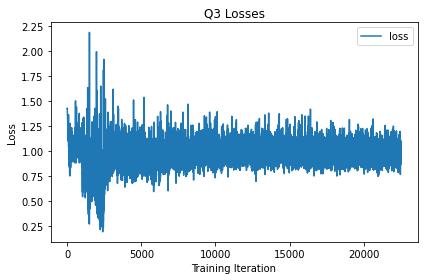

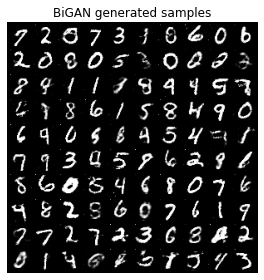

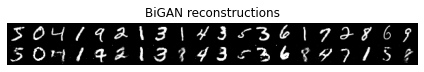

epoch:  48


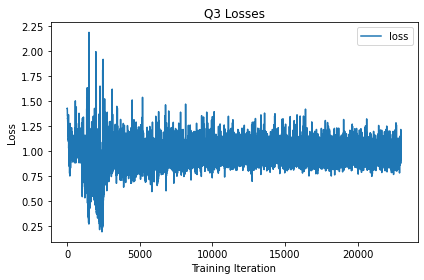

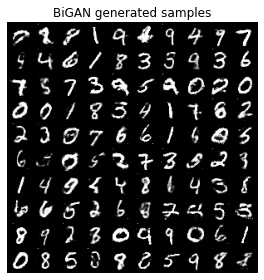

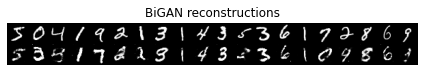

epoch:  49


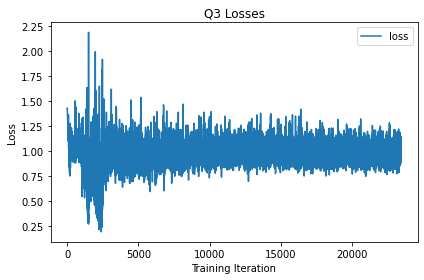

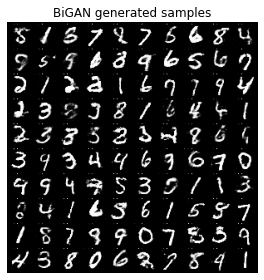

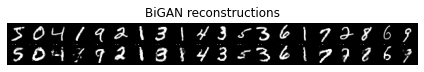

epoch:  50


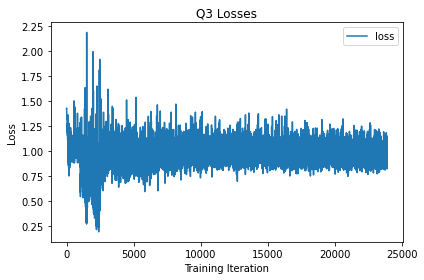

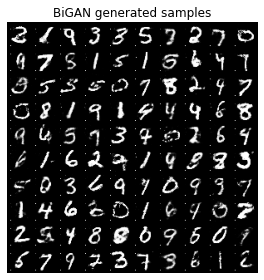

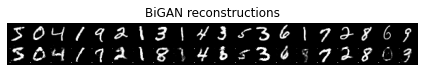

epoch:  51


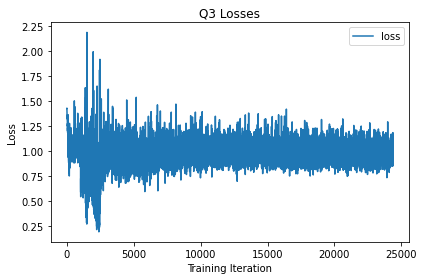

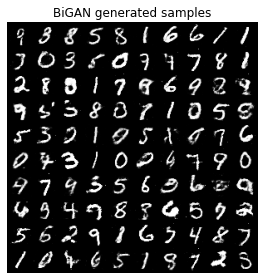

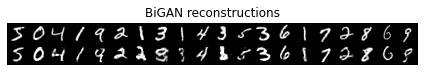

epoch:  52


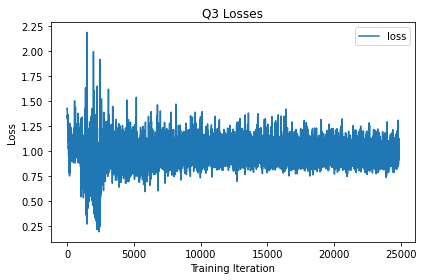

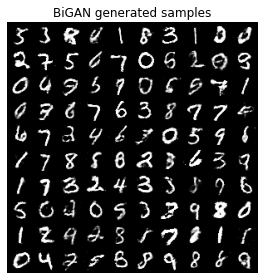

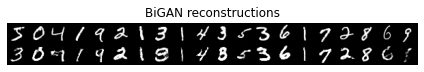

epoch:  53


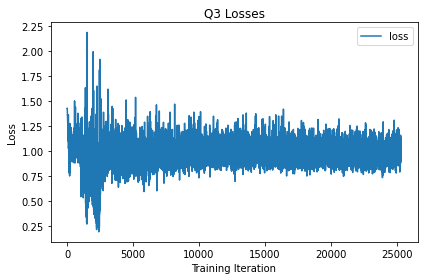

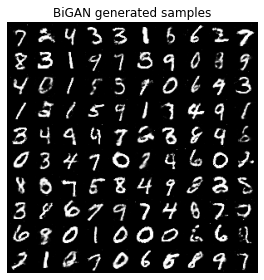

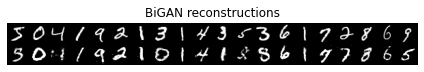

epoch:  54


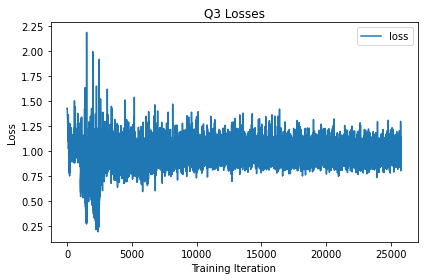

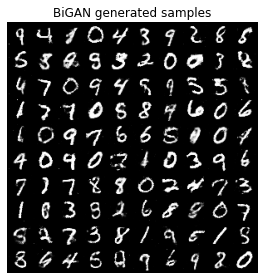

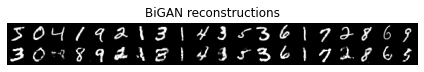

epoch:  55


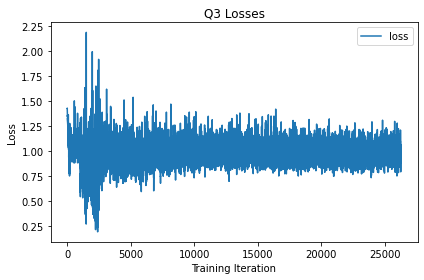

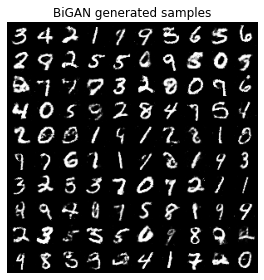

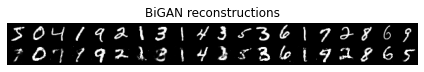

epoch:  56


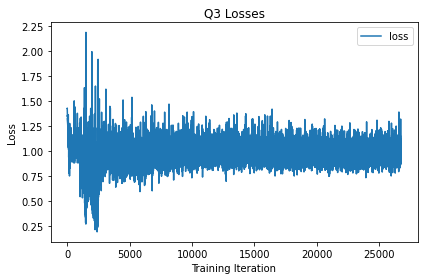

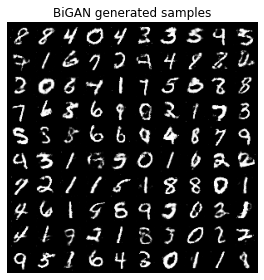

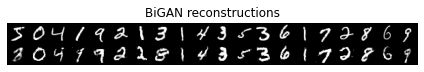

epoch:  57


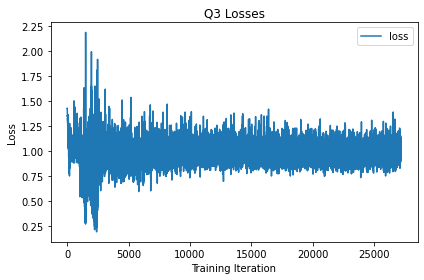

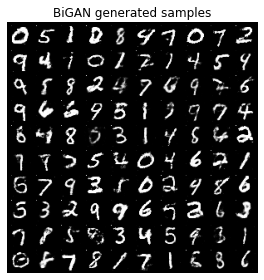

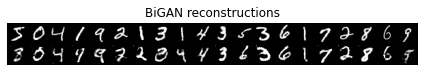

epoch:  58


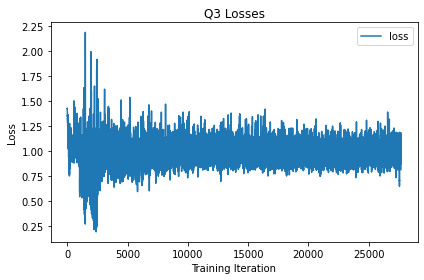

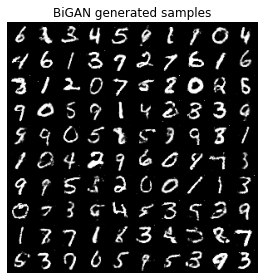

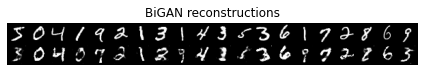

epoch:  59


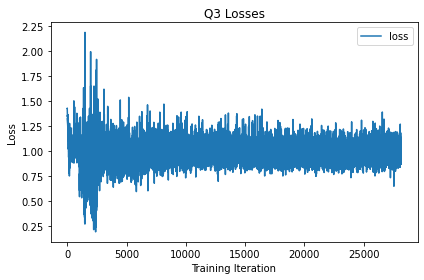

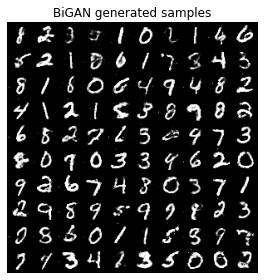

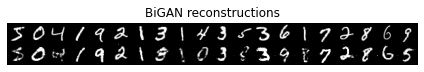

epoch:  60


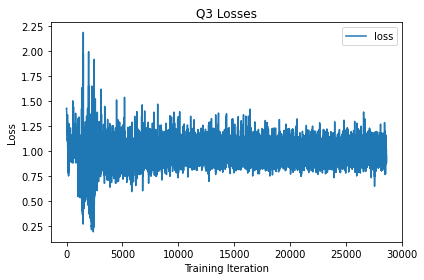

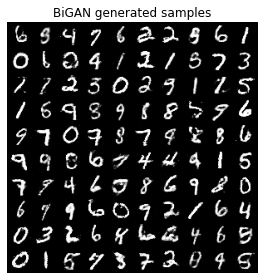

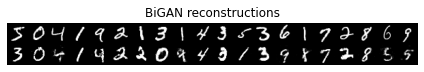

epoch:  61


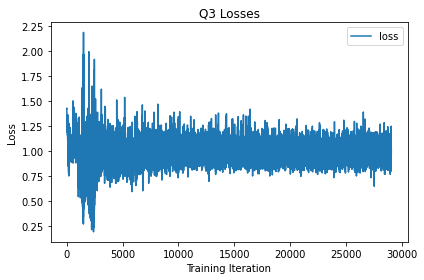

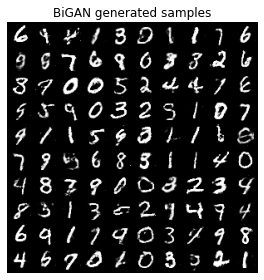

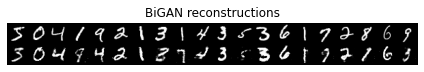

epoch:  62


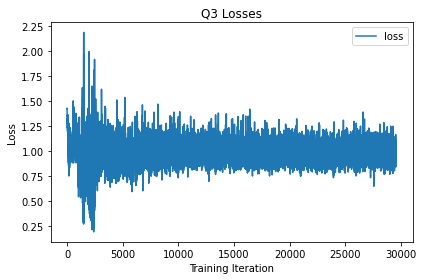

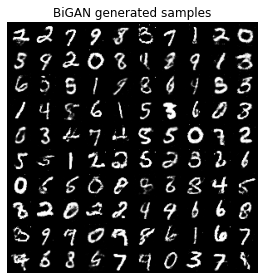

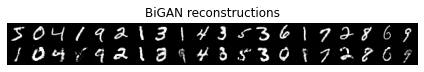

epoch:  63


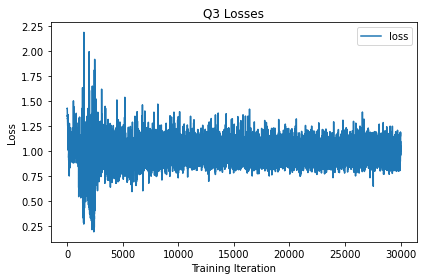

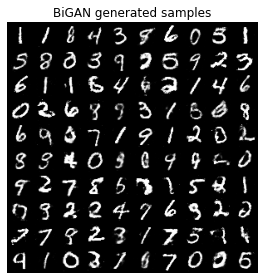

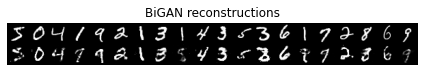

epoch:  64


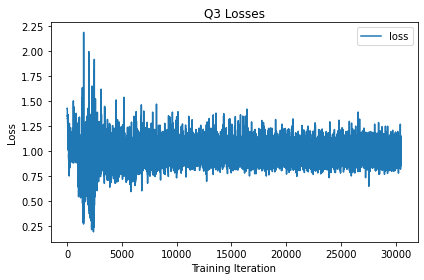

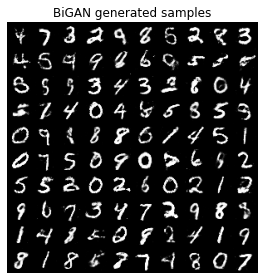

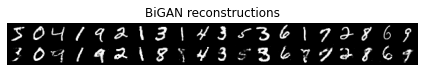

epoch:  65


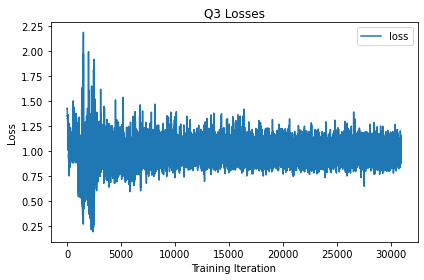

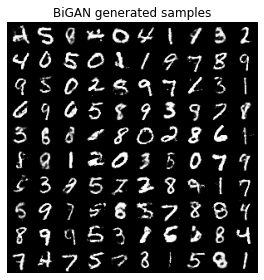

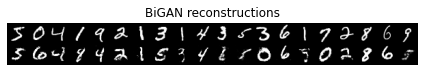

epoch:  66


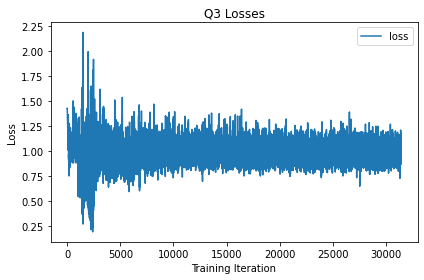

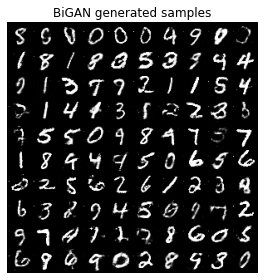

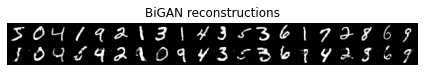

epoch:  67


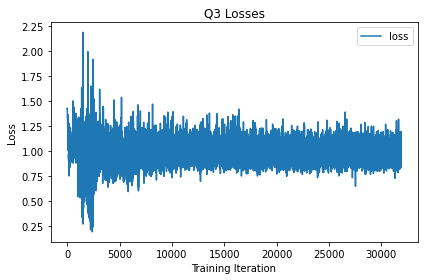

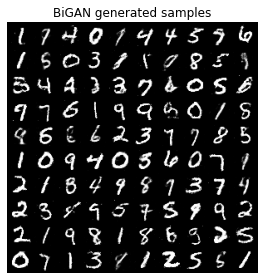

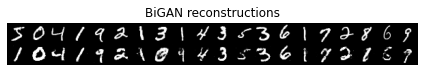

epoch:  68


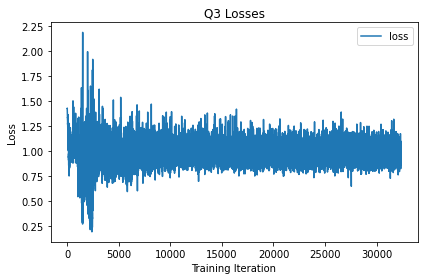

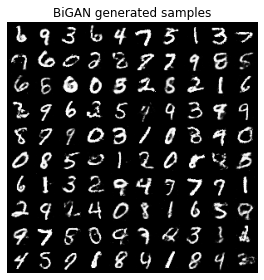

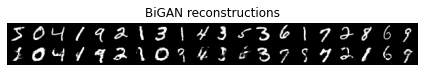

epoch:  69


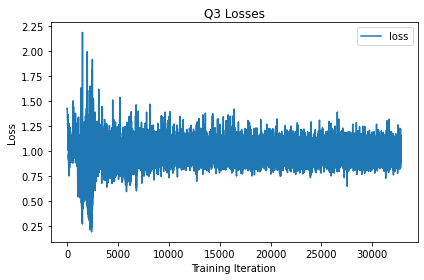

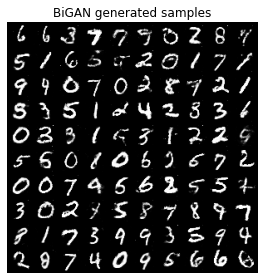

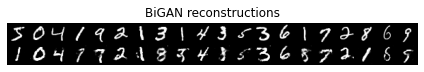

epoch:  70


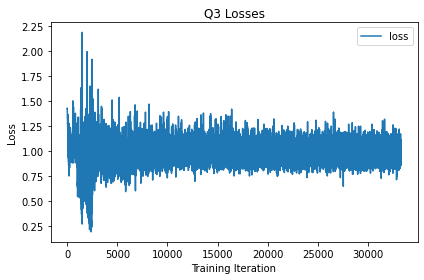

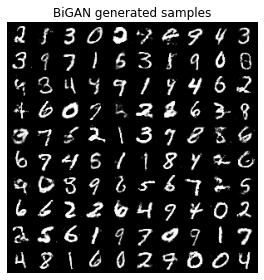

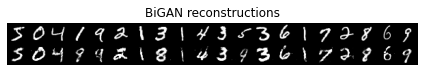

epoch:  71


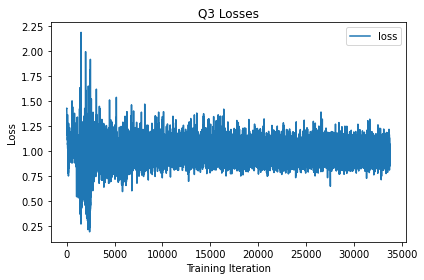

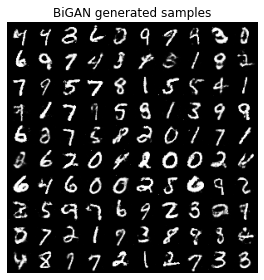

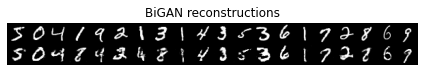

epoch:  72


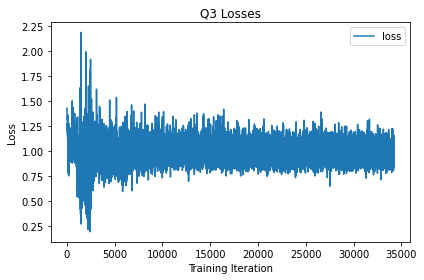

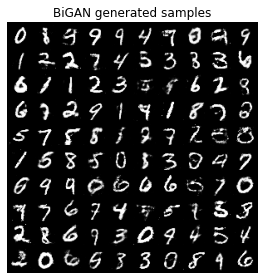

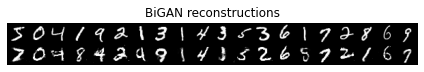

epoch:  73


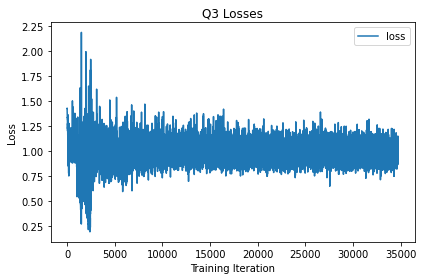

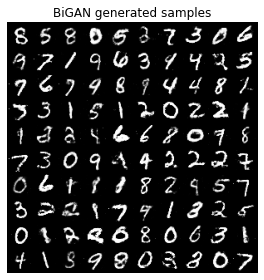

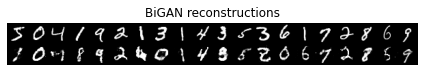

epoch:  74


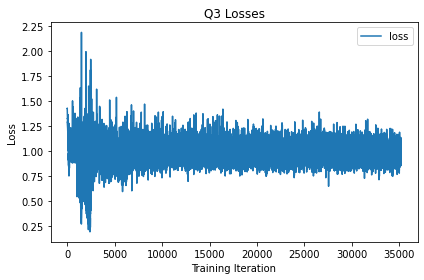

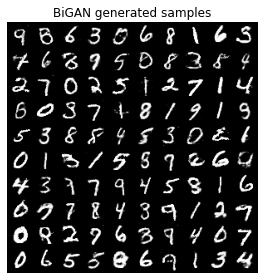

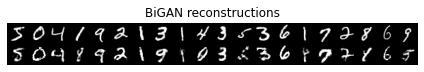

epoch:  75


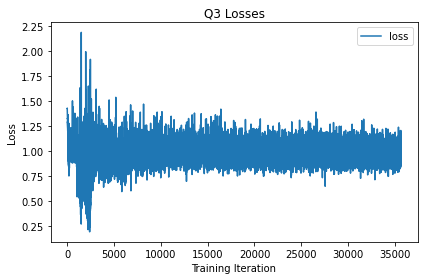

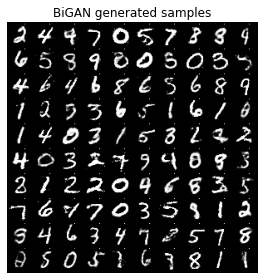

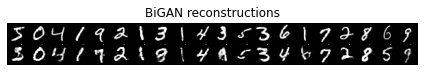

epoch:  76


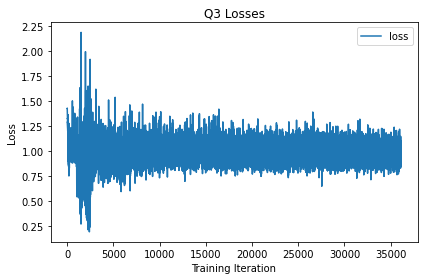

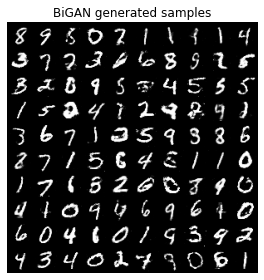

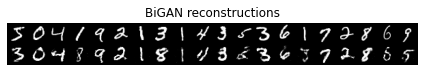

epoch:  77


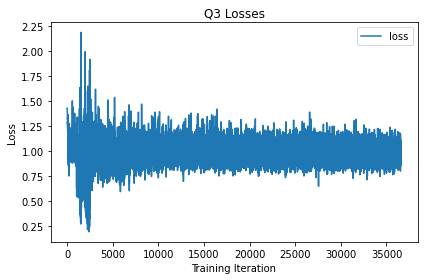

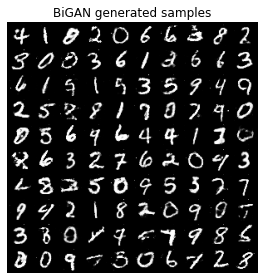

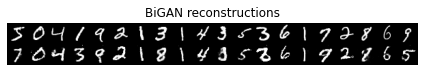

epoch:  78


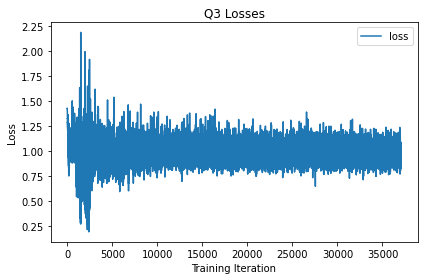

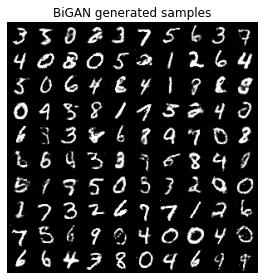

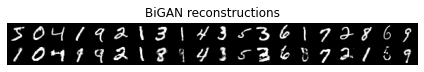

epoch:  79


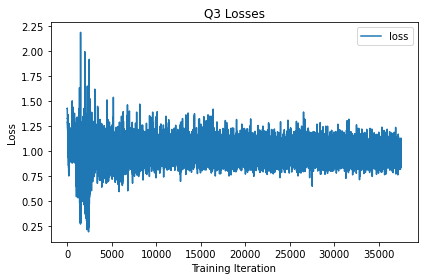

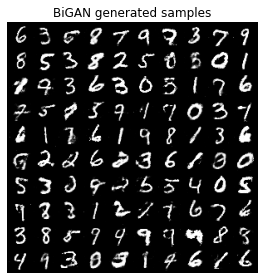

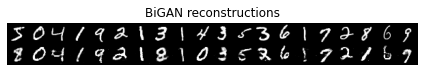

epoch:  80


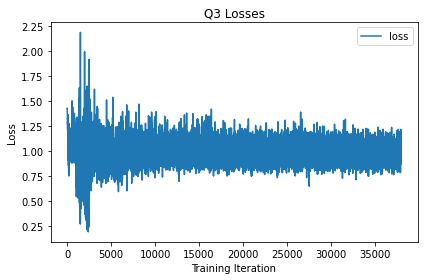

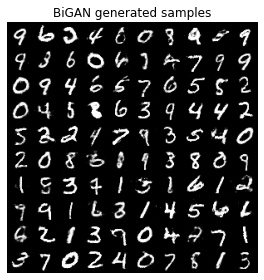

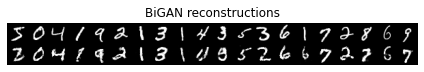

epoch:  81


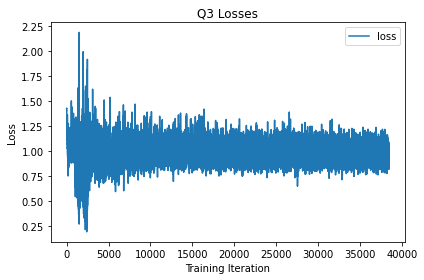

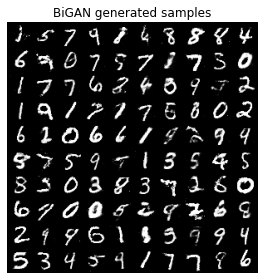

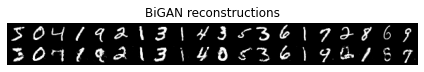

epoch:  82


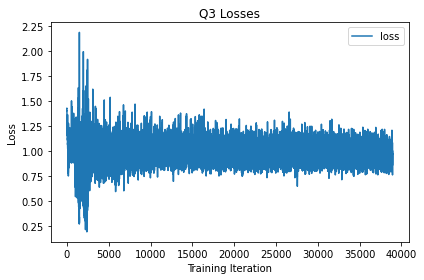

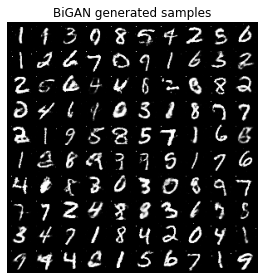

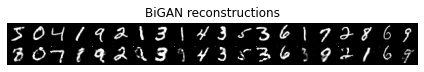

epoch:  83


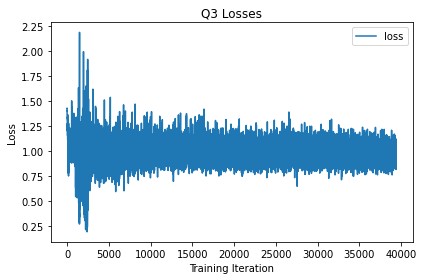

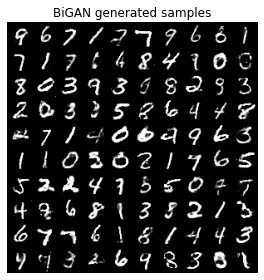

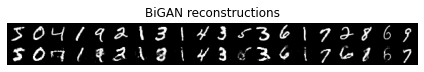

epoch:  84


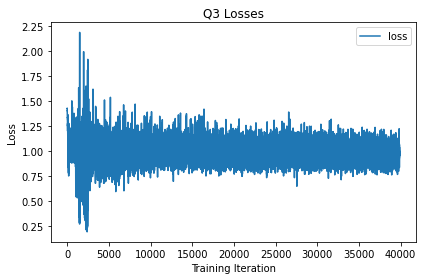

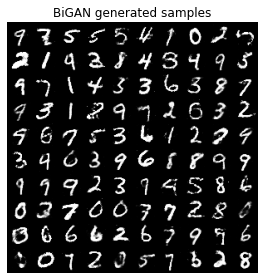

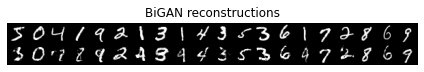

epoch:  85


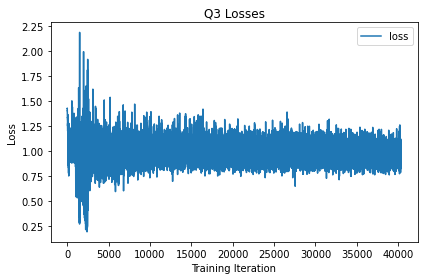

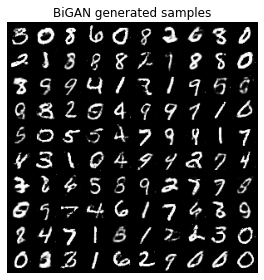

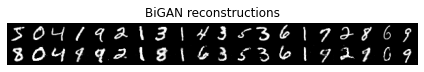

epoch:  86


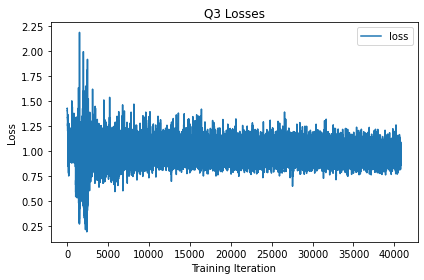

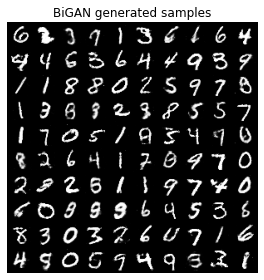

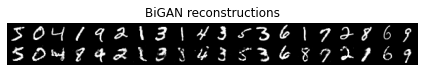

epoch:  87


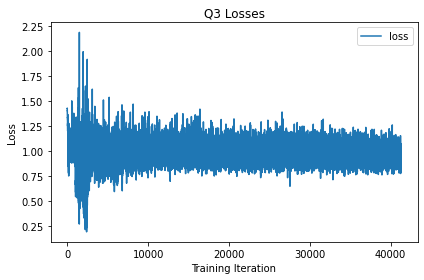

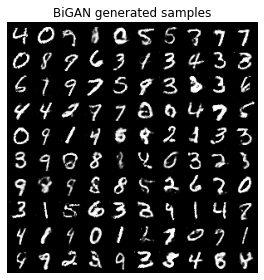

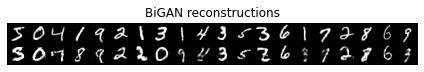

epoch:  88


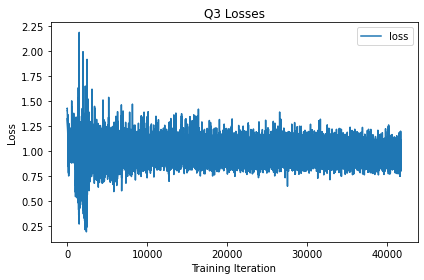

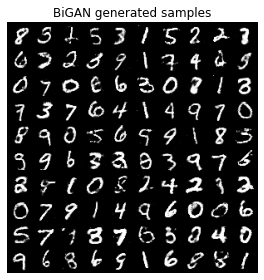

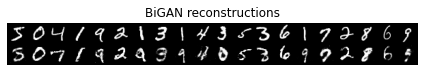

epoch:  89


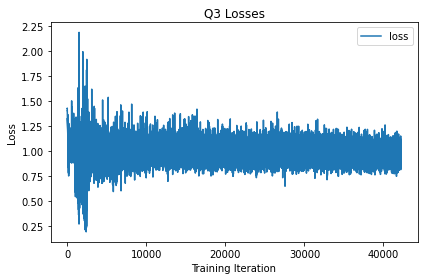

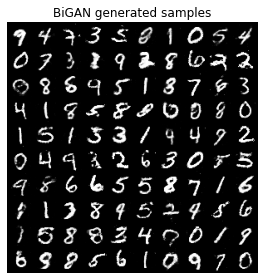

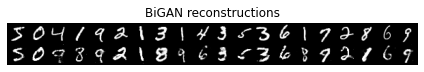

epoch:  90


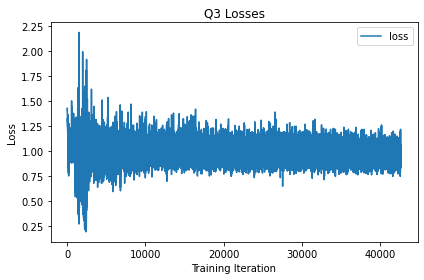

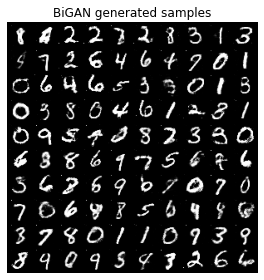

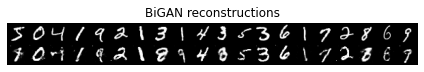

epoch:  91


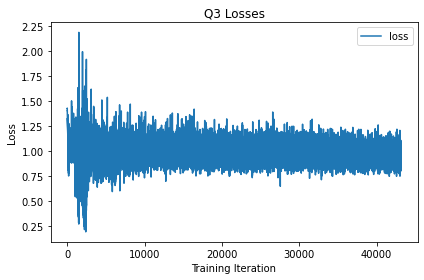

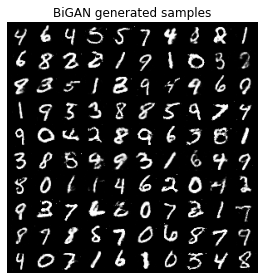

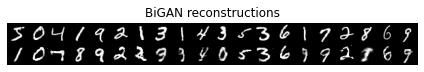

epoch:  92


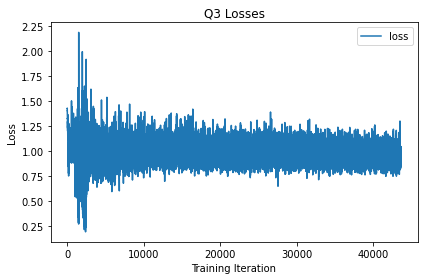

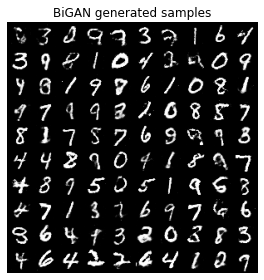

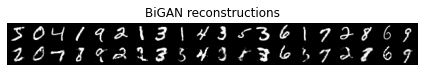

epoch:  93


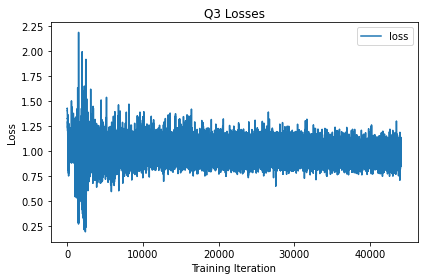

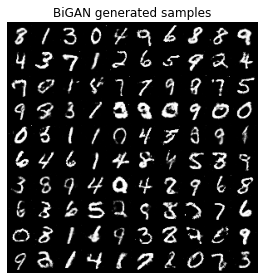

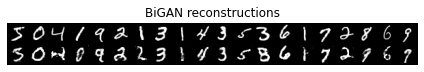

epoch:  94


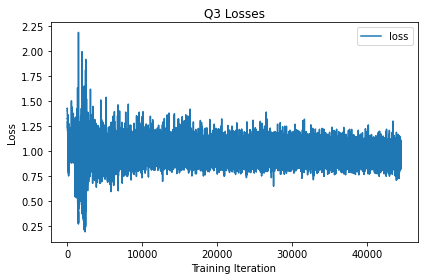

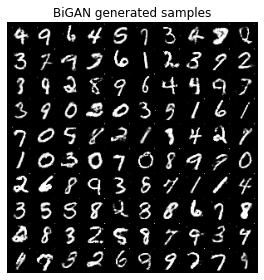

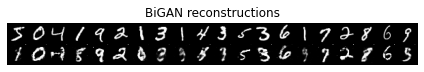

epoch:  95


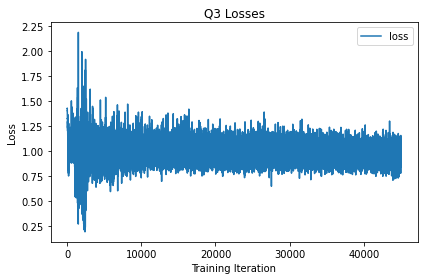

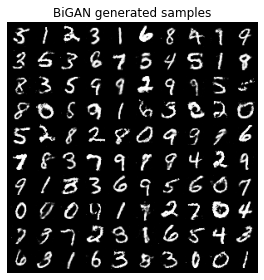

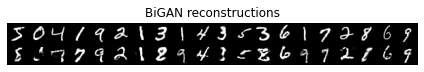

epoch:  96


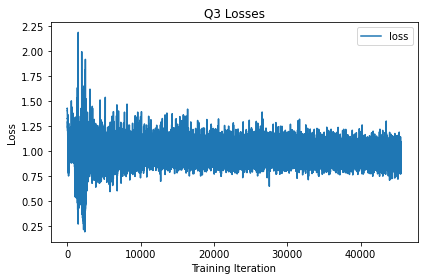

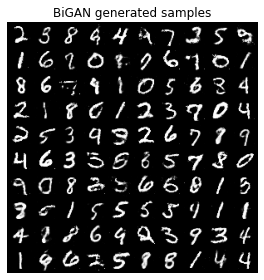

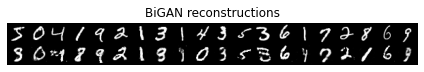

epoch:  97


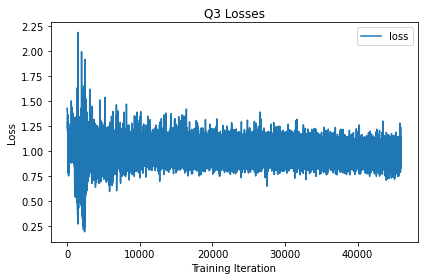

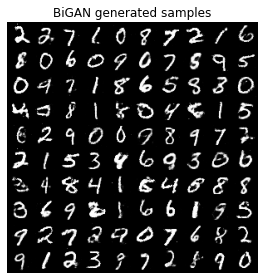

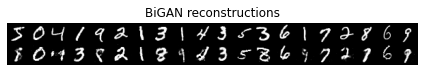

epoch:  98


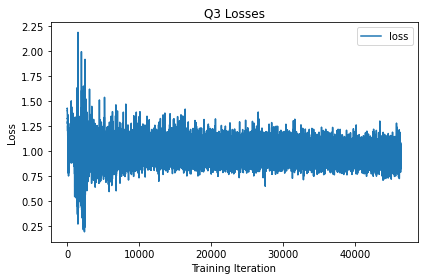

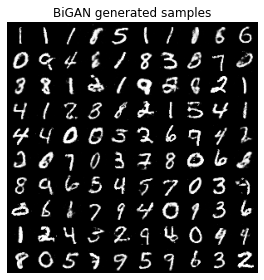

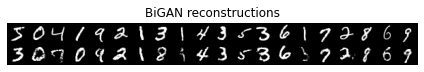

epoch:  99


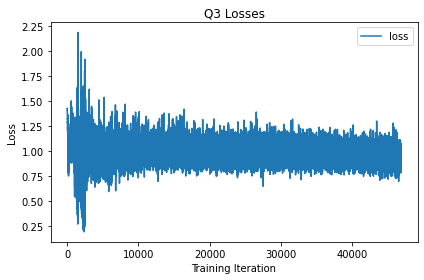

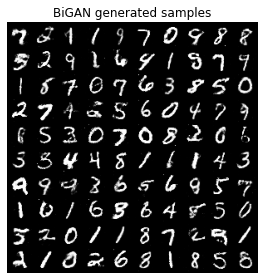

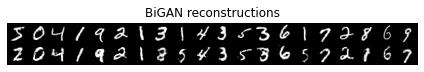

TypeError: ignored

In [ ]:
q3_save_results(q3)

epoch:  0
BiGAN final linear classification loss: 2.275214195251465
Random encoder linear classification loss: 2.3012478351593018
BiGAN final accuracy: 0.14349287974683544
Random encoder accuracy: 0.08217958860759493


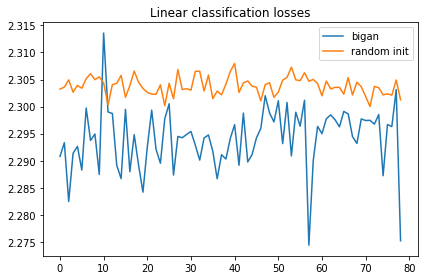

epoch:  1
BiGAN final linear classification loss: 2.268219232559204
Random encoder linear classification loss: 2.300466299057007
BiGAN final accuracy: 0.1753362341772152
Random encoder accuracy: 0.0902887658227848


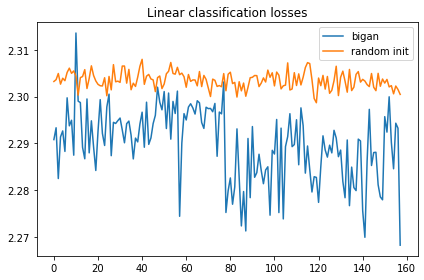

epoch:  2
BiGAN final linear classification loss: 2.1942496299743652
Random encoder linear classification loss: 2.3017666339874268
BiGAN final accuracy: 0.21172863924050633
Random encoder accuracy: 0.09384889240506329


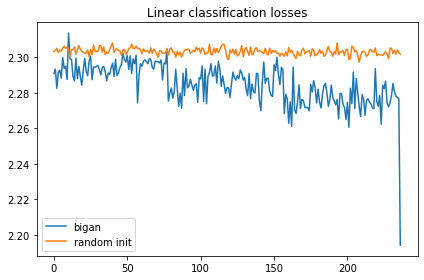

epoch:  3
BiGAN final linear classification loss: 2.2781944274902344
Random encoder linear classification loss: 2.3057103157043457
BiGAN final accuracy: 0.24258306962025317
Random encoder accuracy: 0.09899129746835443


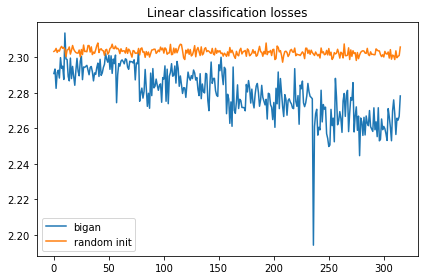

epoch:  4
BiGAN final linear classification loss: 2.279231071472168
Random encoder linear classification loss: 2.2995998859405518
BiGAN final accuracy: 0.2701740506329114
Random encoder accuracy: 0.10660601265822785


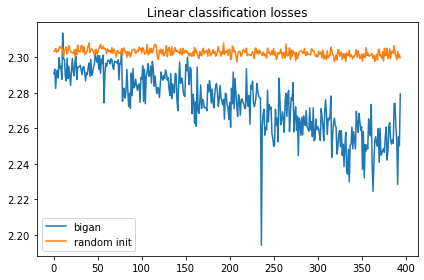

epoch:  5
BiGAN final linear classification loss: 2.243704080581665
Random encoder linear classification loss: 2.3065178394317627
BiGAN final accuracy: 0.29222705696202533
Random encoder accuracy: 0.1071004746835443


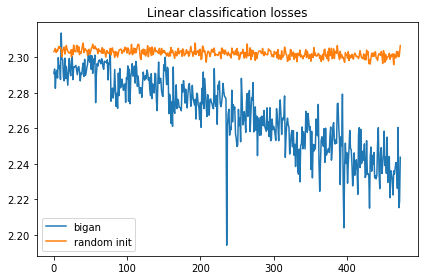

epoch:  6
BiGAN final linear classification loss: 2.2778115272521973
Random encoder linear classification loss: 2.30045223236084
BiGAN final accuracy: 0.31170886075949367
Random encoder accuracy: 0.11362737341772151


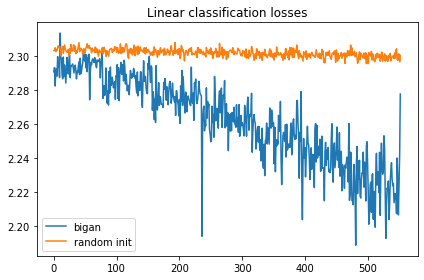

epoch:  7
BiGAN final linear classification loss: 2.1977224349975586
Random encoder linear classification loss: 2.3044698238372803
BiGAN final accuracy: 0.33672863924050633
Random encoder accuracy: 0.11708860759493671


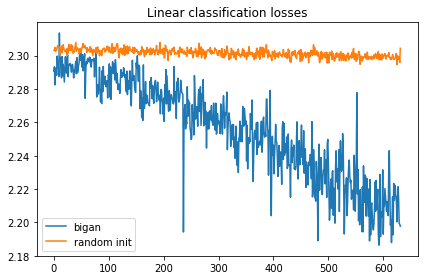

epoch:  8
BiGAN final linear classification loss: 2.2081539630889893
Random encoder linear classification loss: 2.2935497760772705
BiGAN final accuracy: 0.35739715189873417
Random encoder accuracy: 0.12895569620253164


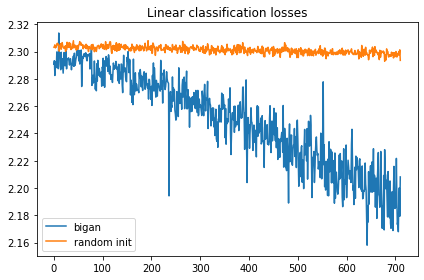

epoch:  9
BiGAN final linear classification loss: 2.1487839221954346
Random encoder linear classification loss: 2.300816059112549
BiGAN final accuracy: 0.3792523734177215
Random encoder accuracy: 0.1361748417721519


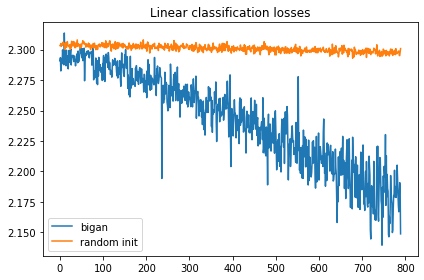

epoch:  10
BiGAN final linear classification loss: 2.1961026191711426
Random encoder linear classification loss: 2.284424304962158
BiGAN final accuracy: 0.3995253164556962
Random encoder accuracy: 0.1461629746835443


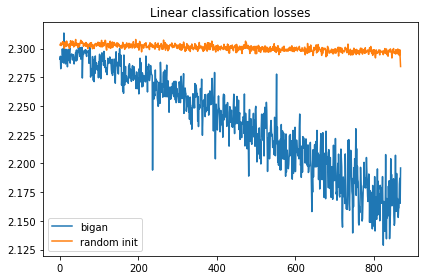

epoch:  11
BiGAN final linear classification loss: 2.1818647384643555
Random encoder linear classification loss: 2.301682233810425
BiGAN final accuracy: 0.4143591772151899
Random encoder accuracy: 0.1451740506329114


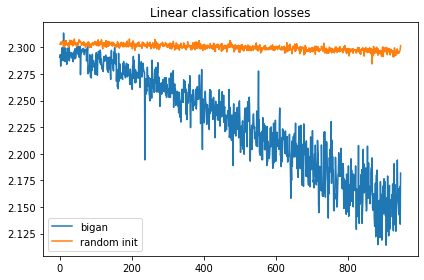

epoch:  12
BiGAN final linear classification loss: 2.131387710571289
Random encoder linear classification loss: 2.3000457286834717
BiGAN final accuracy: 0.4299841772151899
Random encoder accuracy: 0.15496439873417722


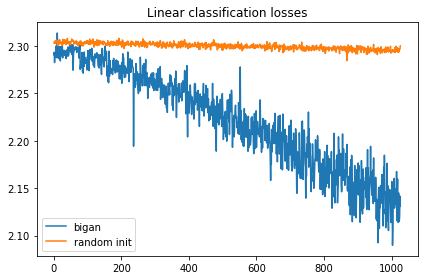

epoch:  13
BiGAN final linear classification loss: 2.182021141052246
Random encoder linear classification loss: 2.292426586151123
BiGAN final accuracy: 0.4396756329113924
Random encoder accuracy: 0.16594145569620253


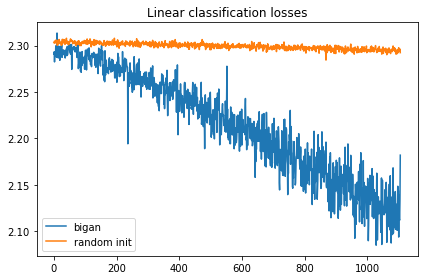

epoch:  14
BiGAN final linear classification loss: 2.200064182281494
Random encoder linear classification loss: 2.295811653137207
BiGAN final accuracy: 0.45569620253164556
Random encoder accuracy: 0.17454509493670886


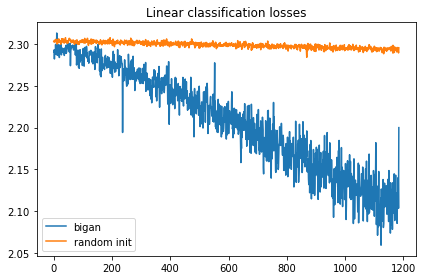

epoch:  15
BiGAN final linear classification loss: 2.0485525131225586
Random encoder linear classification loss: 2.2978553771972656
BiGAN final accuracy: 0.4700356012658228
Random encoder accuracy: 0.1854232594936709


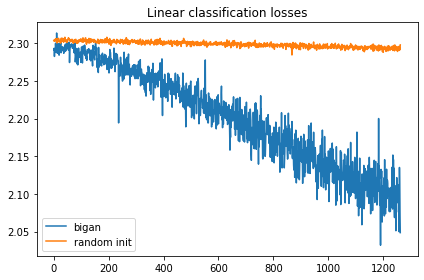

epoch:  16
BiGAN final linear classification loss: 2.1494343280792236
Random encoder linear classification loss: 2.299476146697998
BiGAN final accuracy: 0.48279272151898733
Random encoder accuracy: 0.19491693037974683


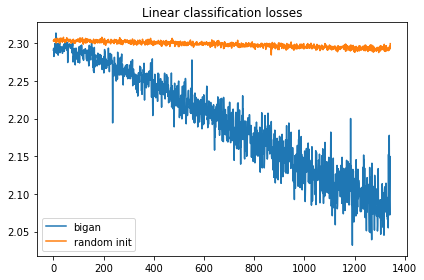

epoch:  17
BiGAN final linear classification loss: 2.078495740890503
Random encoder linear classification loss: 2.3022332191467285
BiGAN final accuracy: 0.49732990506329117
Random encoder accuracy: 0.2064873417721519


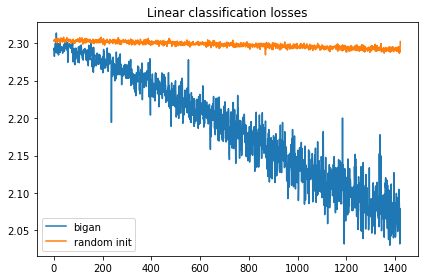

epoch:  18
BiGAN final linear classification loss: 2.111264944076538
Random encoder linear classification loss: 2.2773032188415527
BiGAN final accuracy: 0.5097903481012658
Random encoder accuracy: 0.21696993670886075


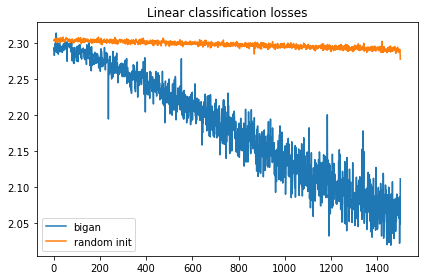

epoch:  19
BiGAN final linear classification loss: 2.1726269721984863
Random encoder linear classification loss: 2.2845304012298584
BiGAN final accuracy: 0.5202729430379747
Random encoder accuracy: 0.22596914556962025


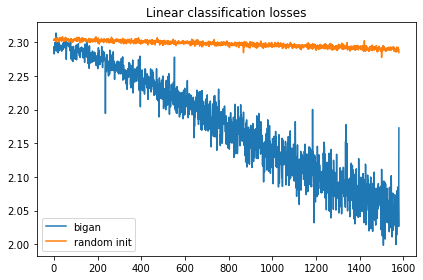

epoch:  20
BiGAN final linear classification loss: 2.0772366523742676
Random encoder linear classification loss: 2.290132761001587
BiGAN final accuracy: 0.535996835443038
Random encoder accuracy: 0.23615506329113925


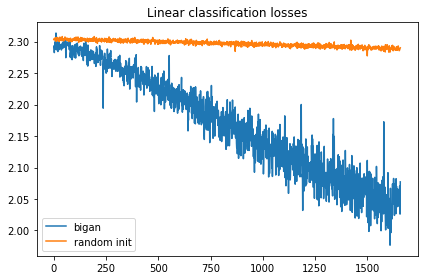

epoch:  21
BiGAN final linear classification loss: 2.077699661254883
Random encoder linear classification loss: 2.2697854042053223
BiGAN final accuracy: 0.5457871835443038
Random encoder accuracy: 0.24376977848101267


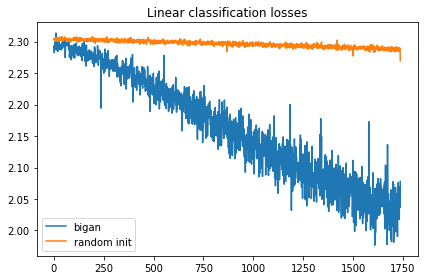

epoch:  22
BiGAN final linear classification loss: 2.1551737785339355
Random encoder linear classification loss: 2.27247953414917
BiGAN final accuracy: 0.5527096518987342
Random encoder accuracy: 0.2589003164556962


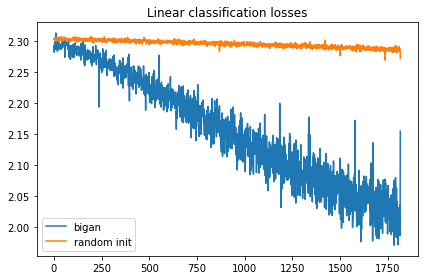

epoch:  23
BiGAN final linear classification loss: 2.030702829360962
Random encoder linear classification loss: 2.297780990600586
BiGAN final accuracy: 0.565565664556962
Random encoder accuracy: 0.2595925632911392


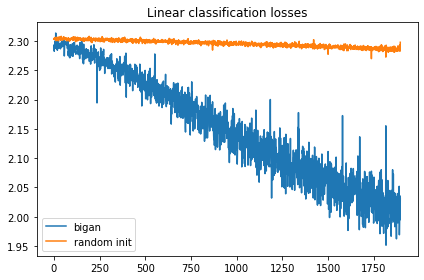

epoch:  24
BiGAN final linear classification loss: 2.0799639225006104
Random encoder linear classification loss: 2.2839348316192627
BiGAN final accuracy: 0.5725870253164557
Random encoder accuracy: 0.27076740506329117


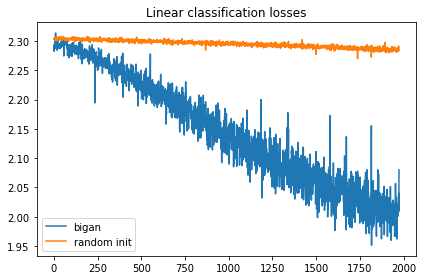

epoch:  25
BiGAN final linear classification loss: 2.1505520343780518
Random encoder linear classification loss: 2.2829208374023438
BiGAN final accuracy: 0.5825751582278481
Random encoder accuracy: 0.28105221518987344


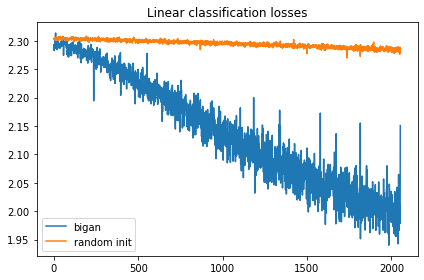

epoch:  26
BiGAN final linear classification loss: 1.9173287153244019
Random encoder linear classification loss: 2.2755513191223145
BiGAN final accuracy: 0.5915743670886076
Random encoder accuracy: 0.293809335443038


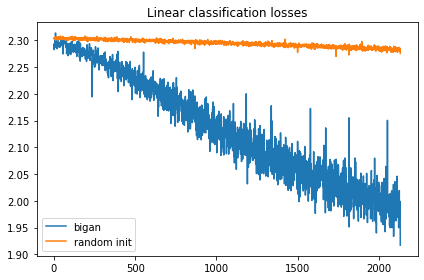

epoch:  27
BiGAN final linear classification loss: 1.9725341796875
Random encoder linear classification loss: 2.2738494873046875
BiGAN final accuracy: 0.6067049050632911
Random encoder accuracy: 0.30092958860759494


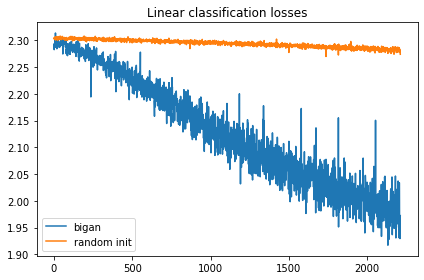

epoch:  28
BiGAN final linear classification loss: 2.0707273483276367
Random encoder linear classification loss: 2.289785385131836
BiGAN final accuracy: 0.6130340189873418
Random encoder accuracy: 0.30656645569620256


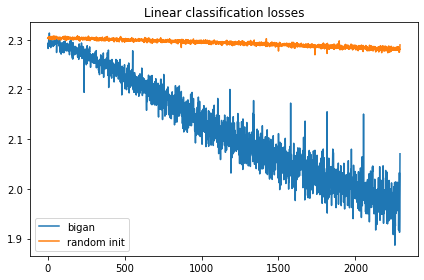

epoch:  29
BiGAN final linear classification loss: 1.936659812927246
Random encoder linear classification loss: 2.2851693630218506
BiGAN final accuracy: 0.6260878164556962
Random encoder accuracy: 0.31566455696202533


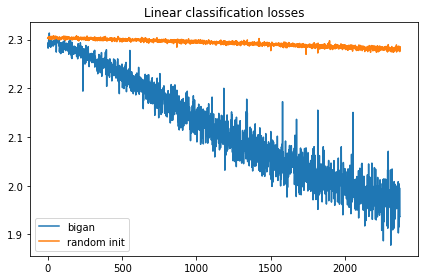

epoch:  30
BiGAN final linear classification loss: 2.034559965133667
Random encoder linear classification loss: 2.2794196605682373
BiGAN final accuracy: 0.6268789556962026
Random encoder accuracy: 0.3217958860759494


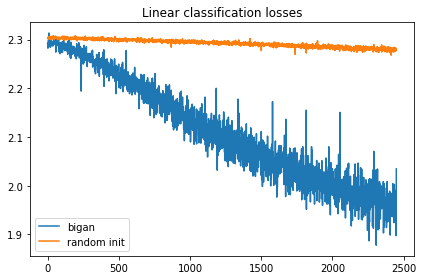

epoch:  31
BiGAN final linear classification loss: 1.9795125722885132
Random encoder linear classification loss: 2.2760119438171387
BiGAN final accuracy: 0.6395371835443038
Random encoder accuracy: 0.33188291139240506


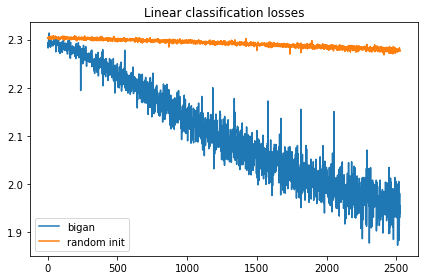

epoch:  32
BiGAN final linear classification loss: 1.9437847137451172
Random encoder linear classification loss: 2.282024621963501
BiGAN final accuracy: 0.6495253164556962
Random encoder accuracy: 0.3348496835443038


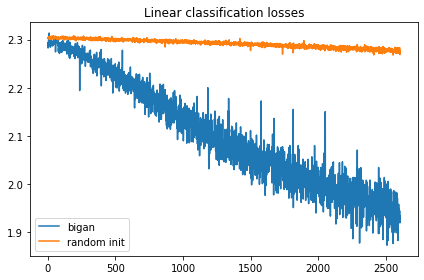

epoch:  33
BiGAN final linear classification loss: 2.0080456733703613
Random encoder linear classification loss: 2.264883041381836
BiGAN final accuracy: 0.6522943037974683
Random encoder accuracy: 0.34661787974683544


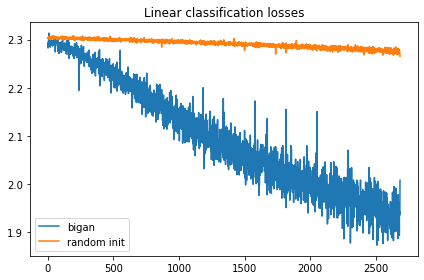

epoch:  34
BiGAN final linear classification loss: 1.9801080226898193
Random encoder linear classification loss: 2.2876763343811035
BiGAN final accuracy: 0.6670292721518988
Random encoder accuracy: 0.3479034810126582


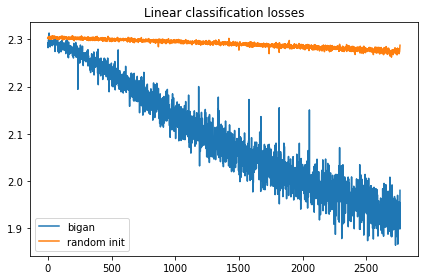

epoch:  35
BiGAN final linear classification loss: 1.9290235042572021
Random encoder linear classification loss: 2.267362594604492
BiGAN final accuracy: 0.6752373417721519
Random encoder accuracy: 0.3536392405063291


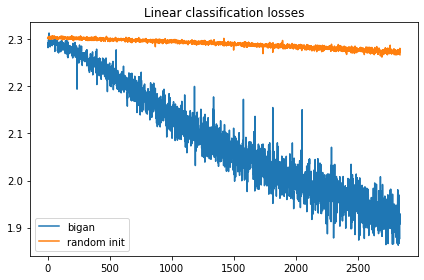

epoch:  36
BiGAN final linear classification loss: 1.9383618831634521
Random encoder linear classification loss: 2.245833158493042
BiGAN final accuracy: 0.6778085443037974
Random encoder accuracy: 0.3594738924050633


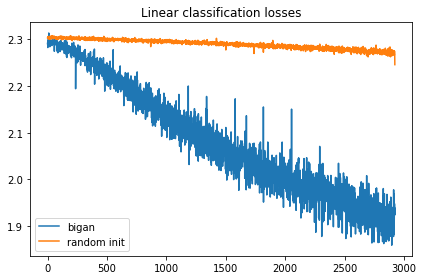

epoch:  37
BiGAN final linear classification loss: 2.053692579269409
Random encoder linear classification loss: 2.293858289718628
BiGAN final accuracy: 0.6824564873417721
Random encoder accuracy: 0.36441851265822783


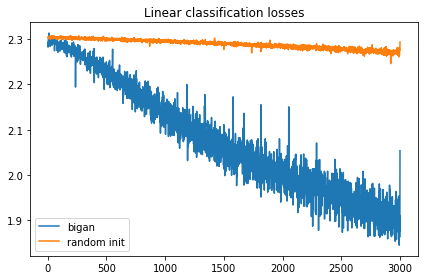

epoch:  38
BiGAN final linear classification loss: 1.8586980104446411
Random encoder linear classification loss: 2.262347459793091
BiGAN final accuracy: 0.6928401898734177
Random encoder accuracy: 0.3660996835443038


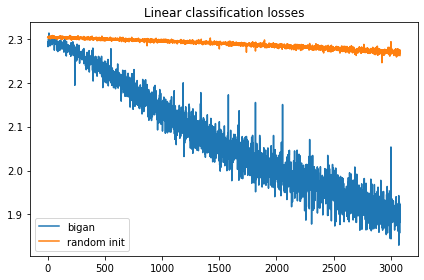

epoch:  39
BiGAN final linear classification loss: 1.9741448163986206
Random encoder linear classification loss: 2.2669906616210938
BiGAN final accuracy: 0.6984770569620253
Random encoder accuracy: 0.3696598101265823


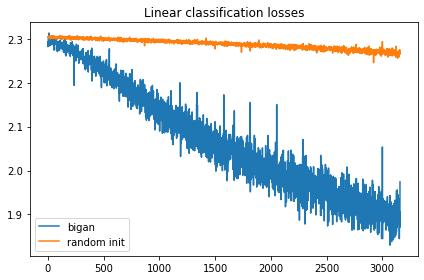

epoch:  40
BiGAN final linear classification loss: 1.8850071430206299
Random encoder linear classification loss: 2.271702766418457
BiGAN final accuracy: 0.700751582278481
Random encoder accuracy: 0.375


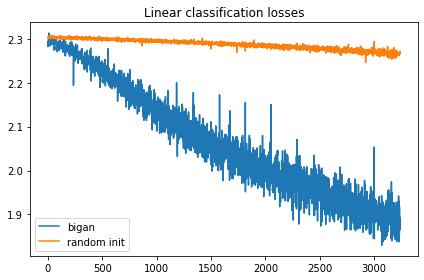

epoch:  41
BiGAN final linear classification loss: 1.9233919382095337
Random encoder linear classification loss: 2.2431674003601074
BiGAN final accuracy: 0.7080696202531646
Random encoder accuracy: 0.3740110759493671


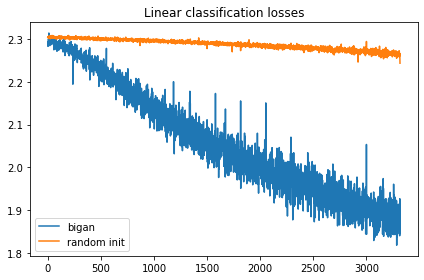

epoch:  42
BiGAN final linear classification loss: 1.898632287979126
Random encoder linear classification loss: 2.276534080505371
BiGAN final accuracy: 0.7091574367088608
Random encoder accuracy: 0.37964794303797467


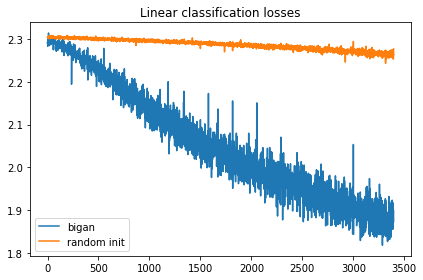

epoch:  43
BiGAN final linear classification loss: 1.8346623182296753
Random encoder linear classification loss: 2.2862017154693604
BiGAN final accuracy: 0.7143987341772152
Random encoder accuracy: 0.38024129746835444


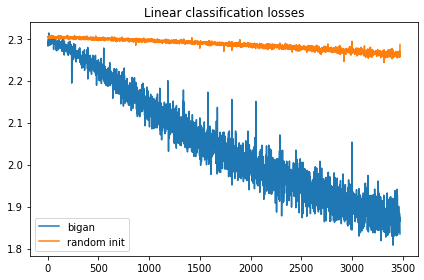

epoch:  44
BiGAN final linear classification loss: 1.909813642501831
Random encoder linear classification loss: 2.280194044113159
BiGAN final accuracy: 0.7229034810126582
Random encoder accuracy: 0.3840981012658228


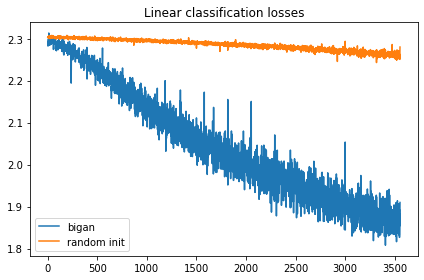

epoch:  45
BiGAN final linear classification loss: 1.7482203245162964
Random encoder linear classification loss: 2.278151035308838
BiGAN final accuracy: 0.7259691455696202
Random encoder accuracy: 0.3849881329113924


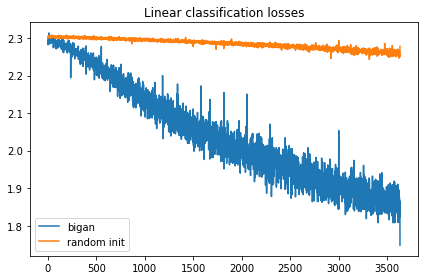

epoch:  46
BiGAN final linear classification loss: 1.9639956951141357
Random encoder linear classification loss: 2.273599147796631
BiGAN final accuracy: 0.7256724683544303
Random encoder accuracy: 0.38993275316455694


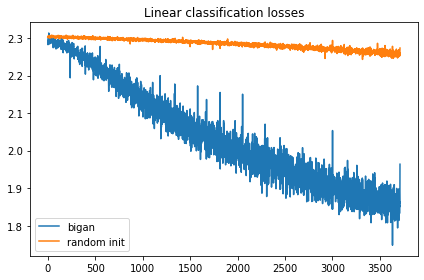

epoch:  47
BiGAN final linear classification loss: 1.969429612159729
Random encoder linear classification loss: 2.261521816253662
BiGAN final accuracy: 0.7261669303797469
Random encoder accuracy: 0.3891416139240506


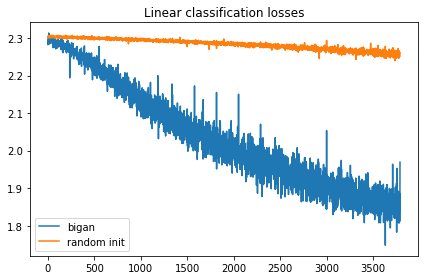

epoch:  48
BiGAN final linear classification loss: 1.9653465747833252
Random encoder linear classification loss: 2.2779698371887207
BiGAN final accuracy: 0.7323971518987342
Random encoder accuracy: 0.39013053797468356


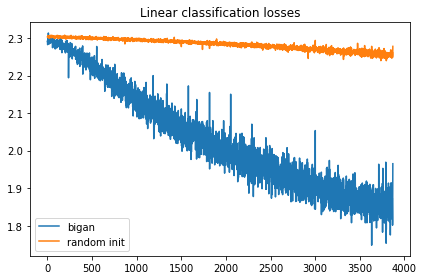

epoch:  49
BiGAN final linear classification loss: 1.8670932054519653
Random encoder linear classification loss: 2.2702901363372803
BiGAN final accuracy: 0.7353639240506329
Random encoder accuracy: 0.3909216772151899


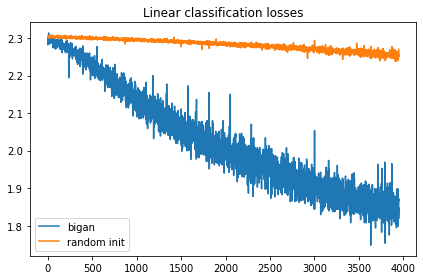

epoch:  50
BiGAN final linear classification loss: 1.853822946548462
Random encoder linear classification loss: 2.2383673191070557
BiGAN final accuracy: 0.7377373417721519
Random encoder accuracy: 0.39576740506329117


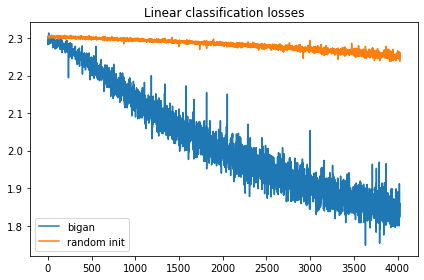

epoch:  51
BiGAN final linear classification loss: 1.8929142951965332
Random encoder linear classification loss: 2.2662198543548584
BiGAN final accuracy: 0.7418908227848101
Random encoder accuracy: 0.3962618670886076


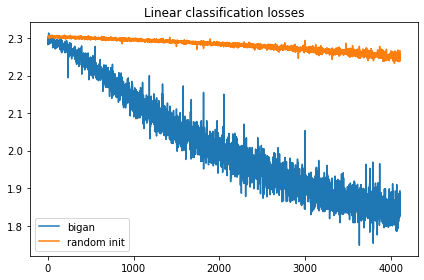

epoch:  52
BiGAN final linear classification loss: 1.7155128717422485
Random encoder linear classification loss: 2.2620787620544434
BiGAN final accuracy: 0.7463409810126582
Random encoder accuracy: 0.39497626582278483


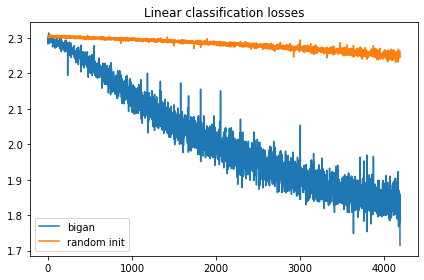

epoch:  53
BiGAN final linear classification loss: 1.9243043661117554
Random encoder linear classification loss: 2.2642154693603516
BiGAN final accuracy: 0.7460443037974683
Random encoder accuracy: 0.39823971518987344


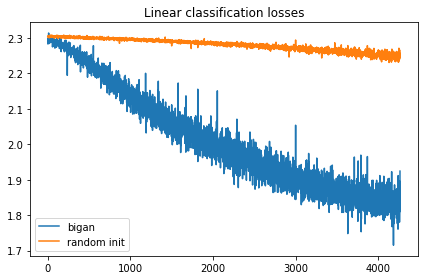

epoch:  54
BiGAN final linear classification loss: 1.8332931995391846
Random encoder linear classification loss: 2.2671120166778564
BiGAN final accuracy: 0.7496044303797469
Random encoder accuracy: 0.3996242088607595


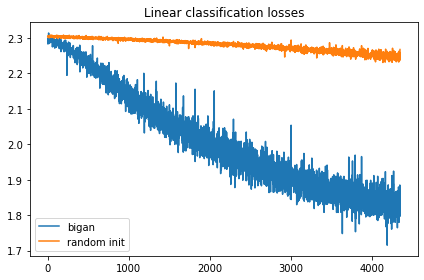

epoch:  55
BiGAN final linear classification loss: 1.8321542739868164
Random encoder linear classification loss: 2.249070644378662
BiGAN final accuracy: 0.7505933544303798
Random encoder accuracy: 0.39922863924050633


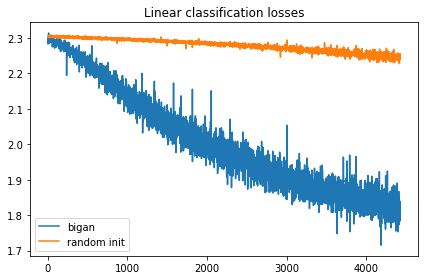

epoch:  56
BiGAN final linear classification loss: 1.8361456394195557
Random encoder linear classification loss: 2.230944871902466
BiGAN final accuracy: 0.7555379746835443
Random encoder accuracy: 0.39685522151898733


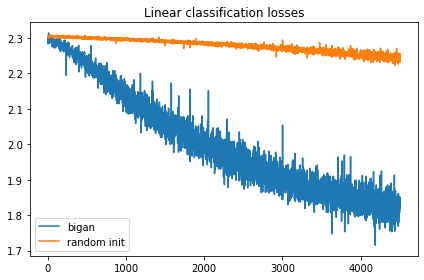

epoch:  57
BiGAN final linear classification loss: 1.9622807502746582
Random encoder linear classification loss: 2.265289068222046
BiGAN final accuracy: 0.7558346518987342
Random encoder accuracy: 0.40100870253164556


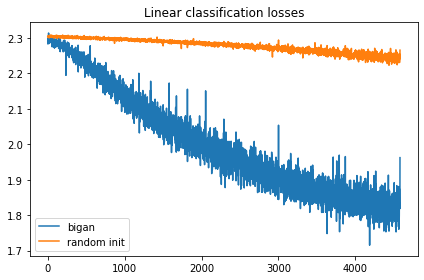

epoch:  58
BiGAN final linear classification loss: 1.8175748586654663
Random encoder linear classification loss: 2.3010709285736084
BiGAN final accuracy: 0.7562302215189873
Random encoder accuracy: 0.39774525316455694


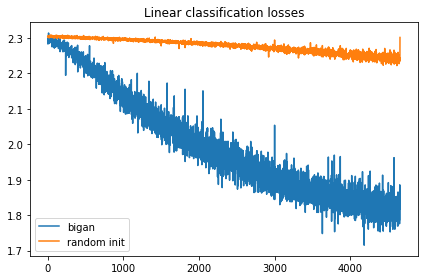

epoch:  59
BiGAN final linear classification loss: 1.7684465646743774
Random encoder linear classification loss: 2.2179720401763916
BiGAN final accuracy: 0.7596914556962026
Random encoder accuracy: 0.4053599683544304


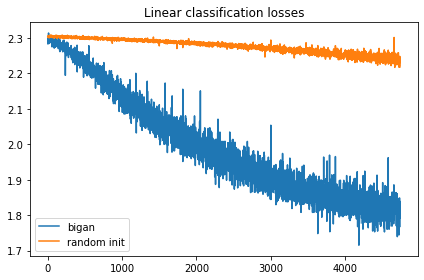

epoch:  60
BiGAN final linear classification loss: 1.7907040119171143
Random encoder linear classification loss: 2.261061668395996
BiGAN final accuracy: 0.7629549050632911
Random encoder accuracy: 0.40308544303797467


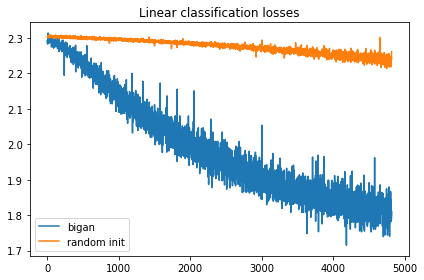

epoch:  61
BiGAN final linear classification loss: 1.7277870178222656
Random encoder linear classification loss: 2.1900269985198975
BiGAN final accuracy: 0.7650316455696202
Random encoder accuracy: 0.41060126582278483


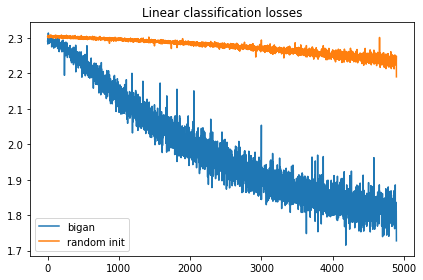

epoch:  62
BiGAN final linear classification loss: 1.7696669101715088
Random encoder linear classification loss: 2.2451250553131104
BiGAN final accuracy: 0.7646360759493671
Random encoder accuracy: 0.40437104430379744


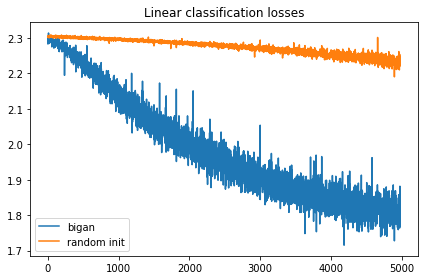

epoch:  63
BiGAN final linear classification loss: 1.9199285507202148
Random encoder linear classification loss: 2.2729554176330566
BiGAN final accuracy: 0.7680973101265823
Random encoder accuracy: 0.40545886075949367


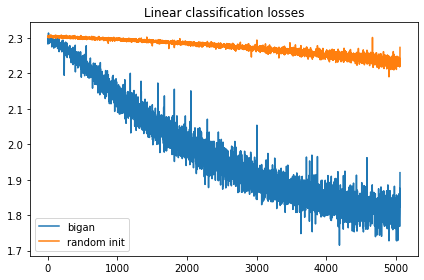

epoch:  64
BiGAN final linear classification loss: 1.735873818397522
Random encoder linear classification loss: 2.229095220565796
BiGAN final accuracy: 0.7726463607594937
Random encoder accuracy: 0.40704113924050633


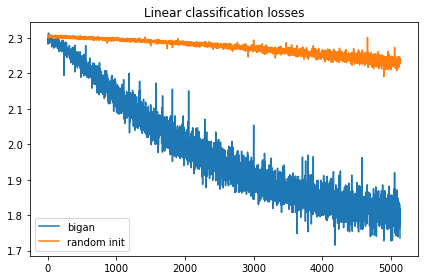

epoch:  65
BiGAN final linear classification loss: 1.809159517288208
Random encoder linear classification loss: 2.2223589420318604
BiGAN final accuracy: 0.7694818037974683
Random encoder accuracy: 0.40941455696202533


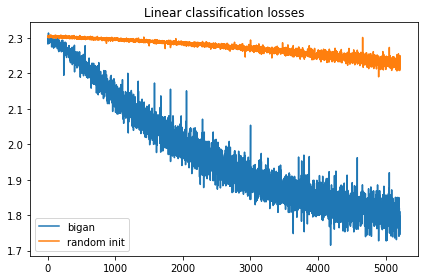

epoch:  66
BiGAN final linear classification loss: 1.7674726247787476
Random encoder linear classification loss: 2.23873233795166
BiGAN final accuracy: 0.7696795886075949
Random encoder accuracy: 0.40545886075949367


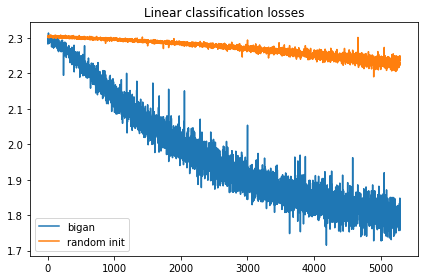

epoch:  67
BiGAN final linear classification loss: 1.7946704626083374
Random encoder linear classification loss: 2.203019618988037
BiGAN final accuracy: 0.7721518987341772
Random encoder accuracy: 0.4130735759493671


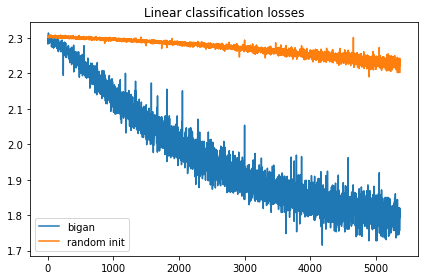

epoch:  68
BiGAN final linear classification loss: 1.8521238565444946
Random encoder linear classification loss: 2.187163829803467
BiGAN final accuracy: 0.7708662974683544
Random encoder accuracy: 0.41089794303797467


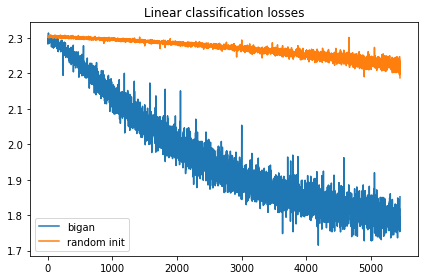

epoch:  69
BiGAN final linear classification loss: 1.9712419509887695
Random encoder linear classification loss: 2.198530435562134
BiGAN final accuracy: 0.7690862341772152
Random encoder accuracy: 0.4119857594936709


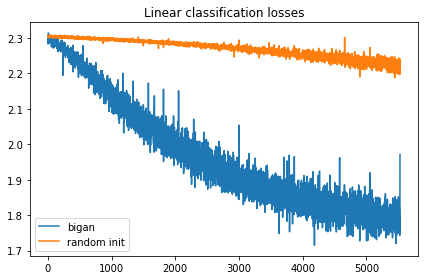

epoch:  70
BiGAN final linear classification loss: 1.8646953105926514
Random encoder linear classification loss: 2.1791951656341553
BiGAN final accuracy: 0.7747231012658228
Random encoder accuracy: 0.416435917721519


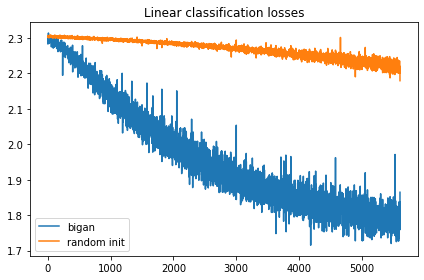

epoch:  71
BiGAN final linear classification loss: 1.899648666381836
Random encoder linear classification loss: 2.2138671875
BiGAN final accuracy: 0.7725474683544303
Random encoder accuracy: 0.41238132911392406


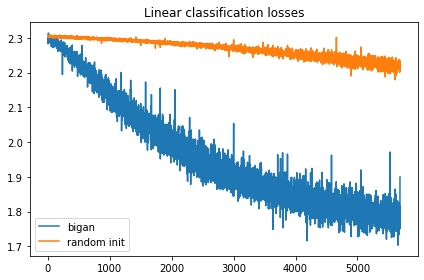

epoch:  72
BiGAN final linear classification loss: 1.8196260929107666
Random encoder linear classification loss: 2.277707099914551
BiGAN final accuracy: 0.7737341772151899
Random encoder accuracy: 0.4127768987341772


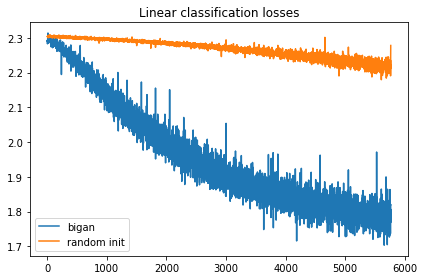

epoch:  73
BiGAN final linear classification loss: 1.7430680990219116
Random encoder linear classification loss: 2.247145652770996
BiGAN final accuracy: 0.7782832278481012
Random encoder accuracy: 0.41337025316455694


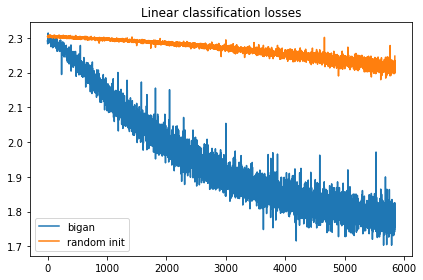

epoch:  74
BiGAN final linear classification loss: 1.904583215713501
Random encoder linear classification loss: 2.252455234527588
BiGAN final accuracy: 0.7785799050632911
Random encoder accuracy: 0.4119857594936709


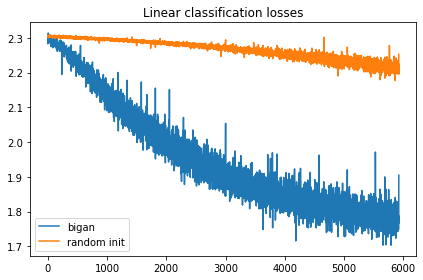

epoch:  75
BiGAN final linear classification loss: 1.7994273900985718
Random encoder linear classification loss: 2.2760491371154785
BiGAN final accuracy: 0.7817444620253164
Random encoder accuracy: 0.409315664556962


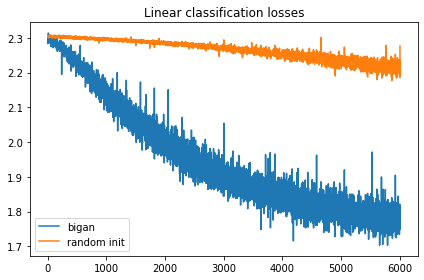

epoch:  76
BiGAN final linear classification loss: 1.8333854675292969
Random encoder linear classification loss: 2.2374536991119385
BiGAN final accuracy: 0.7824367088607594
Random encoder accuracy: 0.41594145569620256


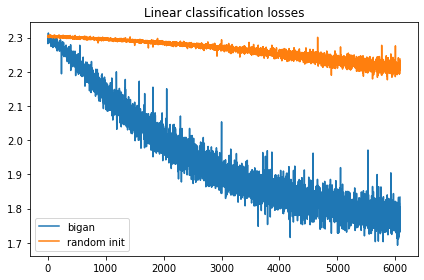

epoch:  77
BiGAN final linear classification loss: 1.829063057899475
Random encoder linear classification loss: 2.1922879219055176
BiGAN final accuracy: 0.7804588607594937
Random encoder accuracy: 0.41693037974683544


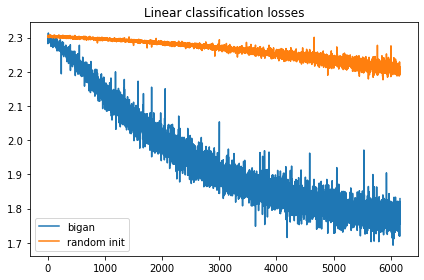

epoch:  78
BiGAN final linear classification loss: 1.9041016101837158
Random encoder linear classification loss: 2.1455750465393066
BiGAN final accuracy: 0.7817444620253164
Random encoder accuracy: 0.4153481012658228


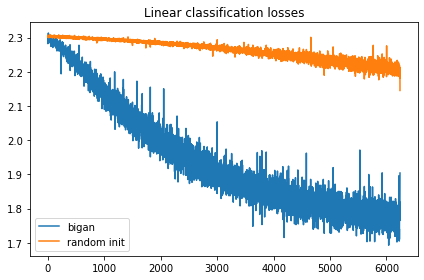

epoch:  79
BiGAN final linear classification loss: 1.720760703086853
Random encoder linear classification loss: 2.1841344833374023
BiGAN final accuracy: 0.7882713607594937
Random encoder accuracy: 0.41337025316455694


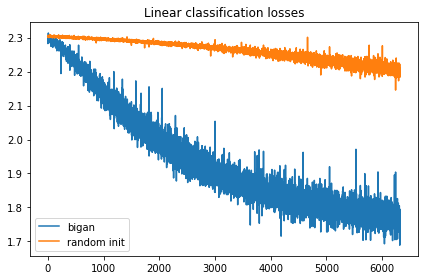

epoch:  80
BiGAN final linear classification loss: 1.7617753744125366
Random encoder linear classification loss: 2.1585094928741455
BiGAN final accuracy: 0.7847112341772152
Random encoder accuracy: 0.4163370253164557


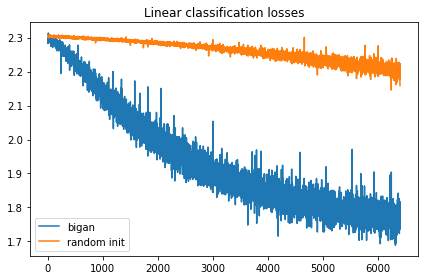

epoch:  81
BiGAN final linear classification loss: 1.8850376605987549
Random encoder linear classification loss: 2.2181832790374756
BiGAN final accuracy: 0.7839200949367089
Random encoder accuracy: 0.4194026898734177


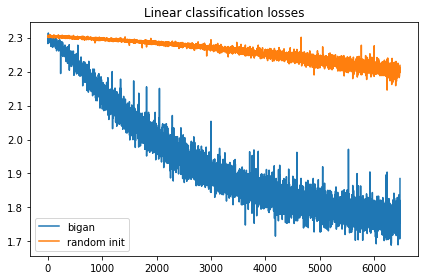

epoch:  82
BiGAN final linear classification loss: 2.0231804847717285
Random encoder linear classification loss: 2.185112714767456
BiGAN final accuracy: 0.7810522151898734
Random encoder accuracy: 0.42227056962025317


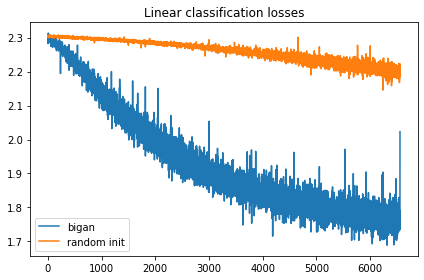

epoch:  83
BiGAN final linear classification loss: 1.8316032886505127
Random encoder linear classification loss: 2.205764055252075
BiGAN final accuracy: 0.7876780063291139
Random encoder accuracy: 0.4161392405063291


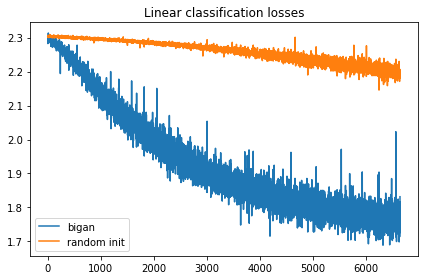

epoch:  84
BiGAN final linear classification loss: 1.760681390762329
Random encoder linear classification loss: 2.273557424545288
BiGAN final accuracy: 0.7877768987341772
Random encoder accuracy: 0.4162381329113924


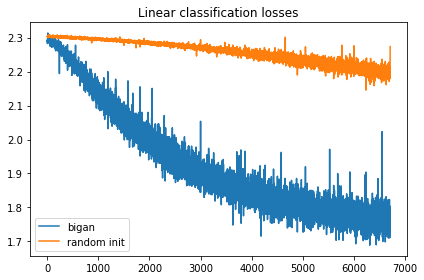

epoch:  85
BiGAN final linear classification loss: 1.777453899383545
Random encoder linear classification loss: 2.2350733280181885
BiGAN final accuracy: 0.7910403481012658
Random encoder accuracy: 0.4176226265822785


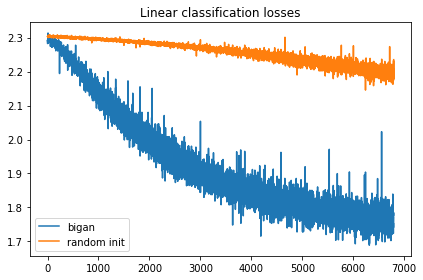

epoch:  86
BiGAN final linear classification loss: 1.7213096618652344
Random encoder linear classification loss: 2.1754021644592285
BiGAN final accuracy: 0.7919303797468354
Random encoder accuracy: 0.4183148734177215


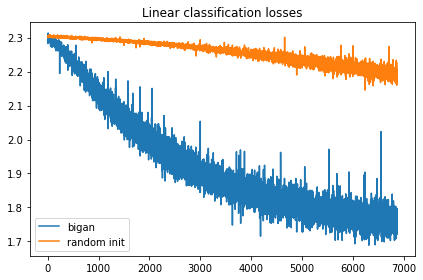

epoch:  87
BiGAN final linear classification loss: 1.7729042768478394
Random encoder linear classification loss: 2.1875009536743164
BiGAN final accuracy: 0.7909414556962026
Random encoder accuracy: 0.42138053797468356


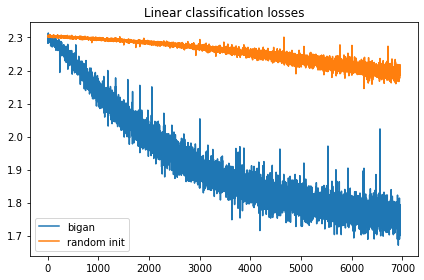

epoch:  88
BiGAN final linear classification loss: 1.698612093925476
Random encoder linear classification loss: 2.184684991836548
BiGAN final accuracy: 0.7932159810126582
Random encoder accuracy: 0.4219738924050633


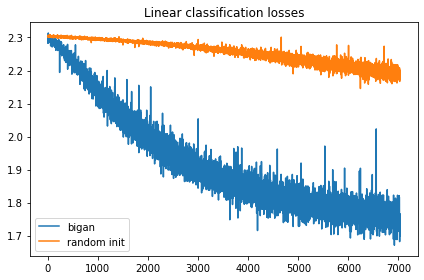

epoch:  89
BiGAN final linear classification loss: 1.7695159912109375
Random encoder linear classification loss: 2.203549385070801
BiGAN final accuracy: 0.7929193037974683
Random encoder accuracy: 0.42385284810126583


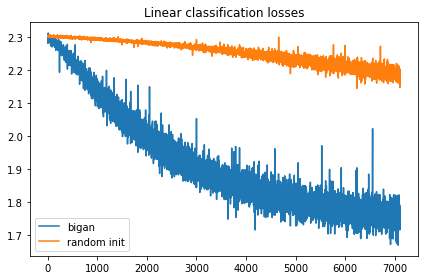

epoch:  90
BiGAN final linear classification loss: 1.8454469442367554
Random encoder linear classification loss: 2.2606818675994873
BiGAN final accuracy: 0.7912381329113924
Random encoder accuracy: 0.41811708860759494


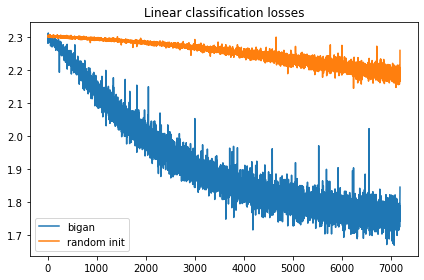

epoch:  91
BiGAN final linear classification loss: 1.8641382455825806
Random encoder linear classification loss: 2.14559268951416
BiGAN final accuracy: 0.7918314873417721
Random encoder accuracy: 0.424248417721519


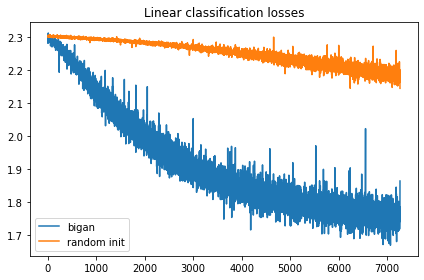

epoch:  92
BiGAN final linear classification loss: 1.8381538391113281
Random encoder linear classification loss: 2.1798200607299805
BiGAN final accuracy: 0.7954905063291139
Random encoder accuracy: 0.42375395569620256


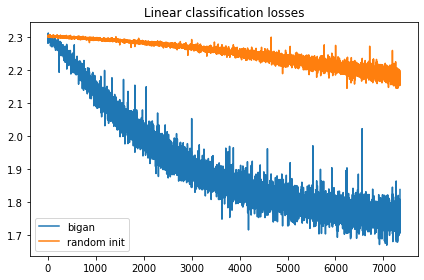

epoch:  93
BiGAN final linear classification loss: 1.6623424291610718
Random encoder linear classification loss: 2.162949800491333
BiGAN final accuracy: 0.7974683544303798
Random encoder accuracy: 0.42266613924050633


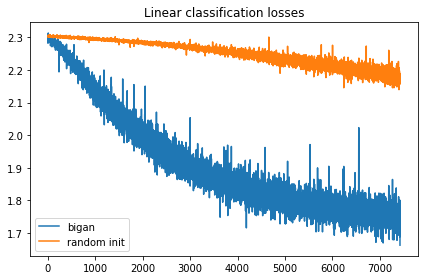

epoch:  94
BiGAN final linear classification loss: 1.6813406944274902
Random encoder linear classification loss: 2.215841293334961
BiGAN final accuracy: 0.8004351265822784
Random encoder accuracy: 0.42454509493670883


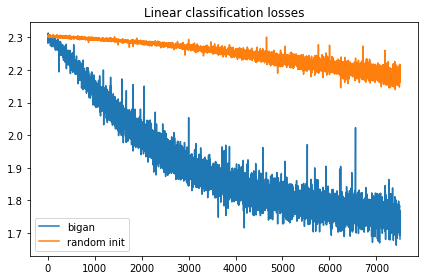

epoch:  95
BiGAN final linear classification loss: 1.9193819761276245
Random encoder linear classification loss: 2.2407643795013428
BiGAN final accuracy: 0.7948971518987342
Random encoder accuracy: 0.4251384493670886


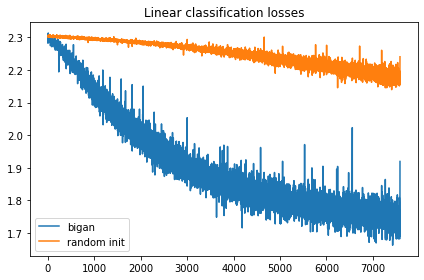

epoch:  96
BiGAN final linear classification loss: 1.6906992197036743
Random encoder linear classification loss: 2.2319538593292236
BiGAN final accuracy: 0.7983583860759493
Random encoder accuracy: 0.4227650316455696


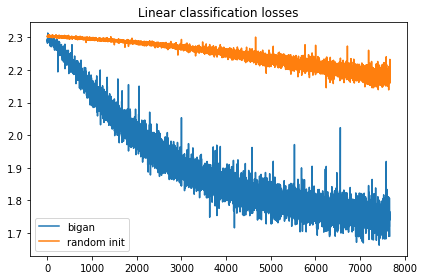

epoch:  97
BiGAN final linear classification loss: 1.8248319625854492
Random encoder linear classification loss: 2.272937297821045
BiGAN final accuracy: 0.7979628164556962
Random encoder accuracy: 0.42573180379746833


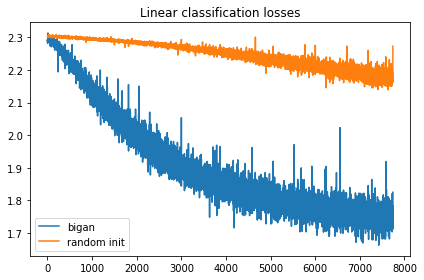

epoch:  98
BiGAN final linear classification loss: 1.7397843599319458
Random encoder linear classification loss: 2.1459662914276123
BiGAN final accuracy: 0.8000395569620253
Random encoder accuracy: 0.4297863924050633


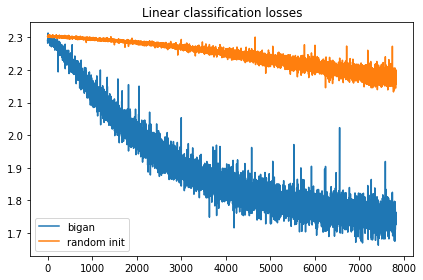

epoch:  99
BiGAN final linear classification loss: 1.8391730785369873
Random encoder linear classification loss: 2.1969563961029053
BiGAN final accuracy: 0.7978639240506329
Random encoder accuracy: 0.42800632911392406


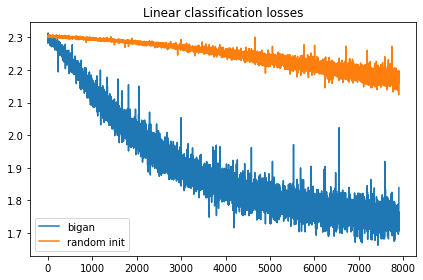

TypeError: ignored

In [ ]:
class L(nn.Module):
    def __init__(self):
        super().__init__()
        latent_dim = 50
        out = 10
        self.linear = nn.Sequential(
            nn.Linear(latent_dim, out, bias = False),
            nn.Softmax(),
        )
        self.criterion = nn.CrossEntropyLoss()

    def loss(self, x, label):
        x = x.float()
        pred = self.linear(x) #[B, C]
        loss = self.criterion(pred, label.long())
        return loss

    def accuracy(self, x, label):
        x = x.float()
        pred = self.linear(x)
        pred_labels = pred.max(dim = 1)[1]
        accuracy = (pred_labels == label).sum()/float(label.shape[0])
        return accuracy.item()

def train_encoder(encoder, classifier, optimizer, train_loader):
    for data in train_loader:
        x = data[0]
        label = data[1]
        x = x.cuda().contiguous()
        bs = x.shape[0]
        x = x.view(bs, -1)
        label = label.cuda().contiguous()
        loss = classifier.loss(encoder(x), label)

        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

def test_encoder(encoder, classifier, optimizer, test_loader):
    losses = []
    accuracy = 0
    count = 0
    for x in test_loader:
        count += 1
        label = x[1]
        x = x[0]
        x = x.cuda().contiguous()
        bs = x.shape[0]
        x = x.view(bs, -1)
        label = label.cuda().contiguous()
        zs = encoder(x)
        loss = classifier.loss(zs, label)
        losses.append(loss.detach().cpu().item())
        accuracy += classifier.accuracy(zs, label)
    return losses, accuracy/count


# def train_classifier(train_data, test_data):
#     train_loader = data.DataLoader(train_data, batch_size=128, shuffle=True)
#     test_loader = data.DataLoader(test_data, batch_size=128, shuffle=True)
#     global model
#     random_encoder = E().cuda()
#     L1 = L().cuda()
#     L2 = L().cuda()
#     E_optimizer = optim.SGD(L1.parameters(), lr=1e-3)
#     rand_e_optimizer = optim.SGD(L2.parameters(), lr=1e-3)
#     classifier1_loss = []
#     classifier2_loss = []
#     for epoch in range(100):
#         print("epoch: ", epoch)
#         train_encoder(model.E, L1, E_optimizer, train_loader)
#         train_encoder(random_encoder, L2, rand_e_optimizer, train_loader)
#         losses1, accuracy1 = test_encoder(model.E, L1, E_optimizer, test_loader)
#         classifier1_loss.extend(losses1)
#         losses2, accuracy2 = test_encoder(random_encoder, L2, rand_e_optimizer, test_loader)
#         classifier2_loss.extend(losses2)
#         print('BiGAN final linear classification loss:', classifier1_loss[-1])
#         print('Random encoder linear classification loss:', classifier2_loss[-1])
#         print('BiGAN final accuracy:', accuracy1)
#         print('Random encoder accuracy:', accuracy2)
#         plot_q3_supervised(classifier1_loss, classifier2_loss, 'Linear classification losses', 'results/q3_supervised_losses.png')
# q3_save_results(train_classifier)

epoch:  0
BiGAN final linear classification loss: 2.2072439193725586
Random encoder linear classification loss: 2.2997655868530273
BiGAN final accuracy: 0.393690664556962
Random encoder accuracy: 0.23635284810126583


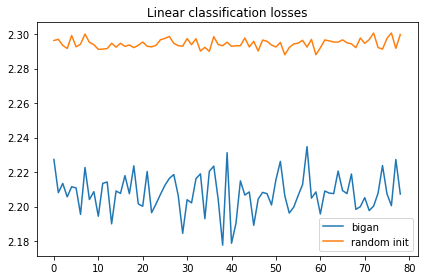

epoch:  1
BiGAN final linear classification loss: 2.100447654724121
Random encoder linear classification loss: 2.29280161857605
BiGAN final accuracy: 0.6301424050632911
Random encoder accuracy: 0.2903481012658228


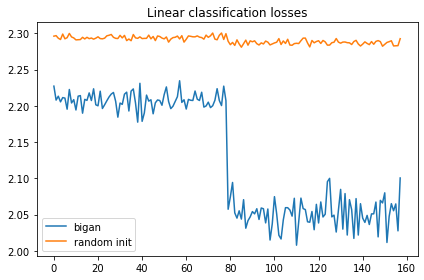

epoch:  2
BiGAN final linear classification loss: 1.85830819606781
Random encoder linear classification loss: 2.280109167098999
BiGAN final accuracy: 0.6909612341772152
Random encoder accuracy: 0.32674050632911394


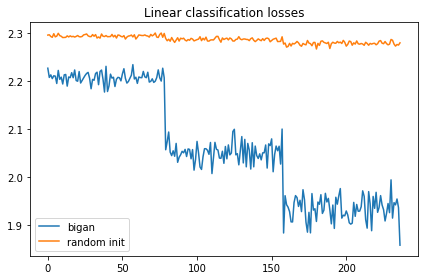

epoch:  3
BiGAN final linear classification loss: 1.9011553525924683
Random encoder linear classification loss: 2.2501015663146973
BiGAN final accuracy: 0.7185522151898734
Random encoder accuracy: 0.34770569620253167


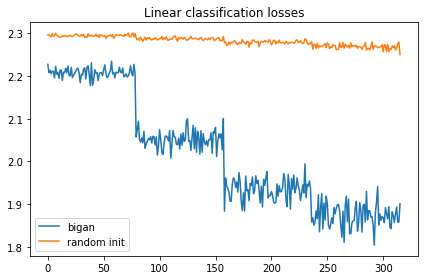

epoch:  4
BiGAN final linear classification loss: 1.9123190641403198
Random encoder linear classification loss: 2.258176326751709
BiGAN final accuracy: 0.737440664556962
Random encoder accuracy: 0.3629351265822785


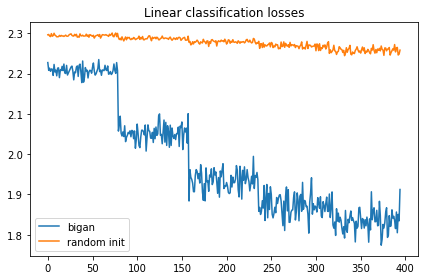

epoch:  5
BiGAN final linear classification loss: 1.8380458354949951
Random encoder linear classification loss: 2.2244999408721924
BiGAN final accuracy: 0.7533623417721519
Random encoder accuracy: 0.3728243670886076


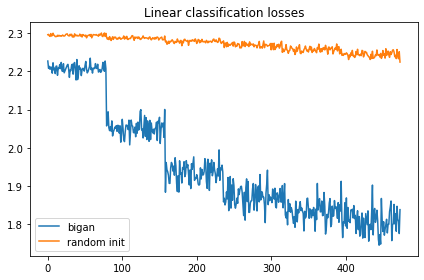

epoch:  6
BiGAN final linear classification loss: 1.8943285942077637
Random encoder linear classification loss: 2.208353042602539
BiGAN final accuracy: 0.7683939873417721
Random encoder accuracy: 0.38874604430379744


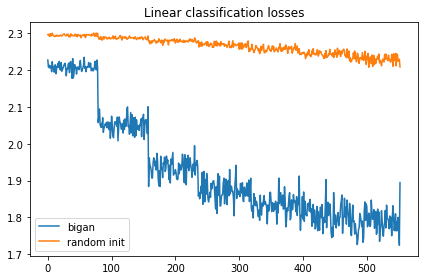

epoch:  7
BiGAN final linear classification loss: 1.764319896697998
Random encoder linear classification loss: 2.2726075649261475
BiGAN final accuracy: 0.781942246835443
Random encoder accuracy: 0.39408623417721517


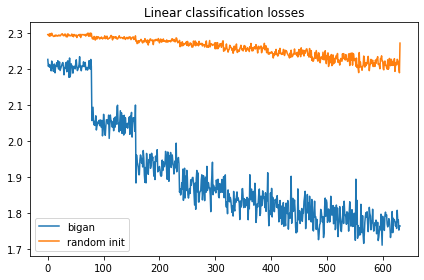

epoch:  8
BiGAN final linear classification loss: 1.8394546508789062
Random encoder linear classification loss: 2.247460126876831
BiGAN final accuracy: 0.7939082278481012
Random encoder accuracy: 0.4047666139240506


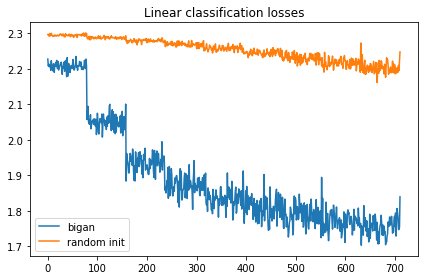

epoch:  9
BiGAN final linear classification loss: 1.6521583795547485
Random encoder linear classification loss: 2.150987386703491
BiGAN final accuracy: 0.8035007911392406
Random encoder accuracy: 0.4196004746835443


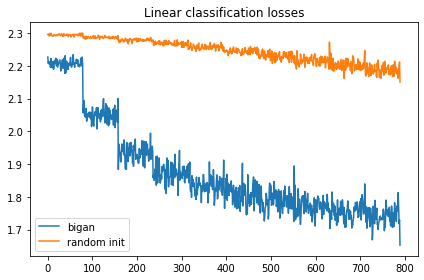

epoch:  10
BiGAN final linear classification loss: 1.6632360219955444
Random encoder linear classification loss: 2.241535186767578
BiGAN final accuracy: 0.8096321202531646
Random encoder accuracy: 0.4254351265822785


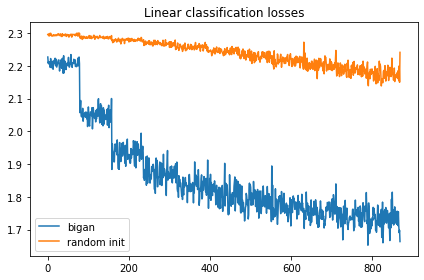

epoch:  11
BiGAN final linear classification loss: 1.8388293981552124
Random encoder linear classification loss: 2.0810704231262207
BiGAN final accuracy: 0.8124011075949367
Random encoder accuracy: 0.44036787974683544


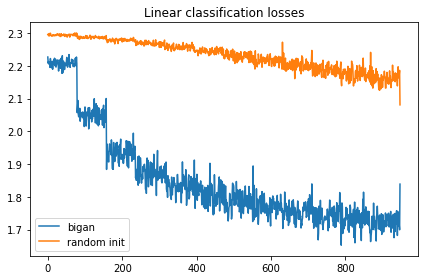

epoch:  12
BiGAN final linear classification loss: 1.6425671577453613
Random encoder linear classification loss: 2.162426710128784
BiGAN final accuracy: 0.8202136075949367
Random encoder accuracy: 0.4470925632911392


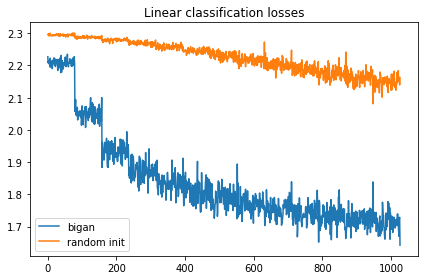

epoch:  13
BiGAN final linear classification loss: 1.815504550933838
Random encoder linear classification loss: 2.1277873516082764
BiGAN final accuracy: 0.8240704113924051
Random encoder accuracy: 0.4596518987341772


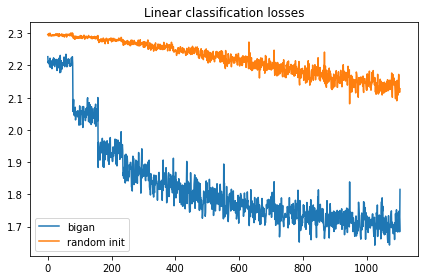

epoch:  14
BiGAN final linear classification loss: 1.7723873853683472
Random encoder linear classification loss: 2.1572647094726562
BiGAN final accuracy: 0.825059335443038
Random encoder accuracy: 0.47151898734177217


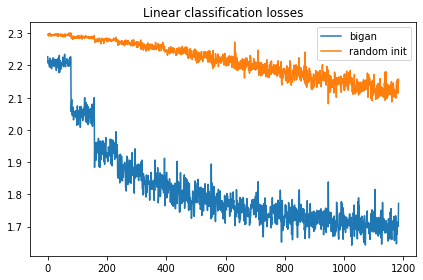

epoch:  15
BiGAN final linear classification loss: 1.758176565170288
Random encoder linear classification loss: 2.0547685623168945
BiGAN final accuracy: 0.8284216772151899
Random encoder accuracy: 0.4837816455696203


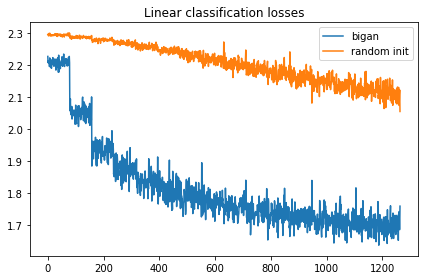

epoch:  16
BiGAN final linear classification loss: 1.7798194885253906
Random encoder linear classification loss: 2.01412296295166
BiGAN final accuracy: 0.8321795886075949
Random encoder accuracy: 0.4907041139240506


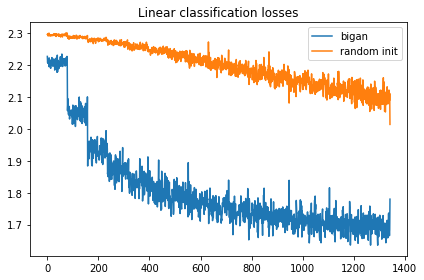

epoch:  17
BiGAN final linear classification loss: 1.6954973936080933
Random encoder linear classification loss: 2.1481783390045166
BiGAN final accuracy: 0.8392009493670886
Random encoder accuracy: 0.4911985759493671


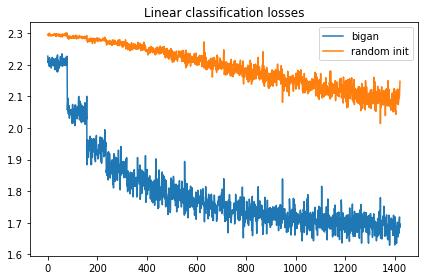

epoch:  18
BiGAN final linear classification loss: 1.76825749874115
Random encoder linear classification loss: 2.1347460746765137
BiGAN final accuracy: 0.8380142405063291
Random encoder accuracy: 0.49831882911392406


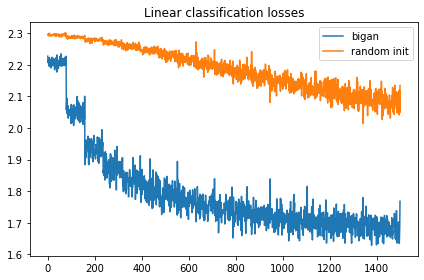

epoch:  19
BiGAN final linear classification loss: 1.7325732707977295
Random encoder linear classification loss: 2.1230740547180176
BiGAN final accuracy: 0.8411787974683544
Random encoder accuracy: 0.5036590189873418


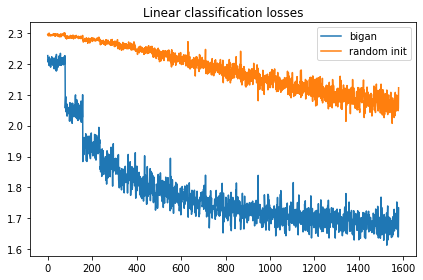

epoch:  20
BiGAN final linear classification loss: 1.7285093069076538
Random encoder linear classification loss: 2.1327168941497803
BiGAN final accuracy: 0.8448378164556962
Random encoder accuracy: 0.508504746835443


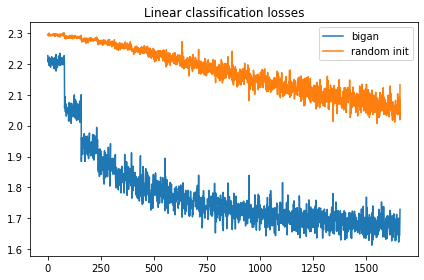

epoch:  21
BiGAN final linear classification loss: 1.5434433221817017
Random encoder linear classification loss: 2.2268176078796387
BiGAN final accuracy: 0.8477056962025317
Random encoder accuracy: 0.5129549050632911


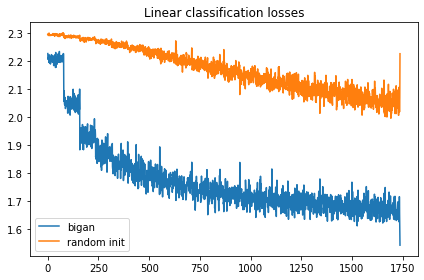

epoch:  22
BiGAN final linear classification loss: 1.6186500787734985
Random encoder linear classification loss: 2.1170732975006104
BiGAN final accuracy: 0.8475079113924051
Random encoder accuracy: 0.5168117088607594


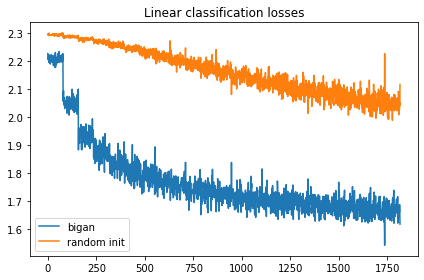

epoch:  23
BiGAN final linear classification loss: 1.559629201889038
Random encoder linear classification loss: 1.9354051351547241
BiGAN final accuracy: 0.8525514240506329
Random encoder accuracy: 0.5232397151898734


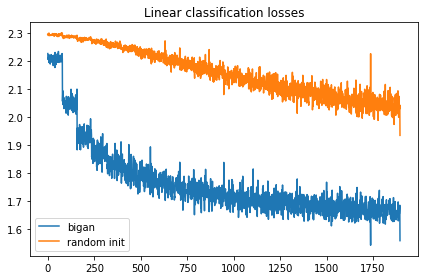

epoch:  24
BiGAN final linear classification loss: 1.621655821800232
Random encoder linear classification loss: 2.032292127609253
BiGAN final accuracy: 0.8523536392405063
Random encoder accuracy: 0.5280854430379747


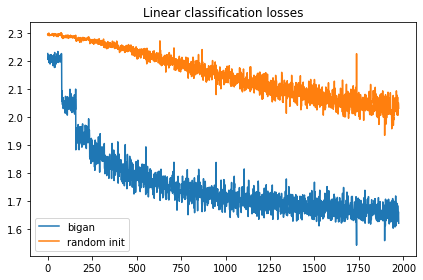

epoch:  25
BiGAN final linear classification loss: 1.671567440032959
Random encoder linear classification loss: 2.1073145866394043
BiGAN final accuracy: 0.854628164556962
Random encoder accuracy: 0.5308544303797469


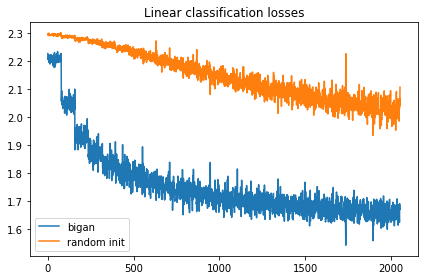

epoch:  26
BiGAN final linear classification loss: 1.7198635339736938
Random encoder linear classification loss: 2.0666515827178955
BiGAN final accuracy: 0.8526503164556962
Random encoder accuracy: 0.5360957278481012


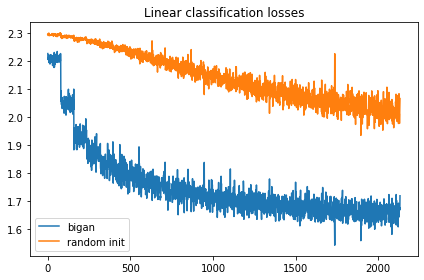

epoch:  27
BiGAN final linear classification loss: 1.6568318605422974
Random encoder linear classification loss: 1.9721585512161255
BiGAN final accuracy: 0.8587816455696202
Random encoder accuracy: 0.5411392405063291


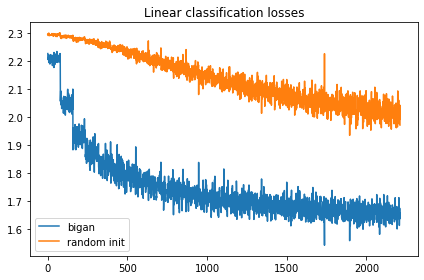

epoch:  28
BiGAN final linear classification loss: 1.8111865520477295
Random encoder linear classification loss: 1.967381477355957
BiGAN final accuracy: 0.8569026898734177
Random encoder accuracy: 0.5444026898734177


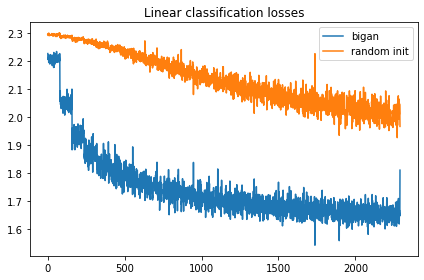

epoch:  29
BiGAN final linear classification loss: 1.6161115169525146
Random encoder linear classification loss: 2.0050814151763916
BiGAN final accuracy: 0.8592761075949367
Random encoder accuracy: 0.5483583860759493


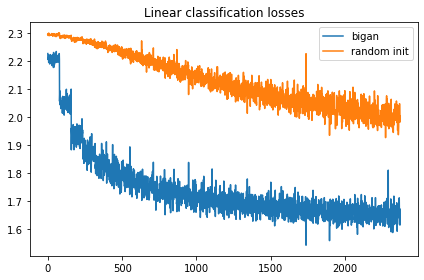

epoch:  30
BiGAN final linear classification loss: 1.5892525911331177
Random encoder linear classification loss: 1.9935585260391235
BiGAN final accuracy: 0.8608583860759493
Random encoder accuracy: 0.5540941455696202


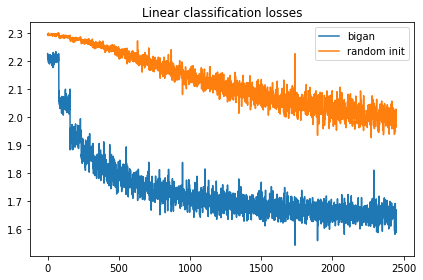

epoch:  31
BiGAN final linear classification loss: 1.837041974067688
Random encoder linear classification loss: 2.175401449203491
BiGAN final accuracy: 0.8614517405063291
Random encoder accuracy: 0.5538963607594937


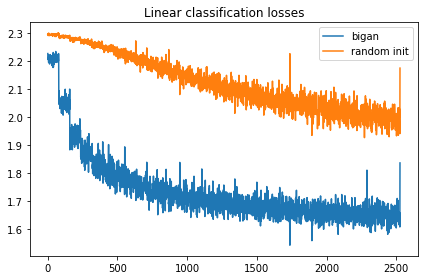

epoch:  32
BiGAN final linear classification loss: 1.816735029220581
Random encoder linear classification loss: 2.0526413917541504
BiGAN final accuracy: 0.8628362341772152
Random encoder accuracy: 0.5578520569620253


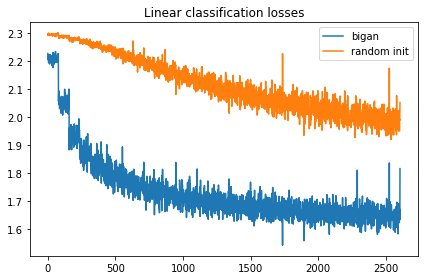

epoch:  33
BiGAN final linear classification loss: 1.8411561250686646
Random encoder linear classification loss: 1.9491716623306274
BiGAN final accuracy: 0.8608583860759493
Random encoder accuracy: 0.5628955696202531


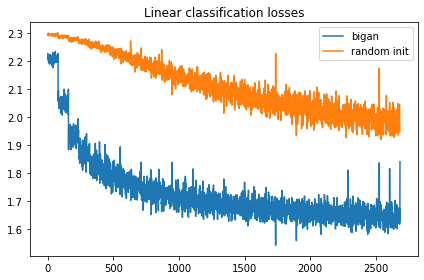

epoch:  34
BiGAN final linear classification loss: 1.614166259765625
Random encoder linear classification loss: 1.8735811710357666
BiGAN final accuracy: 0.8656052215189873
Random encoder accuracy: 0.5682357594936709


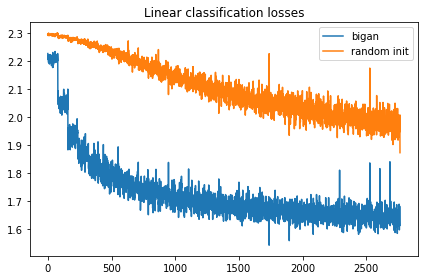

epoch:  35
BiGAN final linear classification loss: 1.7801047563552856
Random encoder linear classification loss: 2.0100021362304688
BiGAN final accuracy: 0.8605617088607594
Random encoder accuracy: 0.5715981012658228


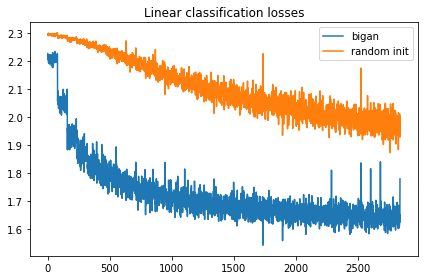

epoch:  36
BiGAN final linear classification loss: 1.796957015991211
Random encoder linear classification loss: 2.0271971225738525
BiGAN final accuracy: 0.8625395569620253
Random encoder accuracy: 0.5745648734177216


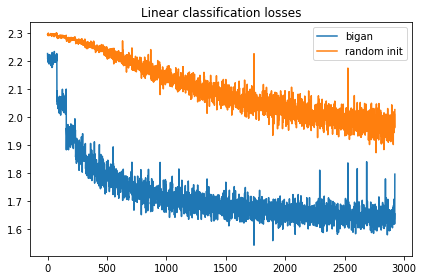

epoch:  37
BiGAN final linear classification loss: 1.7659865617752075
Random encoder linear classification loss: 2.030935049057007
BiGAN final accuracy: 0.8634295886075949
Random encoder accuracy: 0.5763449367088608


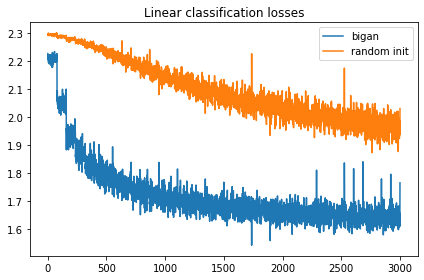

epoch:  38
BiGAN final linear classification loss: 1.7360647916793823
Random encoder linear classification loss: 2.0732693672180176
BiGAN final accuracy: 0.866495253164557
Random encoder accuracy: 0.5812895569620253


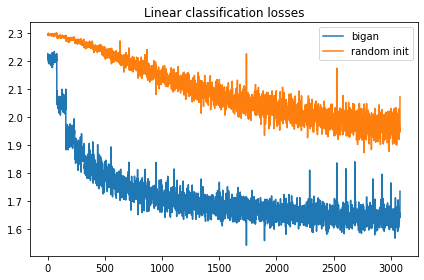

epoch:  39
BiGAN final linear classification loss: 1.7180397510528564
Random encoder linear classification loss: 2.0097906589508057
BiGAN final accuracy: 0.8660996835443038
Random encoder accuracy: 0.5858386075949367


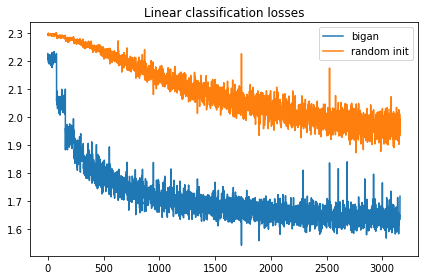

epoch:  40
BiGAN final linear classification loss: 1.5922662019729614
Random encoder linear classification loss: 2.026960849761963
BiGAN final accuracy: 0.867879746835443
Random encoder accuracy: 0.5918710443037974


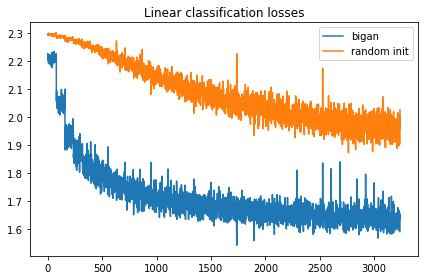

epoch:  41
BiGAN final linear classification loss: 1.6937625408172607
Random encoder linear classification loss: 1.7450835704803467
BiGAN final accuracy: 0.8669897151898734
Random encoder accuracy: 0.5989912974683544


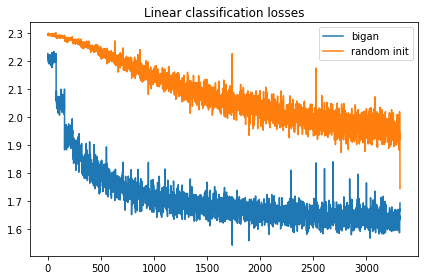

epoch:  42
BiGAN final linear classification loss: 1.6081657409667969
Random encoder linear classification loss: 1.9911879301071167
BiGAN final accuracy: 0.8686708860759493
Random encoder accuracy: 0.5990901898734177


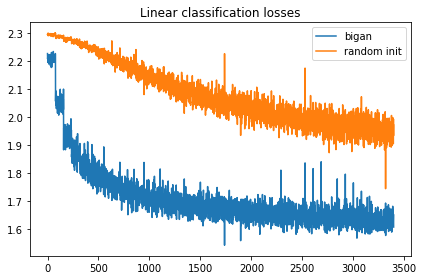

epoch:  43
BiGAN final linear classification loss: 1.6453937292099
Random encoder linear classification loss: 1.9741482734680176
BiGAN final accuracy: 0.867879746835443
Random encoder accuracy: 0.6042325949367089


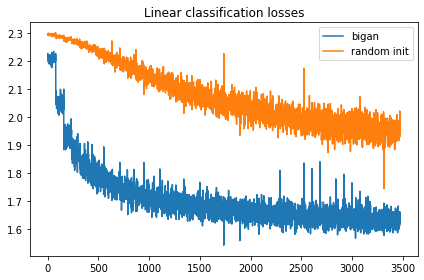

epoch:  44
BiGAN final linear classification loss: 1.6195764541625977
Random encoder linear classification loss: 2.076993227005005
BiGAN final accuracy: 0.8687697784810127
Random encoder accuracy: 0.6057159810126582


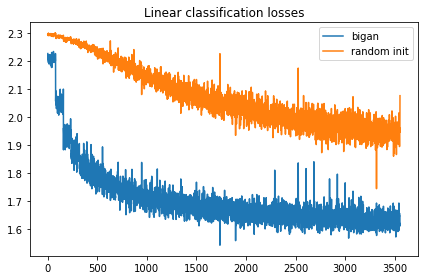

epoch:  45
BiGAN final linear classification loss: 1.612260103225708
Random encoder linear classification loss: 1.831059217453003
BiGAN final accuracy: 0.8717365506329114
Random encoder accuracy: 0.611748417721519


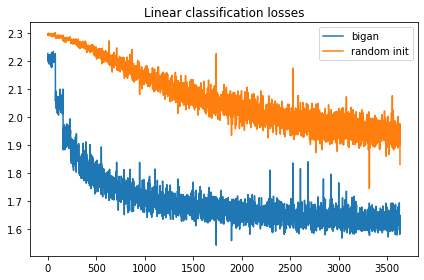

epoch:  46
BiGAN final linear classification loss: 1.5832691192626953
Random encoder linear classification loss: 1.9202334880828857
BiGAN final accuracy: 0.8722310126582279
Random encoder accuracy: 0.6145174050632911


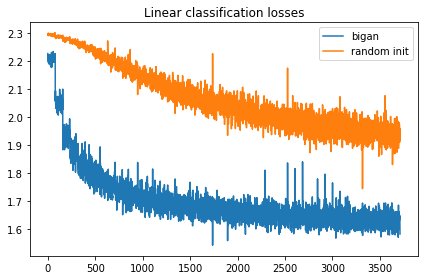

epoch:  47
BiGAN final linear classification loss: 1.6889435052871704
Random encoder linear classification loss: 2.0135300159454346
BiGAN final accuracy: 0.866495253164557
Random encoder accuracy: 0.6150118670886076


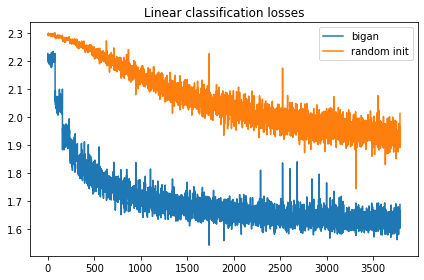

epoch:  48
BiGAN final linear classification loss: 1.755513072013855
Random encoder linear classification loss: 1.9884597063064575
BiGAN final accuracy: 0.8691653481012658
Random encoder accuracy: 0.616495253164557


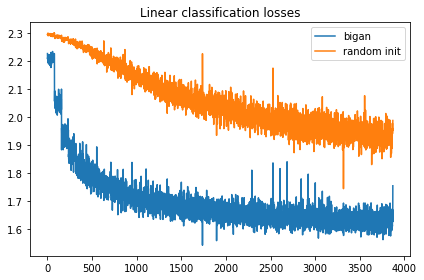

epoch:  49
BiGAN final linear classification loss: 1.6544771194458008
Random encoder linear classification loss: 1.9669853448867798
BiGAN final accuracy: 0.8738132911392406
Random encoder accuracy: 0.6221321202531646


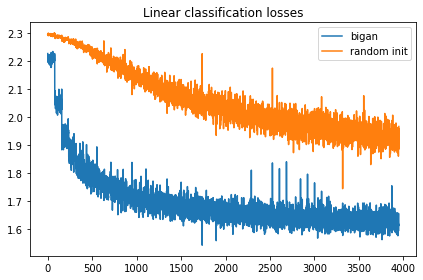

epoch:  50
BiGAN final linear classification loss: 1.6467028856277466
Random encoder linear classification loss: 1.9459218978881836
BiGAN final accuracy: 0.8720332278481012
Random encoder accuracy: 0.6254944620253164


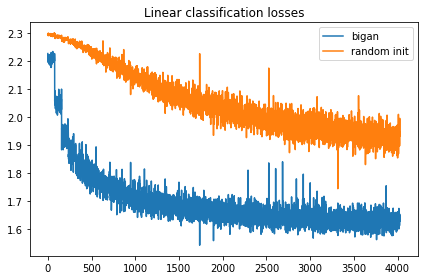

epoch:  51
BiGAN final linear classification loss: 1.7158515453338623
Random encoder linear classification loss: 2.010341167449951
BiGAN final accuracy: 0.8721321202531646
Random encoder accuracy: 0.628065664556962


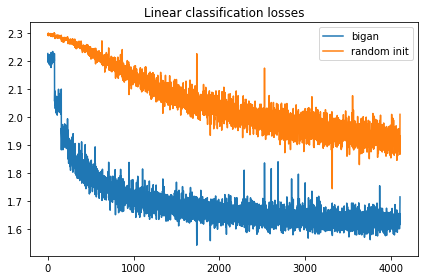

epoch:  52
BiGAN final linear classification loss: 1.648322582244873
Random encoder linear classification loss: 1.791977882385254
BiGAN final accuracy: 0.8740110759493671
Random encoder accuracy: 0.6347903481012658


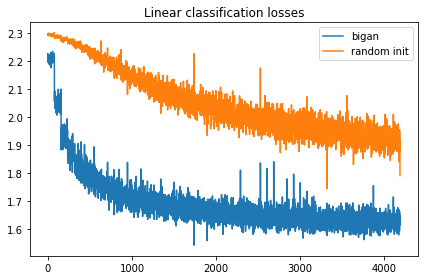

epoch:  53
BiGAN final linear classification loss: 1.6674174070358276
Random encoder linear classification loss: 1.8440693616867065
BiGAN final accuracy: 0.8707476265822784
Random encoder accuracy: 0.6360759493670886


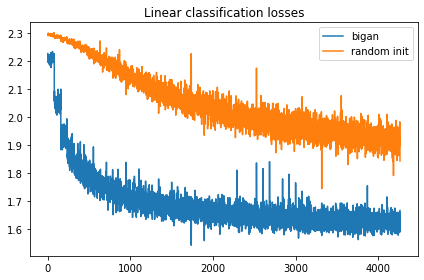

epoch:  54
BiGAN final linear classification loss: 1.580119252204895
Random encoder linear classification loss: 1.8575464487075806
BiGAN final accuracy: 0.8728243670886076
Random encoder accuracy: 0.6372626582278481


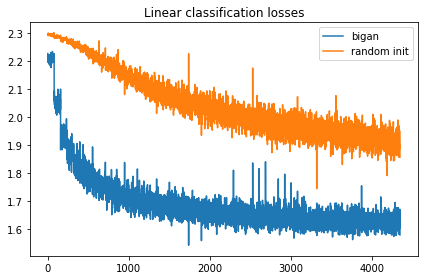

epoch:  55
BiGAN final linear classification loss: 1.6411255598068237
Random encoder linear classification loss: 1.9738047122955322
BiGAN final accuracy: 0.8729232594936709
Random encoder accuracy: 0.6430973101265823


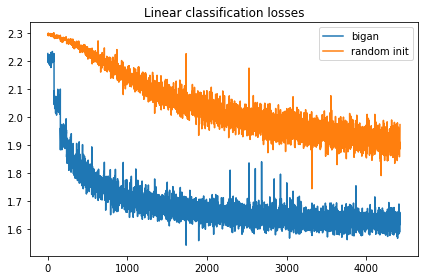

epoch:  56
BiGAN final linear classification loss: 1.6864385604858398
Random encoder linear classification loss: 1.9433056116104126
BiGAN final accuracy: 0.873318829113924
Random encoder accuracy: 0.6445806962025317


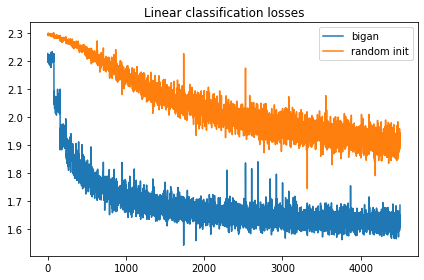

epoch:  57
BiGAN final linear classification loss: 1.6869621276855469
Random encoder linear classification loss: 1.9860700368881226
BiGAN final accuracy: 0.8711431962025317
Random encoder accuracy: 0.6462618670886076


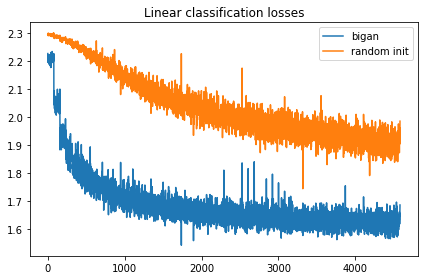

epoch:  58
BiGAN final linear classification loss: 1.7257024049758911
Random encoder linear classification loss: 1.966662883758545
BiGAN final accuracy: 0.8736155063291139
Random encoder accuracy: 0.6490308544303798


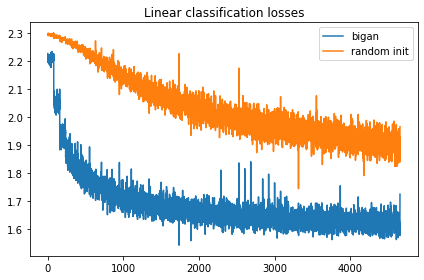

epoch:  59
BiGAN final linear classification loss: 1.7066943645477295
Random encoder linear classification loss: 1.9314340353012085
BiGAN final accuracy: 0.8762856012658228
Random encoder accuracy: 0.6521954113924051


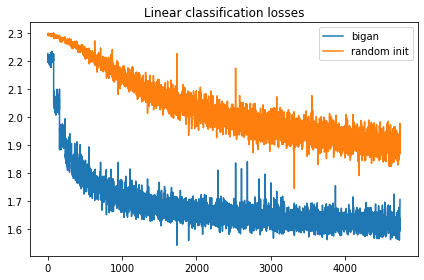

epoch:  60
BiGAN final linear classification loss: 1.6543819904327393
Random encoder linear classification loss: 1.8976414203643799
BiGAN final accuracy: 0.874307753164557
Random encoder accuracy: 0.6564477848101266


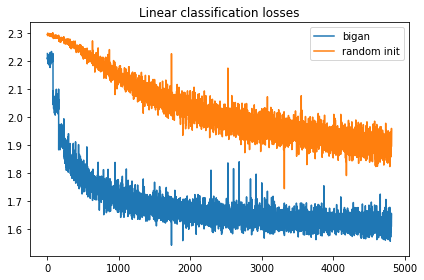

epoch:  61
BiGAN final linear classification loss: 1.6822465658187866
Random encoder linear classification loss: 1.90249502658844
BiGAN final accuracy: 0.8730221518987342
Random encoder accuracy: 0.6606012658227848


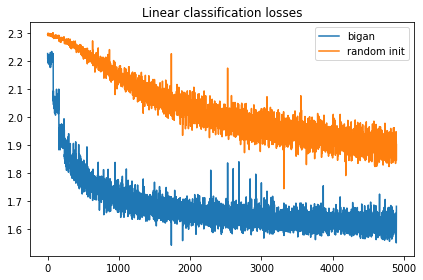

epoch:  62
BiGAN final linear classification loss: 1.6092097759246826
Random encoder linear classification loss: 1.8987677097320557
BiGAN final accuracy: 0.8774723101265823
Random encoder accuracy: 0.6617879746835443


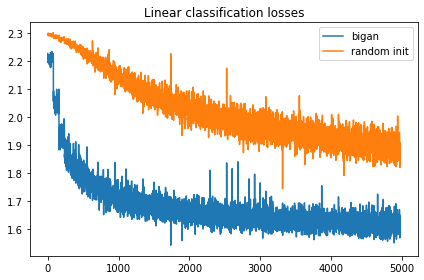

epoch:  63
BiGAN final linear classification loss: 1.7096507549285889
Random encoder linear classification loss: 1.899421215057373
BiGAN final accuracy: 0.8761867088607594
Random encoder accuracy: 0.6608979430379747


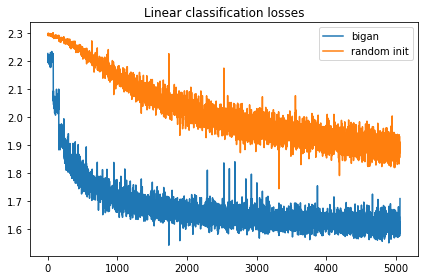

epoch:  64
BiGAN final linear classification loss: 1.693343997001648
Random encoder linear classification loss: 1.8485970497131348
BiGAN final accuracy: 0.8735166139240507
Random encoder accuracy: 0.6656447784810127


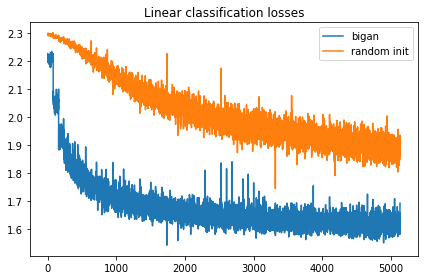

epoch:  65
BiGAN final linear classification loss: 1.6593058109283447
Random encoder linear classification loss: 1.8910986185073853
BiGAN final accuracy: 0.8741099683544303
Random encoder accuracy: 0.6677215189873418


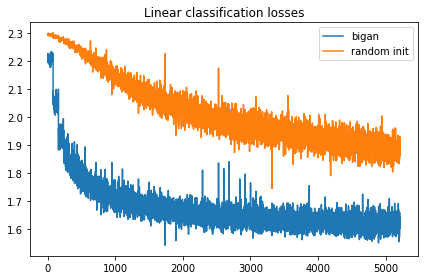

epoch:  66
BiGAN final linear classification loss: 1.830823302268982
Random encoder linear classification loss: 1.9282079935073853
BiGAN final accuracy: 0.8740110759493671
Random encoder accuracy: 0.668809335443038


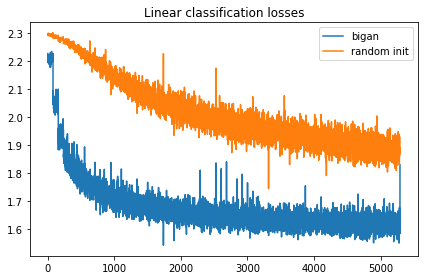

epoch:  67
BiGAN final linear classification loss: 1.7281850576400757
Random encoder linear classification loss: 1.9582194089889526
BiGAN final accuracy: 0.8771756329113924
Random encoder accuracy: 0.6719738924050633


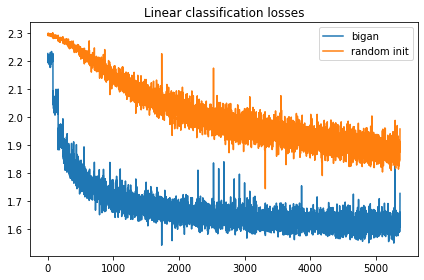

epoch:  68
BiGAN final linear classification loss: 1.53632390499115
Random encoder linear classification loss: 1.9330670833587646
BiGAN final accuracy: 0.8790545886075949
Random encoder accuracy: 0.6705893987341772


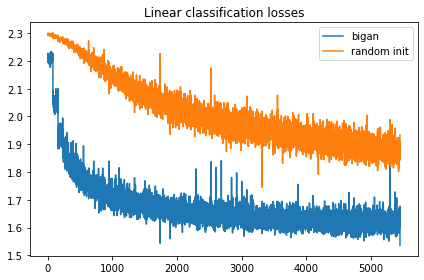

epoch:  69
BiGAN final linear classification loss: 1.6281728744506836
Random encoder linear classification loss: 1.9736120700836182
BiGAN final accuracy: 0.8747033227848101
Random encoder accuracy: 0.6728639240506329


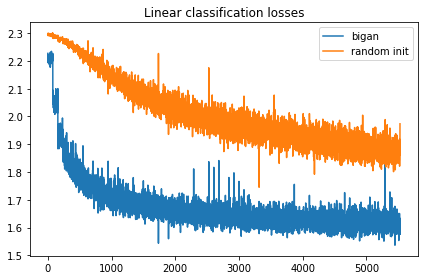

epoch:  70
BiGAN final linear classification loss: 1.7499865293502808
Random encoder linear classification loss: 1.8106218576431274
BiGAN final accuracy: 0.8760878164556962
Random encoder accuracy: 0.6776107594936709


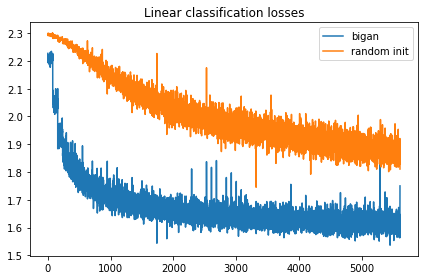

epoch:  71
BiGAN final linear classification loss: 1.6963549852371216
Random encoder linear classification loss: 1.907096028327942
BiGAN final accuracy: 0.8772745253164557
Random encoder accuracy: 0.6788963607594937


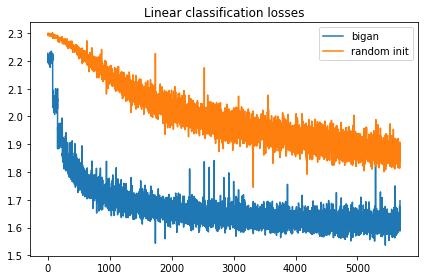

epoch:  72
BiGAN final linear classification loss: 1.941855788230896
Random encoder linear classification loss: 1.915931224822998
BiGAN final accuracy: 0.872626582278481
Random encoder accuracy: 0.6793908227848101


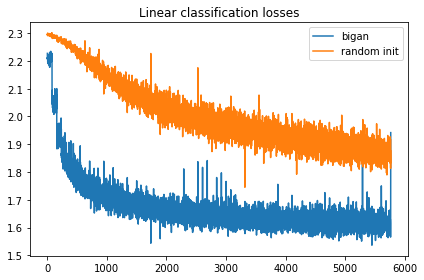

epoch:  73
BiGAN final linear classification loss: 1.5530304908752441
Random encoder linear classification loss: 1.9825087785720825
BiGAN final accuracy: 0.8775712025316456
Random encoder accuracy: 0.6798852848101266


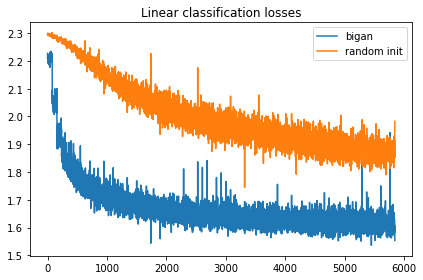

epoch:  74
BiGAN final linear classification loss: 1.7326983213424683
Random encoder linear classification loss: 1.7399113178253174
BiGAN final accuracy: 0.8772745253164557
Random encoder accuracy: 0.6873022151898734


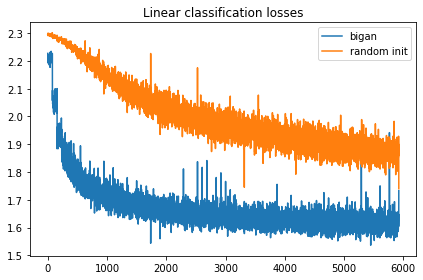

epoch:  75
BiGAN final linear classification loss: 1.6304492950439453
Random encoder linear classification loss: 1.9359718561172485
BiGAN final accuracy: 0.8759889240506329
Random encoder accuracy: 0.6852254746835443


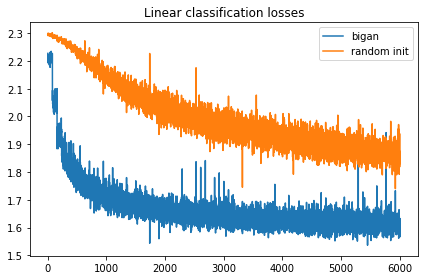

epoch:  76
BiGAN final linear classification loss: 1.668784499168396
Random encoder linear classification loss: 1.8472877740859985
BiGAN final accuracy: 0.8777689873417721
Random encoder accuracy: 0.684434335443038


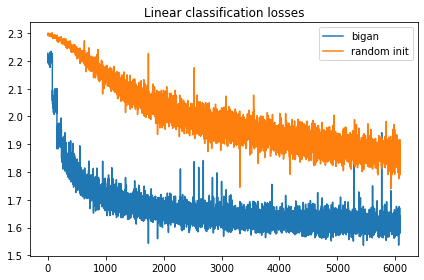

epoch:  77
BiGAN final linear classification loss: 1.6883679628372192
Random encoder linear classification loss: 1.8622069358825684
BiGAN final accuracy: 0.8796479430379747
Random encoder accuracy: 0.6911590189873418


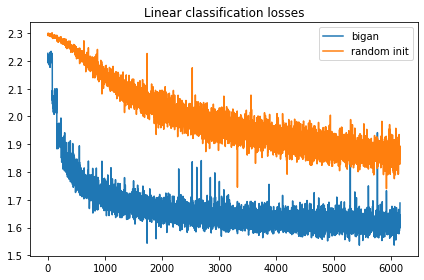

epoch:  78
BiGAN final linear classification loss: 1.5580426454544067
Random encoder linear classification loss: 2.0028700828552246
BiGAN final accuracy: 0.8789556962025317
Random encoder accuracy: 0.6869066455696202


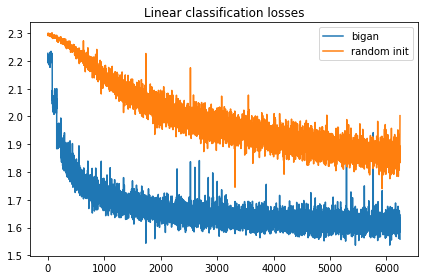

epoch:  79
BiGAN final linear classification loss: 1.628496527671814
Random encoder linear classification loss: 1.9467319250106812
BiGAN final accuracy: 0.8802412974683544
Random encoder accuracy: 0.6890822784810127


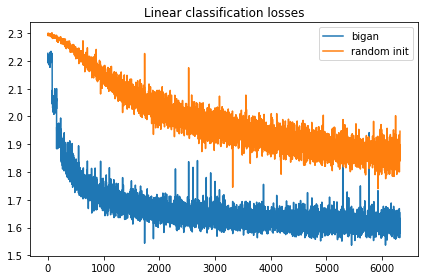

epoch:  80
BiGAN final linear classification loss: 1.6167402267456055
Random encoder linear classification loss: 1.8464698791503906
BiGAN final accuracy: 0.8777689873417721
Random encoder accuracy: 0.6914556962025317


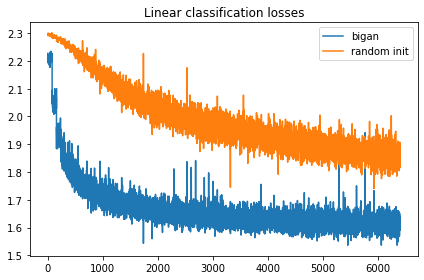

epoch:  81
BiGAN final linear classification loss: 1.5480693578720093
Random encoder linear classification loss: 1.857741355895996
BiGAN final accuracy: 0.8782634493670886
Random encoder accuracy: 0.6958069620253164


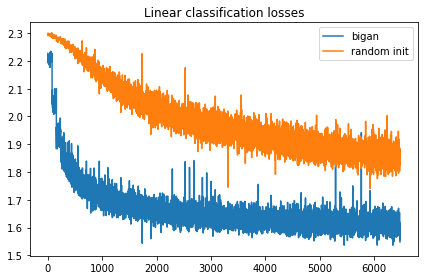

epoch:  82
BiGAN final linear classification loss: 1.5796979665756226
Random encoder linear classification loss: 1.8740595579147339
BiGAN final accuracy: 0.8792523734177216
Random encoder accuracy: 0.6942246835443038


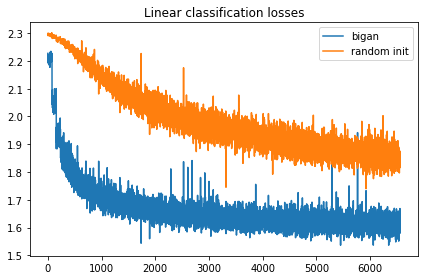

epoch:  83
BiGAN final linear classification loss: 1.594190239906311
Random encoder linear classification loss: 1.864958643913269
BiGAN final accuracy: 0.8783623417721519
Random encoder accuracy: 0.6938291139240507


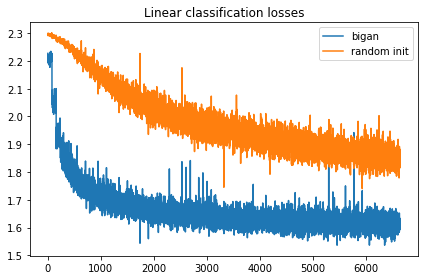

epoch:  84
BiGAN final linear classification loss: 1.5495234727859497
Random encoder linear classification loss: 1.8359919786453247
BiGAN final accuracy: 0.8819224683544303
Random encoder accuracy: 0.6995648734177216


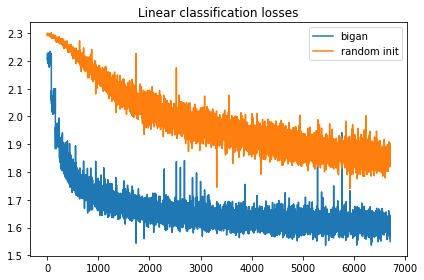

epoch:  85
BiGAN final linear classification loss: 1.5706713199615479
Random encoder linear classification loss: 1.7446441650390625
BiGAN final accuracy: 0.8782634493670886
Random encoder accuracy: 0.6974881329113924


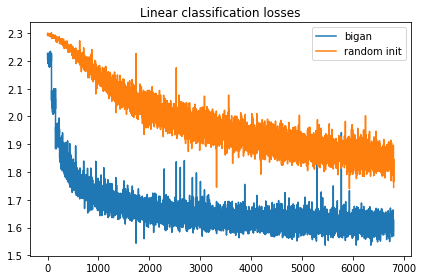

epoch:  86
BiGAN final linear classification loss: 1.6305655241012573
Random encoder linear classification loss: 1.953566074371338
BiGAN final accuracy: 0.8794501582278481
Random encoder accuracy: 0.6992681962025317


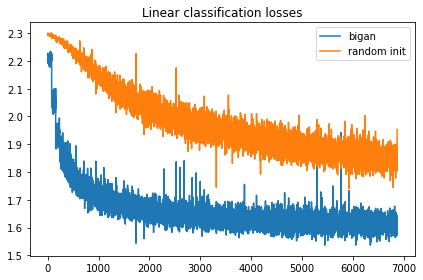

epoch:  87
BiGAN final linear classification loss: 1.7444605827331543
Random encoder linear classification loss: 1.8742921352386475
BiGAN final accuracy: 0.8765822784810127
Random encoder accuracy: 0.7004549050632911


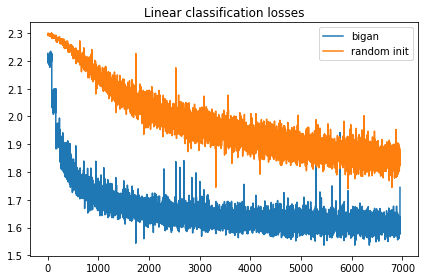

epoch:  88
BiGAN final linear classification loss: 1.6373441219329834
Random encoder linear classification loss: 1.8689684867858887
BiGAN final accuracy: 0.8825158227848101
Random encoder accuracy: 0.7006526898734177


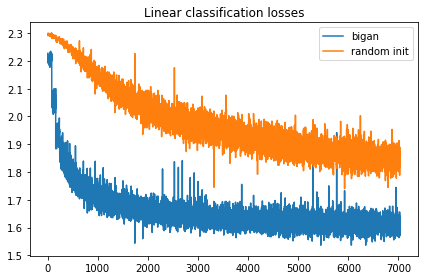

epoch:  89
BiGAN final linear classification loss: 1.7772902250289917
Random encoder linear classification loss: 2.0224485397338867
BiGAN final accuracy: 0.8796479430379747
Random encoder accuracy: 0.6996637658227848


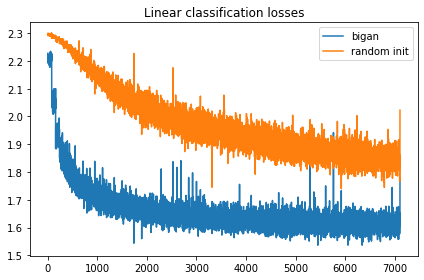

epoch:  90
BiGAN final linear classification loss: 1.5977158546447754
Random encoder linear classification loss: 1.8715522289276123
BiGAN final accuracy: 0.8827136075949367
Random encoder accuracy: 0.7032238924050633


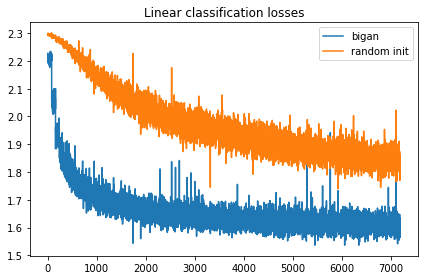

epoch:  91
BiGAN final linear classification loss: 1.5602467060089111
Random encoder linear classification loss: 1.8269833326339722
BiGAN final accuracy: 0.8820213607594937
Random encoder accuracy: 0.7093552215189873


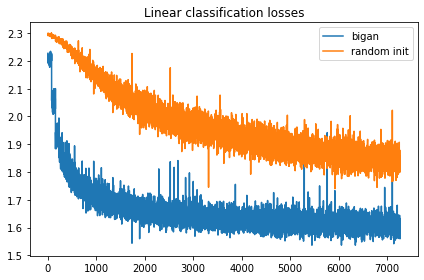

epoch:  92
BiGAN final linear classification loss: 1.5590299367904663
Random encoder linear classification loss: 1.6486799716949463
BiGAN final accuracy: 0.8818235759493671
Random encoder accuracy: 0.7117286392405063


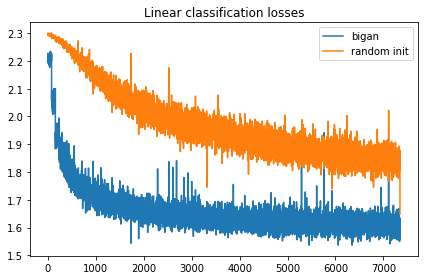

epoch:  93
BiGAN final linear classification loss: 1.5953943729400635
Random encoder linear classification loss: 1.8492927551269531
BiGAN final accuracy: 0.8814280063291139
Random encoder accuracy: 0.7070806962025317


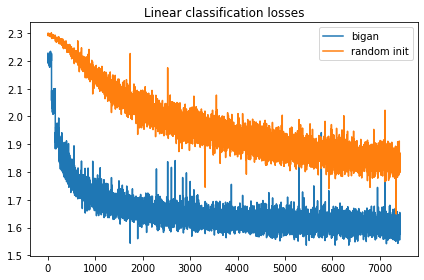

epoch:  94
BiGAN final linear classification loss: 1.510693073272705
Random encoder linear classification loss: 1.7224888801574707
BiGAN final accuracy: 0.8830102848101266
Random encoder accuracy: 0.7115308544303798


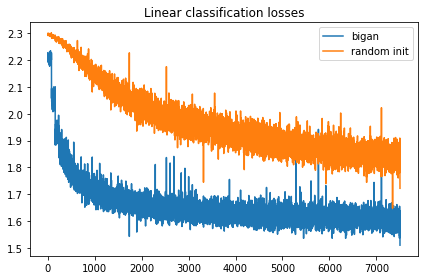

epoch:  95
BiGAN final linear classification loss: 1.6670252084732056
Random encoder linear classification loss: 1.9673240184783936
BiGAN final accuracy: 0.882120253164557
Random encoder accuracy: 0.7098496835443038


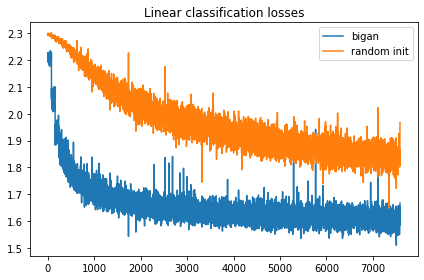

epoch:  96
BiGAN final linear classification loss: 1.8584576845169067
Random encoder linear classification loss: 1.845841884613037
BiGAN final accuracy: 0.8779667721518988
Random encoder accuracy: 0.7135087025316456


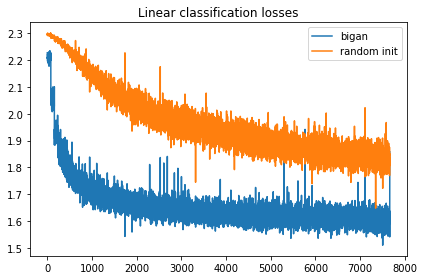

epoch:  97
BiGAN final linear classification loss: 1.6441758871078491
Random encoder linear classification loss: 1.7384724617004395
BiGAN final accuracy: 0.8834058544303798
Random encoder accuracy: 0.7150909810126582


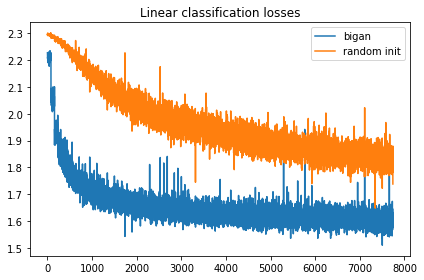

epoch:  98
BiGAN final linear classification loss: 1.6945440769195557
Random encoder linear classification loss: 1.9146881103515625
BiGAN final accuracy: 0.8777689873417721
Random encoder accuracy: 0.713310917721519


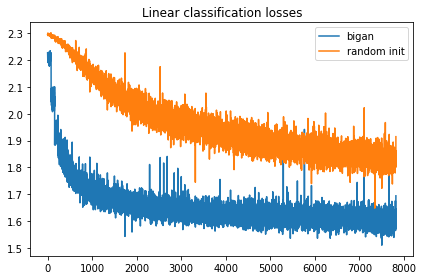

epoch:  99
BiGAN final linear classification loss: 1.6615753173828125
Random encoder linear classification loss: 1.980993628501892
BiGAN final accuracy: 0.8824169303797469
Random encoder accuracy: 0.7146954113924051


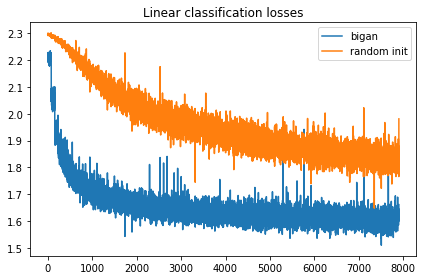

epoch:  100
BiGAN final linear classification loss: 1.6232988834381104
Random encoder linear classification loss: 1.8429583311080933
BiGAN final accuracy: 0.8848892405063291
Random encoder accuracy: 0.7177610759493671


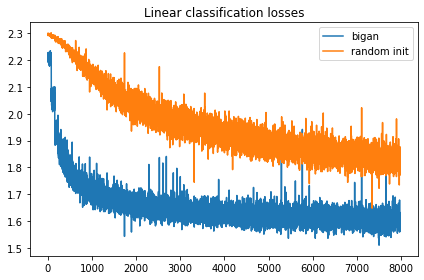

epoch:  101
BiGAN final linear classification loss: 1.5214347839355469
Random encoder linear classification loss: 1.7713637351989746
BiGAN final accuracy: 0.8839992088607594
Random encoder accuracy: 0.7174643987341772


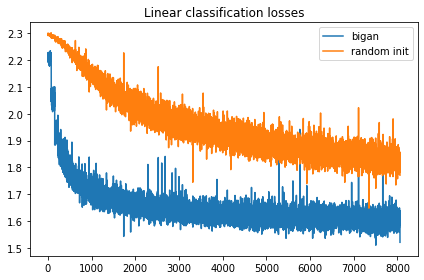

epoch:  102
BiGAN final linear classification loss: 1.5399514436721802
Random encoder linear classification loss: 1.974689245223999
BiGAN final accuracy: 0.8825158227848101
Random encoder accuracy: 0.7177610759493671


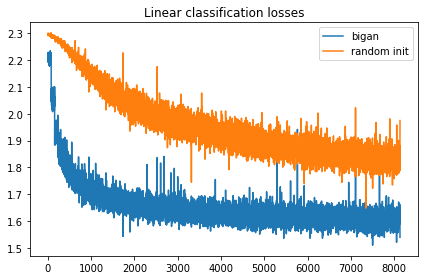

epoch:  103
BiGAN final linear classification loss: 1.5704444646835327
Random encoder linear classification loss: 1.733449101448059
BiGAN final accuracy: 0.8829113924050633
Random encoder accuracy: 0.721123417721519


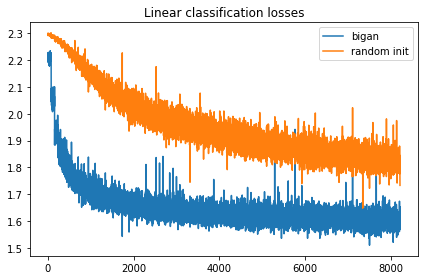

epoch:  104
BiGAN final linear classification loss: 1.6905500888824463
Random encoder linear classification loss: 1.7145795822143555
BiGAN final accuracy: 0.880439082278481
Random encoder accuracy: 0.7198378164556962


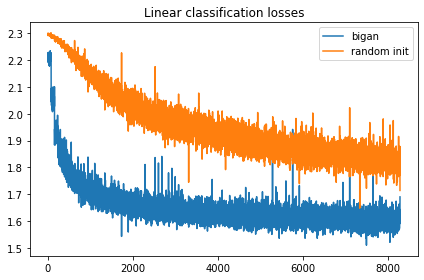

epoch:  105
BiGAN final linear classification loss: 1.7644250392913818
Random encoder linear classification loss: 1.7704349756240845
BiGAN final accuracy: 0.8800435126582279
Random encoder accuracy: 0.7214200949367089


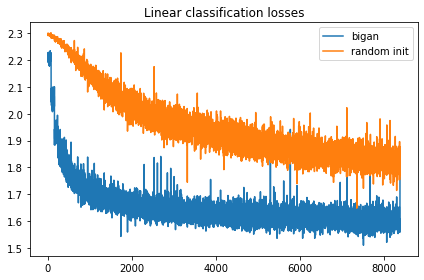

epoch:  106
BiGAN final linear classification loss: 1.6951615810394287
Random encoder linear classification loss: 1.756518840789795
BiGAN final accuracy: 0.8815268987341772
Random encoder accuracy: 0.7214200949367089


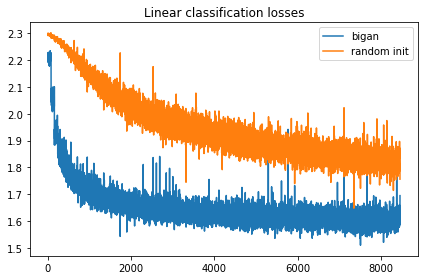

epoch:  107
BiGAN final linear classification loss: 1.78898286819458
Random encoder linear classification loss: 1.7969927787780762
BiGAN final accuracy: 0.879746835443038
Random encoder accuracy: 0.721815664556962


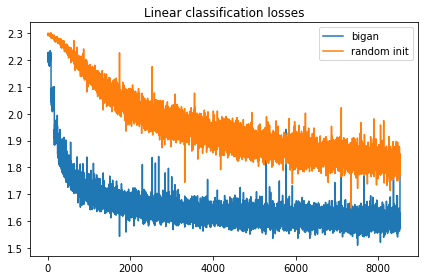

epoch:  108
BiGAN final linear classification loss: 1.545871376991272
Random encoder linear classification loss: 1.8525664806365967
BiGAN final accuracy: 0.8827136075949367
Random encoder accuracy: 0.7209256329113924


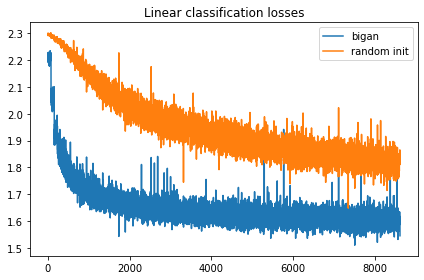

epoch:  109
BiGAN final linear classification loss: 1.717050313949585
Random encoder linear classification loss: 1.8501707315444946
BiGAN final accuracy: 0.8809335443037974
Random encoder accuracy: 0.7271558544303798


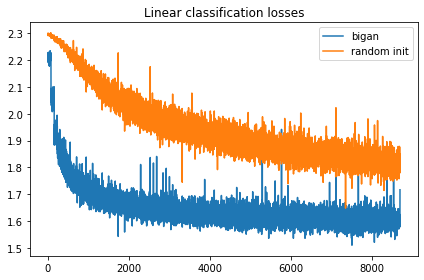

epoch:  110
BiGAN final linear classification loss: 1.7877750396728516
Random encoder linear classification loss: 1.8597166538238525
BiGAN final accuracy: 0.8808346518987342
Random encoder accuracy: 0.724189082278481


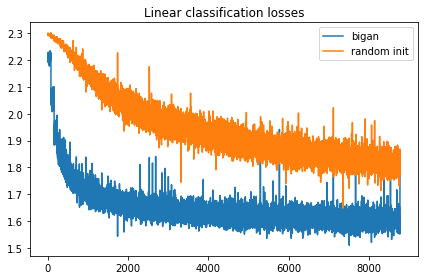

epoch:  111
BiGAN final linear classification loss: 1.5836641788482666
Random encoder linear classification loss: 1.7117997407913208
BiGAN final accuracy: 0.8833069620253164
Random encoder accuracy: 0.7290348101265823


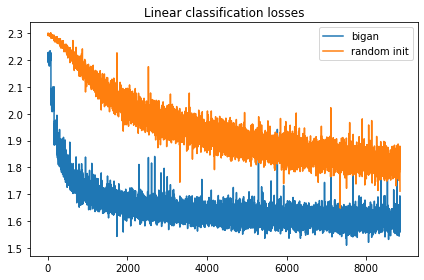

epoch:  112
BiGAN final linear classification loss: 1.7199760675430298
Random encoder linear classification loss: 1.8063440322875977
BiGAN final accuracy: 0.8834058544303798
Random encoder accuracy: 0.7269580696202531


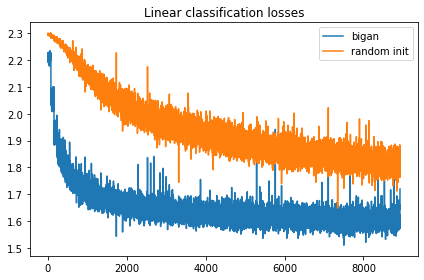

epoch:  113
BiGAN final linear classification loss: 1.6152881383895874
Random encoder linear classification loss: 1.6908960342407227
BiGAN final accuracy: 0.8831091772151899
Random encoder accuracy: 0.7329905063291139


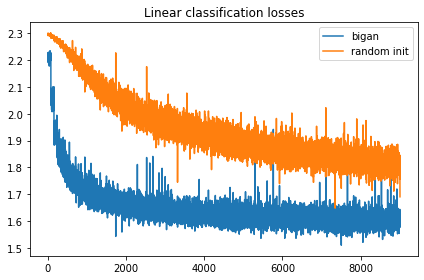

epoch:  114
BiGAN final linear classification loss: 1.6282281875610352
Random encoder linear classification loss: 1.8633897304534912
BiGAN final accuracy: 0.8819224683544303
Random encoder accuracy: 0.7277492088607594


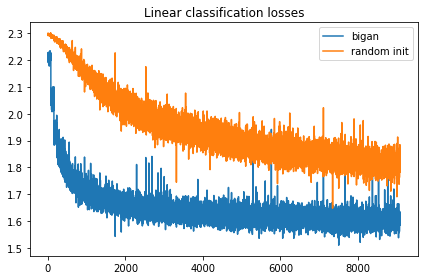

epoch:  115
BiGAN final linear classification loss: 1.6867924928665161
Random encoder linear classification loss: 1.9048044681549072
BiGAN final accuracy: 0.8819224683544303
Random encoder accuracy: 0.7268591772151899


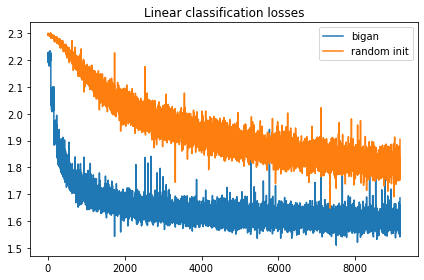

epoch:  116
BiGAN final linear classification loss: 1.7104684114456177
Random encoder linear classification loss: 2.050450086593628
BiGAN final accuracy: 0.8818235759493671
Random encoder accuracy: 0.7269580696202531


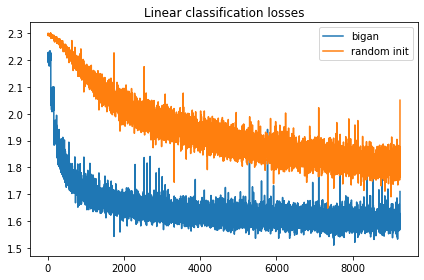

epoch:  117
BiGAN final linear classification loss: 1.6638234853744507
Random encoder linear classification loss: 1.840404748916626
BiGAN final accuracy: 0.882120253164557
Random encoder accuracy: 0.7317049050632911


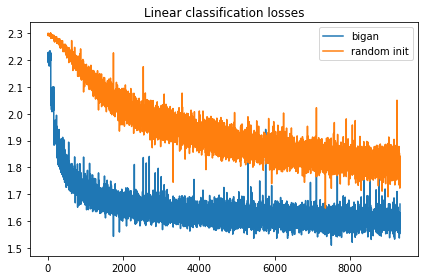

epoch:  118
BiGAN final linear classification loss: 1.5656626224517822
Random encoder linear classification loss: 1.945962905883789
BiGAN final accuracy: 0.8824169303797469
Random encoder accuracy: 0.7293314873417721


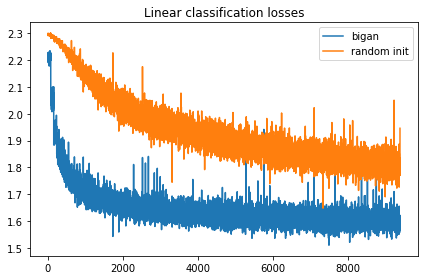

epoch:  119
BiGAN final linear classification loss: 1.6244350671768188
Random encoder linear classification loss: 1.9044263362884521
BiGAN final accuracy: 0.8834058544303798
Random encoder accuracy: 0.7290348101265823


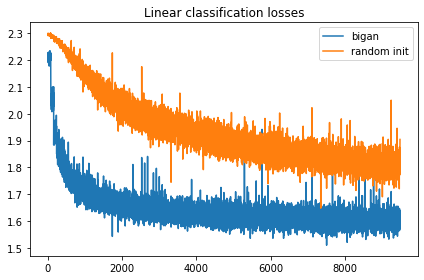

epoch:  120
BiGAN final linear classification loss: 1.7990567684173584
Random encoder linear classification loss: 1.7421770095825195
BiGAN final accuracy: 0.8812302215189873
Random encoder accuracy: 0.7342761075949367


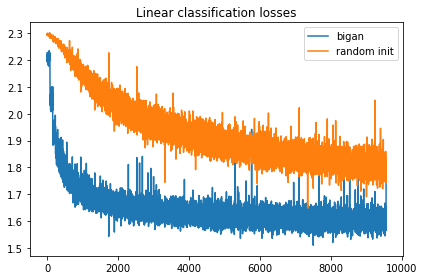

epoch:  121
BiGAN final linear classification loss: 1.8237603902816772
Random encoder linear classification loss: 1.9570791721343994
BiGAN final accuracy: 0.8803401898734177
Random encoder accuracy: 0.7301226265822784


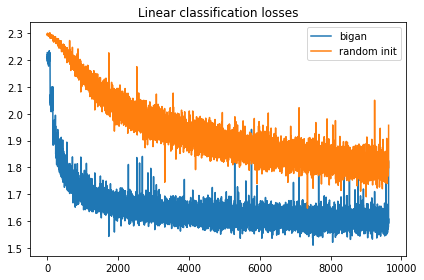

epoch:  122
BiGAN final linear classification loss: 1.5777790546417236
Random encoder linear classification loss: 1.6740319728851318
BiGAN final accuracy: 0.8855814873417721
Random encoder accuracy: 0.7338805379746836


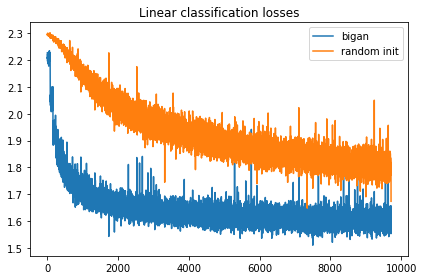

epoch:  123
BiGAN final linear classification loss: 1.572851300239563
Random encoder linear classification loss: 1.7117581367492676
BiGAN final accuracy: 0.8836036392405063
Random encoder accuracy: 0.7338805379746836


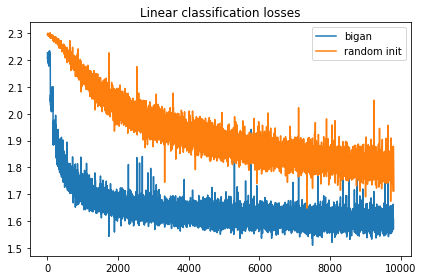

epoch:  124
BiGAN final linear classification loss: 1.5328116416931152
Random encoder linear classification loss: 1.7810416221618652
BiGAN final accuracy: 0.8863726265822784
Random encoder accuracy: 0.7348694620253164


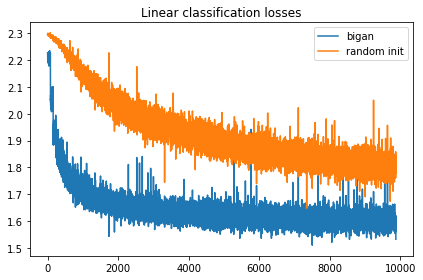

epoch:  125
BiGAN final linear classification loss: 1.7240312099456787
Random encoder linear classification loss: 1.8150402307510376
BiGAN final accuracy: 0.8830102848101266
Random encoder accuracy: 0.7382318037974683


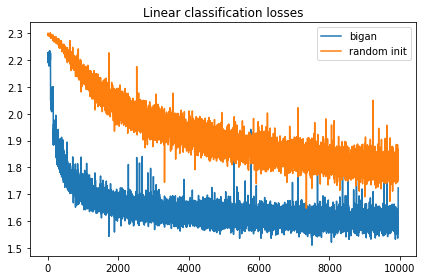

epoch:  126
BiGAN final linear classification loss: 1.6597968339920044
Random encoder linear classification loss: 1.7919460535049438
BiGAN final accuracy: 0.8853837025316456
Random encoder accuracy: 0.7369462025316456


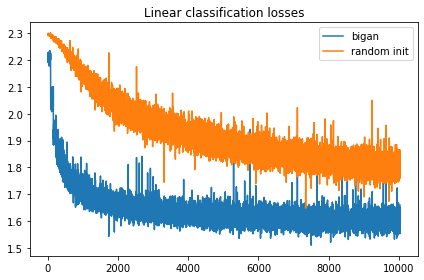

epoch:  127
BiGAN final linear classification loss: 1.5707595348358154
Random encoder linear classification loss: 1.8038252592086792
BiGAN final accuracy: 0.8850870253164557
Random encoder accuracy: 0.7358583860759493


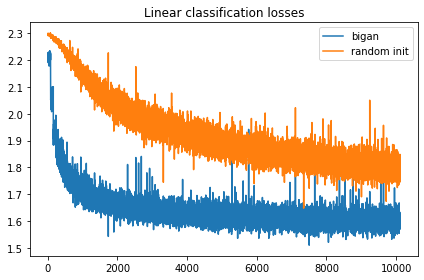

epoch:  128
BiGAN final linear classification loss: 1.7231879234313965
Random encoder linear classification loss: 2.0344653129577637
BiGAN final accuracy: 0.8824169303797469
Random encoder accuracy: 0.7345727848101266


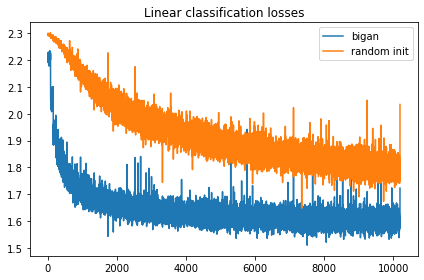

epoch:  129
BiGAN final linear classification loss: 1.5775362253189087
Random encoder linear classification loss: 1.9207556247711182
BiGAN final accuracy: 0.8847903481012658
Random encoder accuracy: 0.736056170886076


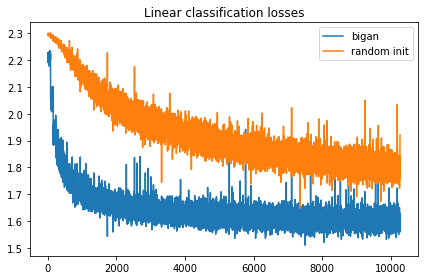

epoch:  130
BiGAN final linear classification loss: 1.5823193788528442
Random encoder linear classification loss: 1.8603782653808594
BiGAN final accuracy: 0.885878164556962
Random encoder accuracy: 0.7413963607594937


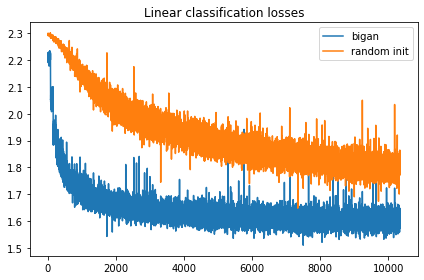

epoch:  131
BiGAN final linear classification loss: 1.5729117393493652
Random encoder linear classification loss: 1.7831192016601562
BiGAN final accuracy: 0.8857792721518988
Random encoder accuracy: 0.7393196202531646


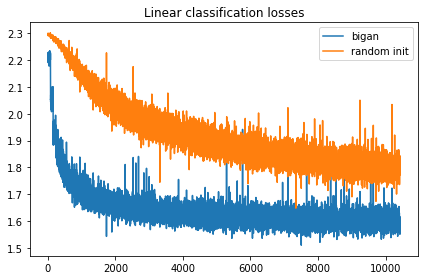

epoch:  132
BiGAN final linear classification loss: 1.616310477256775
Random encoder linear classification loss: 1.6982126235961914
BiGAN final accuracy: 0.8856803797468354
Random encoder accuracy: 0.7411985759493671


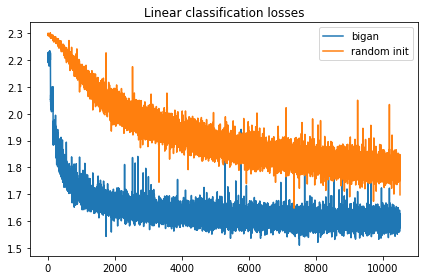

epoch:  133
BiGAN final linear classification loss: 1.5835803747177124
Random encoder linear classification loss: 1.8615751266479492
BiGAN final accuracy: 0.8860759493670886
Random encoder accuracy: 0.7372428797468354


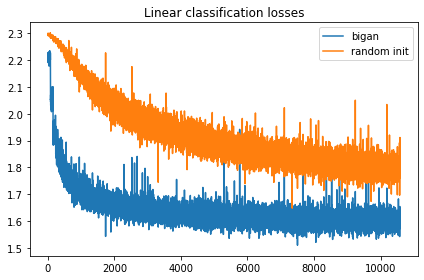

epoch:  134
BiGAN final linear classification loss: 1.580836534500122
Random encoder linear classification loss: 1.7339513301849365
BiGAN final accuracy: 0.8856803797468354
Random encoder accuracy: 0.7408030063291139


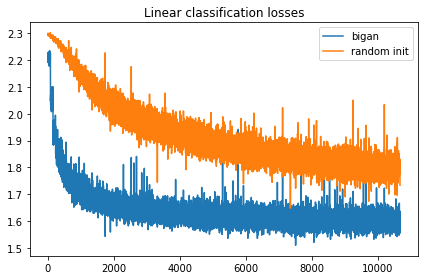

epoch:  135
BiGAN final linear classification loss: 1.5555477142333984
Random encoder linear classification loss: 1.7543457746505737
BiGAN final accuracy: 0.8836036392405063
Random encoder accuracy: 0.7444620253164557


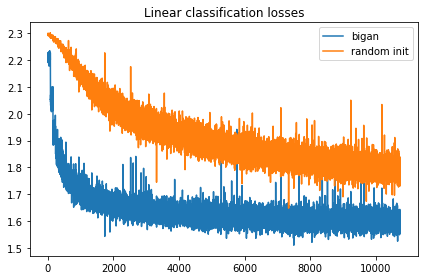

epoch:  136
BiGAN final linear classification loss: 1.5411171913146973
Random encoder linear classification loss: 1.793189287185669
BiGAN final accuracy: 0.8871637658227848
Random encoder accuracy: 0.7422863924050633


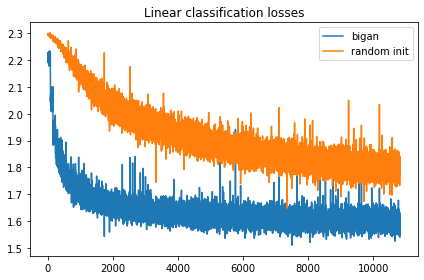

epoch:  137
BiGAN final linear classification loss: 1.6642428636550903
Random encoder linear classification loss: 1.6930880546569824
BiGAN final accuracy: 0.8857792721518988
Random encoder accuracy: 0.7439675632911392


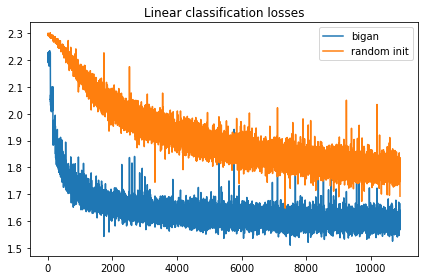

epoch:  138
BiGAN final linear classification loss: 1.5823240280151367
Random encoder linear classification loss: 1.8797434568405151
BiGAN final accuracy: 0.8872626582278481
Random encoder accuracy: 0.7418908227848101


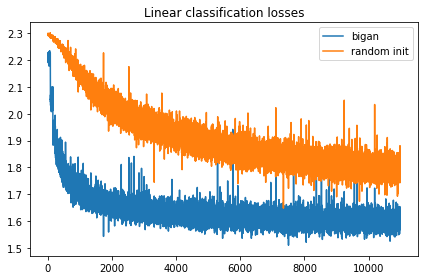

epoch:  139
BiGAN final linear classification loss: 1.661714792251587
Random encoder linear classification loss: 1.862125277519226
BiGAN final accuracy: 0.8839992088607594
Random encoder accuracy: 0.741495253164557


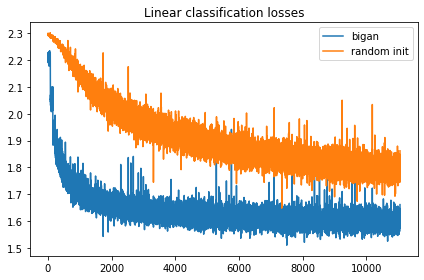

epoch:  140
BiGAN final linear classification loss: 1.540806531906128
Random encoder linear classification loss: 1.8863698244094849
BiGAN final accuracy: 0.8869659810126582
Random encoder accuracy: 0.7404074367088608


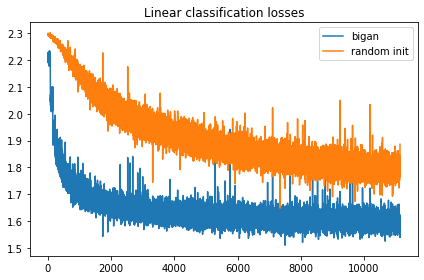

epoch:  141
BiGAN final linear classification loss: 1.5896563529968262
Random encoder linear classification loss: 1.6879150867462158
BiGAN final accuracy: 0.8863726265822784
Random encoder accuracy: 0.7430775316455697


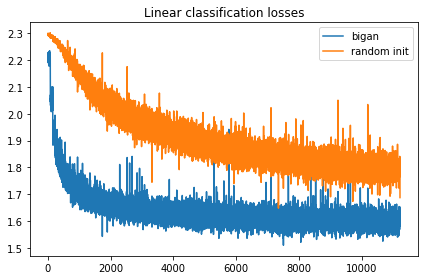

epoch:  142
BiGAN final linear classification loss: 1.613738775253296
Random encoder linear classification loss: 2.0890371799468994
BiGAN final accuracy: 0.8852848101265823
Random encoder accuracy: 0.7411985759493671


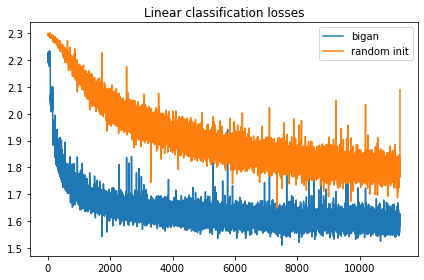

epoch:  143
BiGAN final linear classification loss: 1.5581858158111572
Random encoder linear classification loss: 1.752687931060791
BiGAN final accuracy: 0.8870648734177216
Random encoder accuracy: 0.7473299050632911


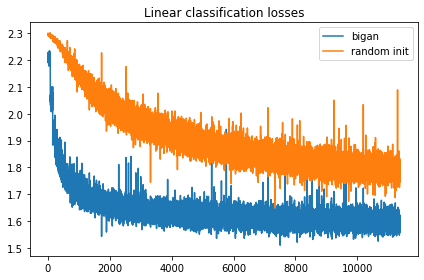

epoch:  144
BiGAN final linear classification loss: 1.5120166540145874
Random encoder linear classification loss: 1.7645165920257568
BiGAN final accuracy: 0.8865704113924051
Random encoder accuracy: 0.7448575949367089


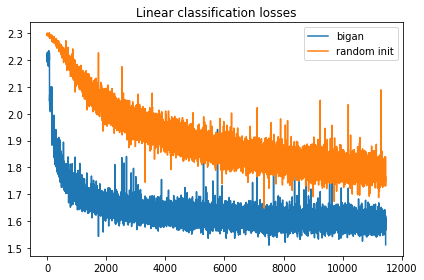

epoch:  145
BiGAN final linear classification loss: 1.4999682903289795
Random encoder linear classification loss: 2.0417938232421875
BiGAN final accuracy: 0.8876582278481012
Random encoder accuracy: 0.7400118670886076


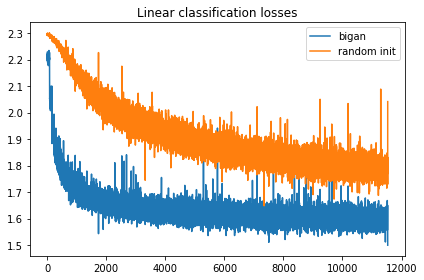

epoch:  146
BiGAN final linear classification loss: 1.6440355777740479
Random encoder linear classification loss: 1.7976644039154053
BiGAN final accuracy: 0.8869659810126582
Random encoder accuracy: 0.7449564873417721


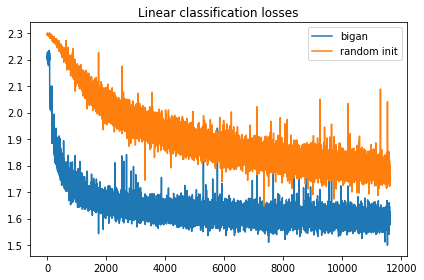

epoch:  147
BiGAN final linear classification loss: 1.7159709930419922
Random encoder linear classification loss: 1.8475672006607056
BiGAN final accuracy: 0.8871637658227848
Random encoder accuracy: 0.7425830696202531


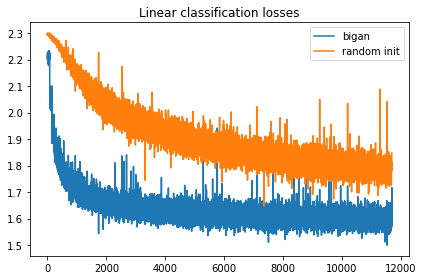

epoch:  148
BiGAN final linear classification loss: 1.4913941621780396
Random encoder linear classification loss: 1.6632599830627441
BiGAN final accuracy: 0.8907238924050633
Random encoder accuracy: 0.7479232594936709


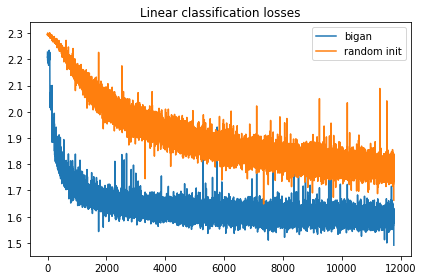

epoch:  149
BiGAN final linear classification loss: 1.6852625608444214
Random encoder linear classification loss: 1.8144011497497559
BiGAN final accuracy: 0.885185917721519
Random encoder accuracy: 0.744560917721519


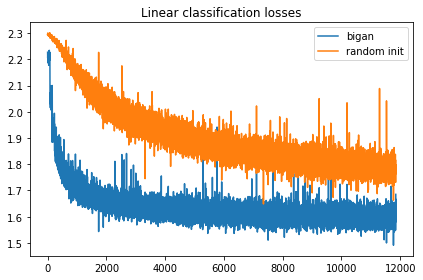

epoch:  150
BiGAN final linear classification loss: 1.559816837310791
Random encoder linear classification loss: 1.8519026041030884
BiGAN final accuracy: 0.8850870253164557
Random encoder accuracy: 0.7472310126582279


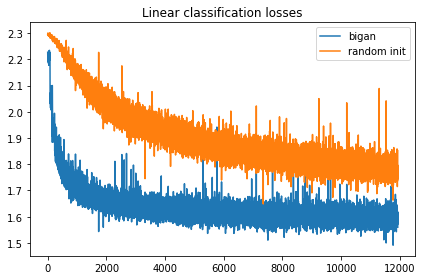

epoch:  151
BiGAN final linear classification loss: 1.601538062095642
Random encoder linear classification loss: 1.85640287399292
BiGAN final accuracy: 0.8881526898734177
Random encoder accuracy: 0.7461431962025317


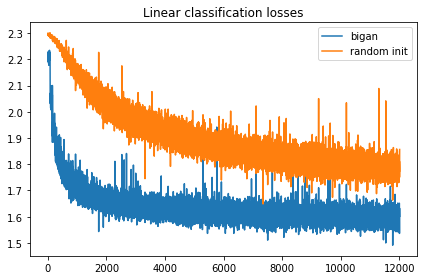

epoch:  152
BiGAN final linear classification loss: 1.5826665163040161
Random encoder linear classification loss: 1.7406013011932373
BiGAN final accuracy: 0.8876582278481012
Random encoder accuracy: 0.7459454113924051


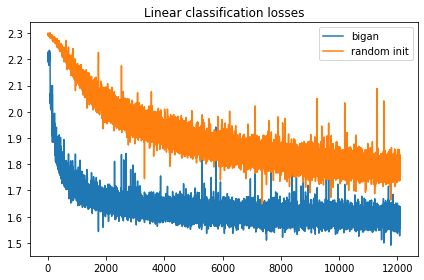

epoch:  153
BiGAN final linear classification loss: 1.6915029287338257
Random encoder linear classification loss: 1.6258716583251953
BiGAN final accuracy: 0.8876582278481012
Random encoder accuracy: 0.7475276898734177


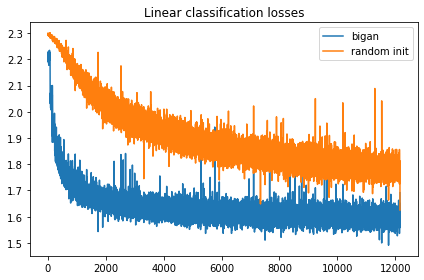

epoch:  154
BiGAN final linear classification loss: 1.5924967527389526
Random encoder linear classification loss: 1.7790486812591553
BiGAN final accuracy: 0.8870648734177216
Random encoder accuracy: 0.746934335443038


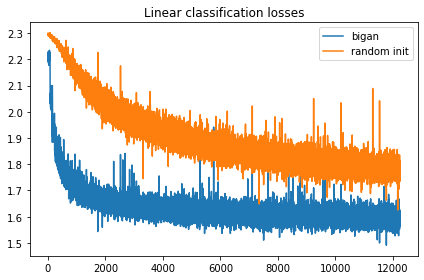

epoch:  155
BiGAN final linear classification loss: 1.7147163152694702
Random encoder linear classification loss: 1.8324270248413086
BiGAN final accuracy: 0.8859770569620253
Random encoder accuracy: 0.7463409810126582


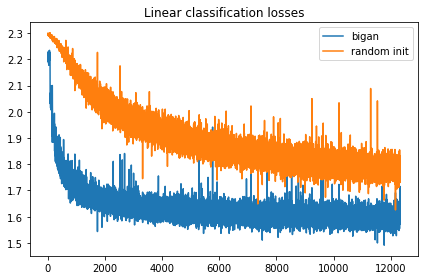

epoch:  156
BiGAN final linear classification loss: 1.5946815013885498
Random encoder linear classification loss: 1.7621119022369385
BiGAN final accuracy: 0.8865704113924051
Random encoder accuracy: 0.7482199367088608


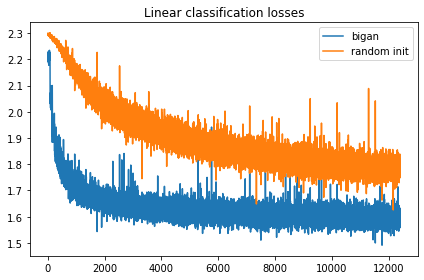

epoch:  157
BiGAN final linear classification loss: 1.7237191200256348
Random encoder linear classification loss: 1.7937270402908325
BiGAN final accuracy: 0.8857792721518988
Random encoder accuracy: 0.745253164556962


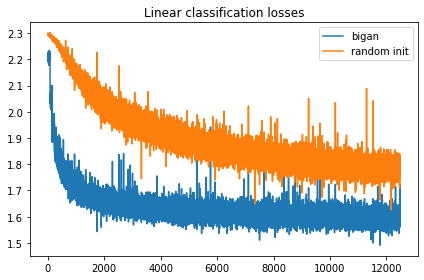

epoch:  158
BiGAN final linear classification loss: 1.688916563987732
Random encoder linear classification loss: 1.813463807106018
BiGAN final accuracy: 0.8862737341772152
Random encoder accuracy: 0.7473299050632911


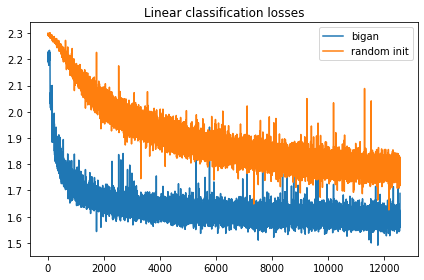

epoch:  159
BiGAN final linear classification loss: 1.7976549863815308
Random encoder linear classification loss: 1.7287808656692505
BiGAN final accuracy: 0.8847903481012658
Random encoder accuracy: 0.7508900316455697


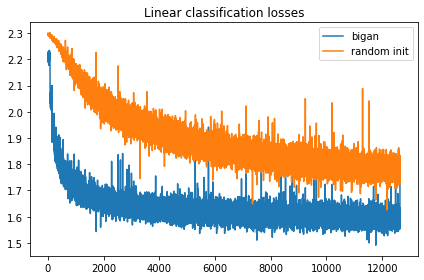

epoch:  160
BiGAN final linear classification loss: 1.683017611503601
Random encoder linear classification loss: 1.932431697845459
BiGAN final accuracy: 0.8860759493670886
Random encoder accuracy: 0.7509889240506329


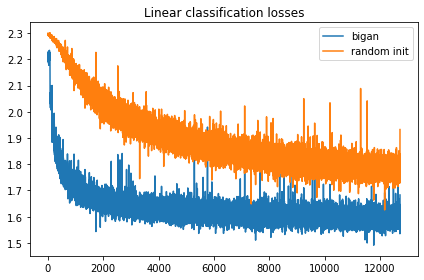

epoch:  161
BiGAN final linear classification loss: 1.6798665523529053
Random encoder linear classification loss: 1.8782663345336914
BiGAN final accuracy: 0.8864715189873418
Random encoder accuracy: 0.7521756329113924


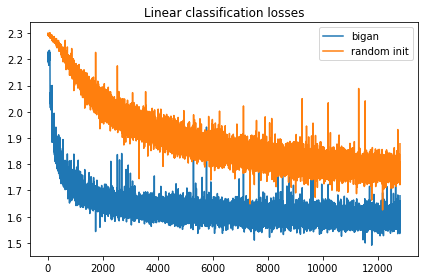

epoch:  162
BiGAN final linear classification loss: 1.7454262971878052
Random encoder linear classification loss: 1.7269080877304077
BiGAN final accuracy: 0.8843947784810127
Random encoder accuracy: 0.7497033227848101


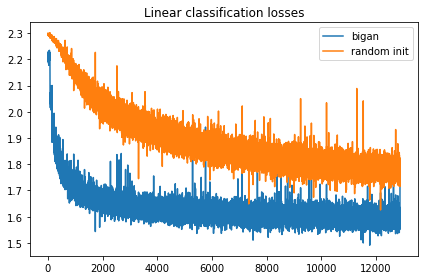

epoch:  163
BiGAN final linear classification loss: 1.7843595743179321
Random encoder linear classification loss: 1.8532487154006958
BiGAN final accuracy: 0.8878560126582279
Random encoder accuracy: 0.7481210443037974


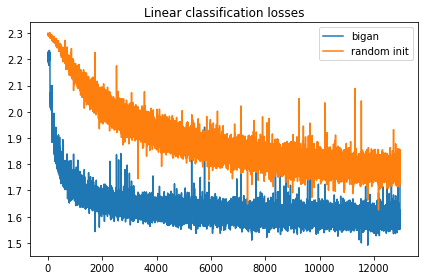

epoch:  164
BiGAN final linear classification loss: 1.6063429117202759
Random encoder linear classification loss: 1.7892260551452637
BiGAN final accuracy: 0.8891416139240507
Random encoder accuracy: 0.7526700949367089


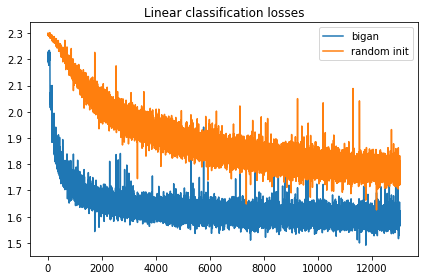

epoch:  165
BiGAN final linear classification loss: 1.783507227897644
Random encoder linear classification loss: 1.8799747228622437
BiGAN final accuracy: 0.8850870253164557
Random encoder accuracy: 0.7473299050632911


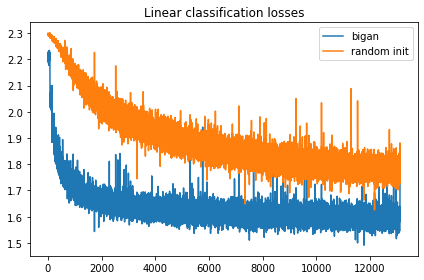

epoch:  166
BiGAN final linear classification loss: 1.7672882080078125
Random encoder linear classification loss: 1.893730878829956
BiGAN final accuracy: 0.8856803797468354
Random encoder accuracy: 0.7513844936708861


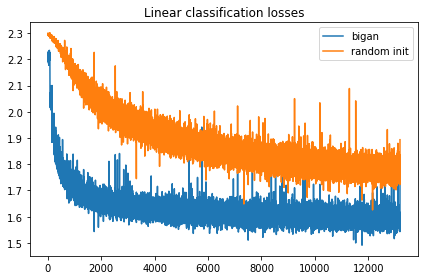

epoch:  167
BiGAN final linear classification loss: 1.625786542892456
Random encoder linear classification loss: 1.9707835912704468
BiGAN final accuracy: 0.8894382911392406
Random encoder accuracy: 0.7497033227848101


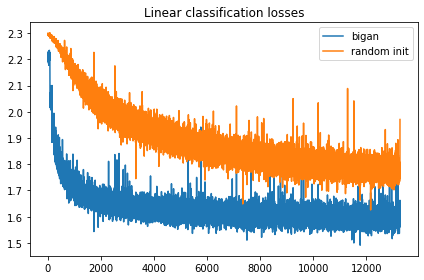

epoch:  168
BiGAN final linear classification loss: 1.7540509700775146
Random encoder linear classification loss: 1.6507389545440674
BiGAN final accuracy: 0.8867681962025317
Random encoder accuracy: 0.7509889240506329


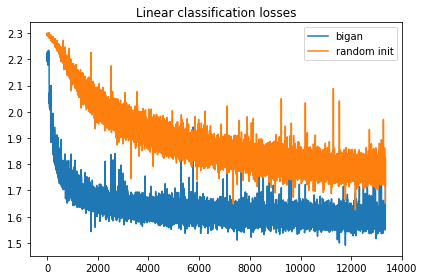

epoch:  169
BiGAN final linear classification loss: 1.6079190969467163
Random encoder linear classification loss: 1.9246248006820679
BiGAN final accuracy: 0.8877571202531646
Random encoder accuracy: 0.7511867088607594


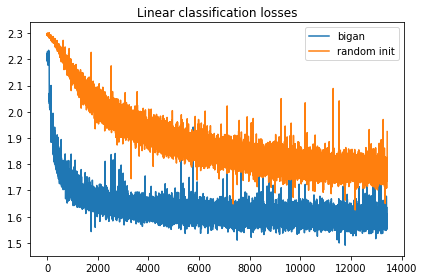

epoch:  170
BiGAN final linear classification loss: 1.6313804388046265
Random encoder linear classification loss: 1.9366281032562256
BiGAN final accuracy: 0.8877571202531646
Random encoder accuracy: 0.747626582278481


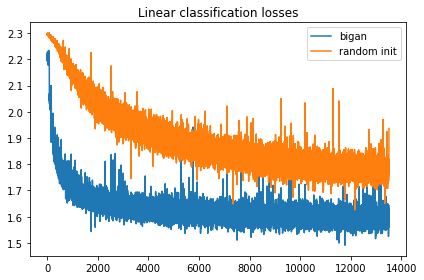

epoch:  171
BiGAN final linear classification loss: 1.5357252359390259
Random encoder linear classification loss: 1.8498330116271973
BiGAN final accuracy: 0.8878560126582279
Random encoder accuracy: 0.7508900316455697


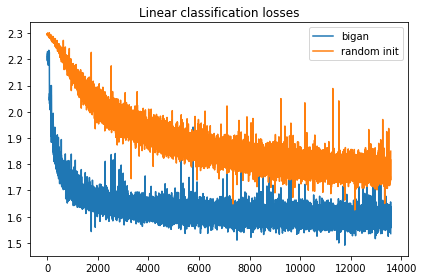

epoch:  172
BiGAN final linear classification loss: 1.657299518585205
Random encoder linear classification loss: 1.7743796110153198
BiGAN final accuracy: 0.8864715189873418
Random encoder accuracy: 0.7534612341772152


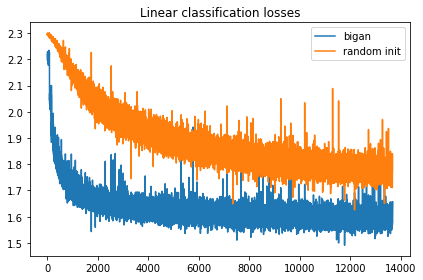

epoch:  173
BiGAN final linear classification loss: 1.727795124053955
Random encoder linear classification loss: 1.9419959783554077
BiGAN final accuracy: 0.8852848101265823
Random encoder accuracy: 0.7521756329113924


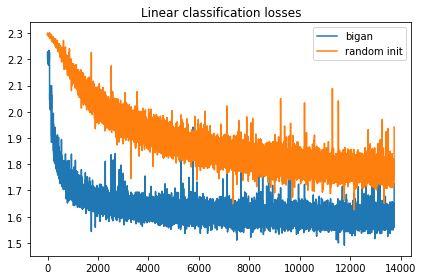

epoch:  174
BiGAN final linear classification loss: 1.6465249061584473
Random encoder linear classification loss: 1.7336540222167969
BiGAN final accuracy: 0.8871637658227848
Random encoder accuracy: 0.7546479430379747


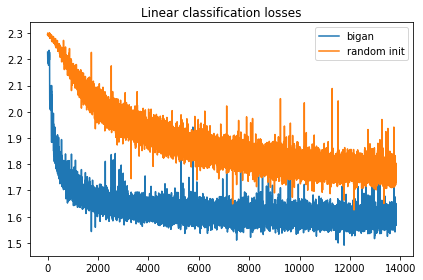

epoch:  175
BiGAN final linear classification loss: 1.7553128004074097
Random encoder linear classification loss: 1.8327240943908691
BiGAN final accuracy: 0.8865704113924051
Random encoder accuracy: 0.7545490506329114


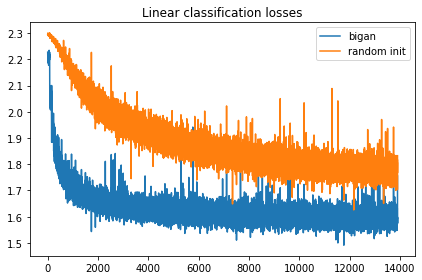

epoch:  176
BiGAN final linear classification loss: 1.5705127716064453
Random encoder linear classification loss: 1.6396205425262451
BiGAN final accuracy: 0.8908227848101266
Random encoder accuracy: 0.7549446202531646


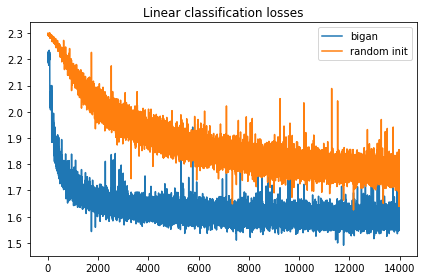

epoch:  177
BiGAN final linear classification loss: 1.6467547416687012
Random encoder linear classification loss: 1.8164598941802979
BiGAN final accuracy: 0.8893393987341772
Random encoder accuracy: 0.7536590189873418


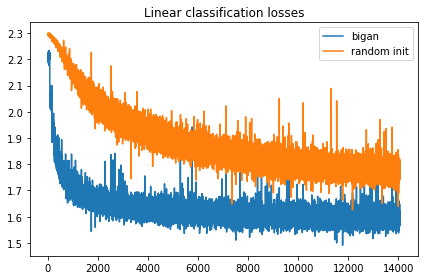

epoch:  178
BiGAN final linear classification loss: 1.66180419921875
Random encoder linear classification loss: 1.7579731941223145
BiGAN final accuracy: 0.8871637658227848
Random encoder accuracy: 0.7558346518987342


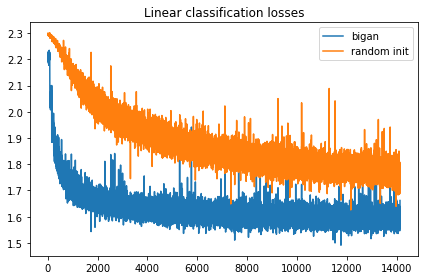

epoch:  179
BiGAN final linear classification loss: 1.6921719312667847
Random encoder linear classification loss: 1.7420265674591064
BiGAN final accuracy: 0.8879549050632911
Random encoder accuracy: 0.7552412974683544


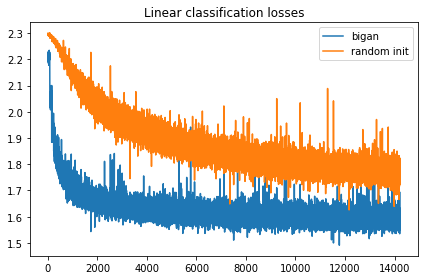

epoch:  180
BiGAN final linear classification loss: 1.7073973417282104
Random encoder linear classification loss: 1.7454824447631836
BiGAN final accuracy: 0.887559335443038
Random encoder accuracy: 0.7563291139240507


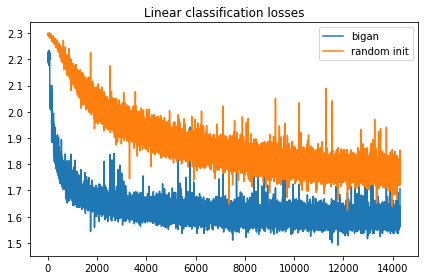

epoch:  181
BiGAN final linear classification loss: 1.637319564819336
Random encoder linear classification loss: 1.7834174633026123
BiGAN final accuracy: 0.8881526898734177
Random encoder accuracy: 0.752373417721519


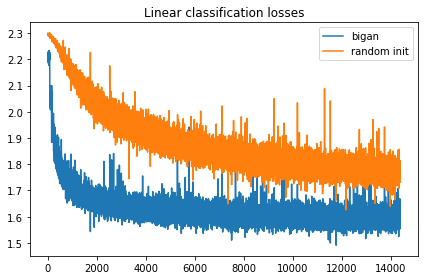

epoch:  182
BiGAN final linear classification loss: 1.7243188619613647
Random encoder linear classification loss: 1.7631864547729492
BiGAN final accuracy: 0.8863726265822784
Random encoder accuracy: 0.7579113924050633


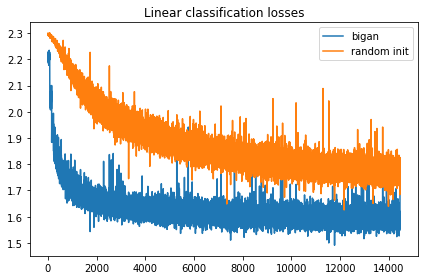

epoch:  183
BiGAN final linear classification loss: 1.5702205896377563
Random encoder linear classification loss: 1.7778902053833008
BiGAN final accuracy: 0.8900316455696202
Random encoder accuracy: 0.7572191455696202


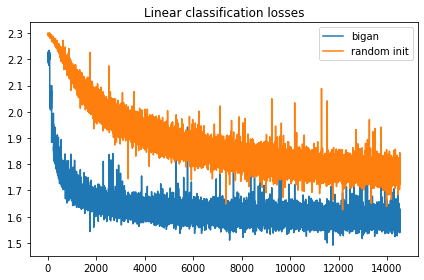

epoch:  184
BiGAN final linear classification loss: 1.5772104263305664
Random encoder linear classification loss: 1.7260843515396118
BiGAN final accuracy: 0.8891416139240507
Random encoder accuracy: 0.7569224683544303


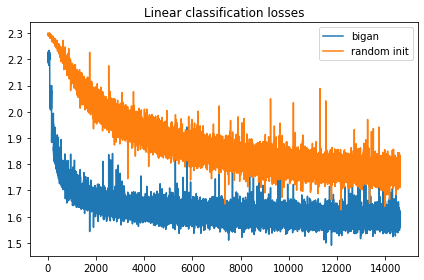

epoch:  185
BiGAN final linear classification loss: 1.5919581651687622
Random encoder linear classification loss: 1.846911907196045
BiGAN final accuracy: 0.8893393987341772
Random encoder accuracy: 0.752373417721519


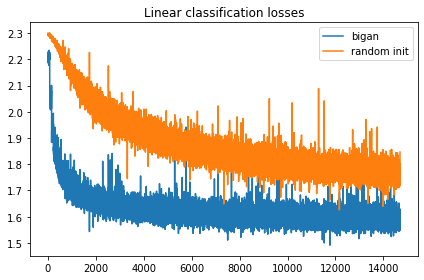

epoch:  186
BiGAN final linear classification loss: 1.5462102890014648
Random encoder linear classification loss: 1.7840839624404907
BiGAN final accuracy: 0.8904272151898734
Random encoder accuracy: 0.7558346518987342


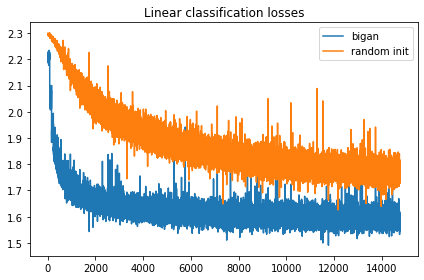

epoch:  187
BiGAN final linear classification loss: 1.7282596826553345
Random encoder linear classification loss: 1.7186014652252197
BiGAN final accuracy: 0.8854825949367089
Random encoder accuracy: 0.7587025316455697


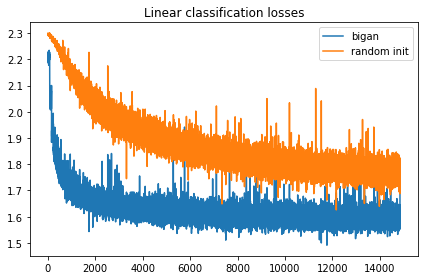

epoch:  188
BiGAN final linear classification loss: 1.6538970470428467
Random encoder linear classification loss: 1.8815293312072754
BiGAN final accuracy: 0.8896360759493671
Random encoder accuracy: 0.7544501582278481


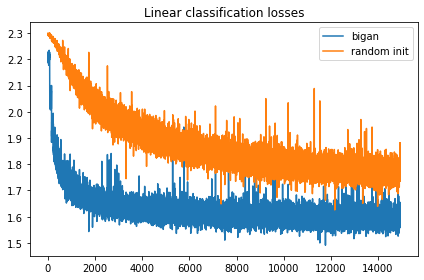

epoch:  189
BiGAN final linear classification loss: 1.7230130434036255
Random encoder linear classification loss: 1.6944725513458252
BiGAN final accuracy: 0.889932753164557
Random encoder accuracy: 0.7600870253164557


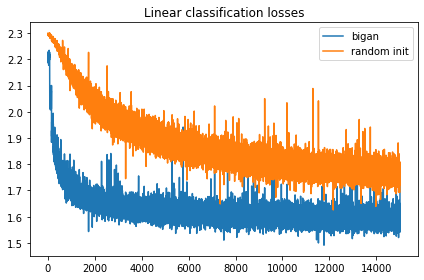

epoch:  190
BiGAN final linear classification loss: 1.7130173444747925
Random encoder linear classification loss: 1.8568466901779175
BiGAN final accuracy: 0.8870648734177216
Random encoder accuracy: 0.7543512658227848


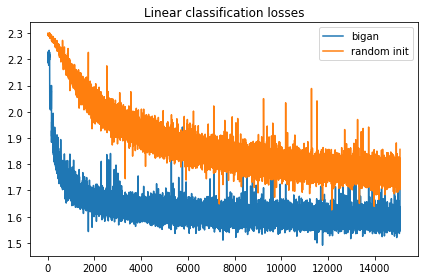

epoch:  191
BiGAN final linear classification loss: 1.6812350749969482
Random encoder linear classification loss: 1.7334916591644287
BiGAN final accuracy: 0.887559335443038
Random encoder accuracy: 0.7589992088607594


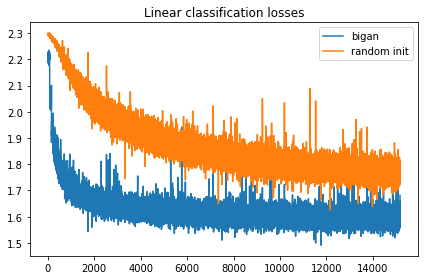

epoch:  192
BiGAN final linear classification loss: 1.7382980585098267
Random encoder linear classification loss: 1.7737791538238525
BiGAN final accuracy: 0.8895371835443038
Random encoder accuracy: 0.758504746835443


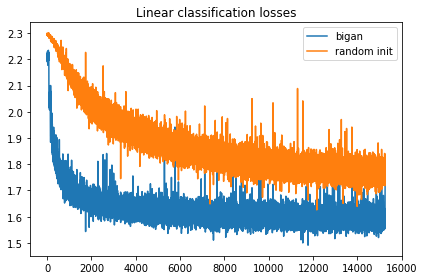

epoch:  193
BiGAN final linear classification loss: 1.5562208890914917
Random encoder linear classification loss: 1.7500320672988892
BiGAN final accuracy: 0.8873615506329114
Random encoder accuracy: 0.755439082278481


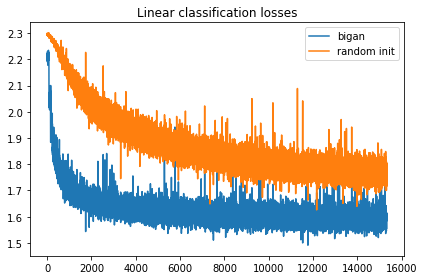

epoch:  194
BiGAN final linear classification loss: 1.6949392557144165
Random encoder linear classification loss: 1.8228689432144165
BiGAN final accuracy: 0.8857792721518988
Random encoder accuracy: 0.7610759493670886


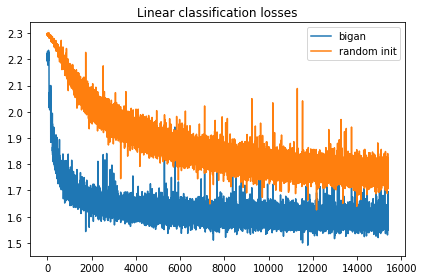

epoch:  195
BiGAN final linear classification loss: 1.5457276105880737
Random encoder linear classification loss: 1.6688531637191772
BiGAN final accuracy: 0.8895371835443038
Random encoder accuracy: 0.7560324367088608


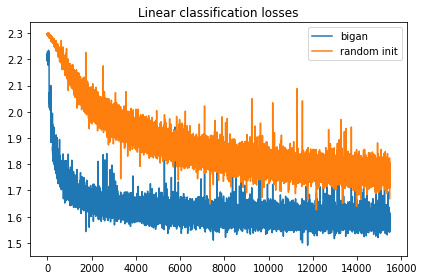

epoch:  196
BiGAN final linear classification loss: 1.5268123149871826
Random encoder linear classification loss: 1.806835412979126
BiGAN final accuracy: 0.8900316455696202
Random encoder accuracy: 0.7572191455696202


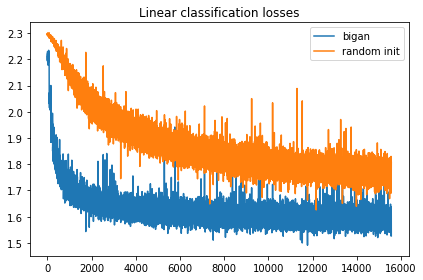

epoch:  197
BiGAN final linear classification loss: 1.5384571552276611
Random encoder linear classification loss: 1.8018838167190552
BiGAN final accuracy: 0.8885482594936709
Random encoder accuracy: 0.7595925632911392


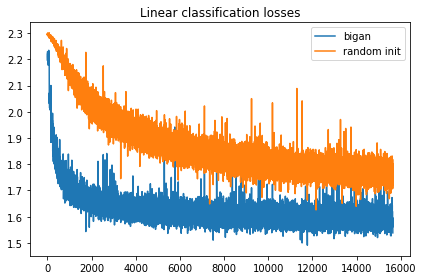

epoch:  198
BiGAN final linear classification loss: 1.6172115802764893
Random encoder linear classification loss: 1.8366565704345703
BiGAN final accuracy: 0.8869659810126582
Random encoder accuracy: 0.7596914556962026


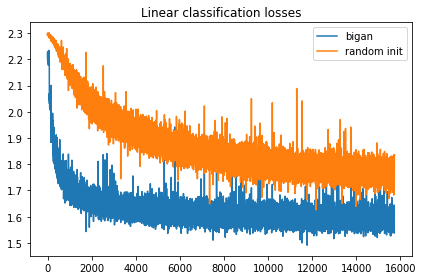

epoch:  199
BiGAN final linear classification loss: 1.7589277029037476
Random encoder linear classification loss: 1.7159227132797241
BiGAN final accuracy: 0.8856803797468354
Random encoder accuracy: 0.7589992088607594


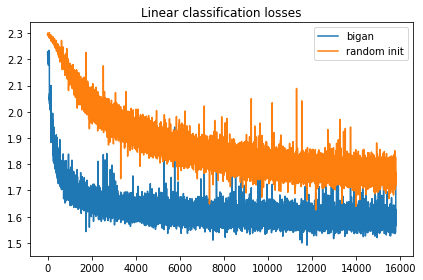

TypeError: ignored

In [ ]:
L1 = L().cuda()
def train_classifier(train_data, test_data):
    train_loader = data.DataLoader(train_data, batch_size=128, shuffle=True)
    test_loader = data.DataLoader(test_data, batch_size=128, shuffle=True)
    global model
    global L1
    random_encoder = E().cuda()
    L2 = L().cuda()
    E_optimizer = optim.SGD(L1.parameters(), lr=1e-2)
    rand_e_optimizer = optim.SGD(L2.parameters(), lr=1e-2)
    classifier1_loss = []
    classifier2_loss = []
    for epoch in range(200):
        print("epoch: ", epoch)
        train_encoder(model.E, L1, E_optimizer, train_loader)
        train_encoder(random_encoder, L2, rand_e_optimizer, train_loader)
        losses1, accuracy1 = test_encoder(model.E, L1, E_optimizer, test_loader)
        classifier1_loss.extend(losses1)
        losses2, accuracy2 = test_encoder(random_encoder, L2, rand_e_optimizer, test_loader)
        classifier2_loss.extend(losses2)
        print('BiGAN final linear classification loss:', classifier1_loss[-1])
        print('Random encoder linear classification loss:', classifier2_loss[-1])
        print('BiGAN final accuracy:', accuracy1)
        print('Random encoder accuracy:', accuracy2)
        plot_q3_supervised(classifier1_loss, classifier2_loss, 'Linear classification losses', 'results/q3_supervised_losses.png')
q3_save_results(train_classifier)

# Question 4 (Bonus): CycleGAN [20pt]
In this question, you'll train a CycleGAN model to learn to translate between two different image domains, without any paired data. Execute the following cell to visualize our two datasets: MNIST and Colored MNIST. 

Extracting ./data/MNIST/raw/train-images-idx3-ubyte.gz to ./data/MNIST/raw


Extracting ./data/MNIST/raw/train-labels-idx1-ubyte.gz to ./data/MNIST/raw



Extracting ./data/MNIST/raw/t10k-images-idx3-ubyte.gz to ./data/MNIST/raw


Extracting ./data/MNIST/raw/t10k-labels-idx1-ubyte.gz to ./data/MNIST/raw
Processing...
Done!



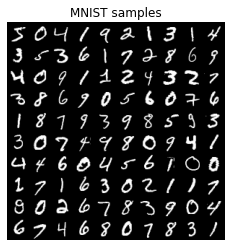

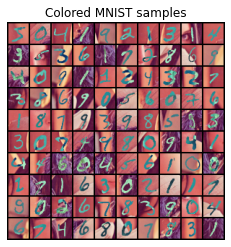

In [ ]:
visualize_cyclegan_datasets()

In [ ]:
import functools
class ResnetGenerator(nn.Module):
    """Resnet-based generator that consists of Resnet blocks between a few downsampling/upsampling operations.
    We adapt Torch code and idea from Justin Johnson's neural style transfer project(https://github.com/jcjohnson/fast-neural-style)
    """

    def __init__(self, input_nc, output_nc, ngf=64, norm_layer=nn.BatchNorm2d, use_dropout=False, n_blocks=6, padding_type='reflect'):
        """Construct a Resnet-based generator
        Parameters:
            input_nc (int)      -- the number of channels in input images
            output_nc (int)     -- the number of channels in output images
            ngf (int)           -- the number of filters in the last conv layer
            norm_layer          -- normalization layer
            use_dropout (bool)  -- if use dropout layers
            n_blocks (int)      -- the number of ResNet blocks
            padding_type (str)  -- the name of padding layer in conv layers: reflect | replicate | zero
        """
        assert(n_blocks >= 0)
        super(ResnetGenerator, self).__init__()
        if type(norm_layer) == functools.partial:
            use_bias = norm_layer.func == nn.InstanceNorm2d
        else:
            use_bias = norm_layer == nn.InstanceNorm2d

        model = [nn.ReflectionPad2d(3),
                 nn.Conv2d(input_nc, ngf, kernel_size=7, padding=0, bias=use_bias),
                 norm_layer(ngf),
                 nn.ReLU(True)]

        n_downsampling = 2
        for i in range(n_downsampling):  # add downsampling layers
            mult = 2 ** i
            model += [nn.Conv2d(ngf * mult, ngf * mult * 2, kernel_size=3, stride=2, padding=1, bias=use_bias),
                      norm_layer(ngf * mult * 2),
                      nn.ReLU(True)]

        mult = 2 ** n_downsampling
        for i in range(n_blocks):       # add ResNet blocks

            model += [ResnetBlock(ngf * mult, padding_type=padding_type, norm_layer=norm_layer, use_dropout=use_dropout, use_bias=use_bias)]

        for i in range(n_downsampling):  # add upsampling layers
            mult = 2 ** (n_downsampling - i)
            model += [nn.ConvTranspose2d(ngf * mult, int(ngf * mult / 2),
                                         kernel_size=3, stride=2,
                                         padding=1, output_padding=1,
                                         bias=use_bias),
                      norm_layer(int(ngf * mult / 2)),
                      nn.ReLU(True)]
        model += [nn.ReflectionPad2d(3)]
        model += [nn.Conv2d(ngf, output_nc, kernel_size=7, padding=0)]
        model += [nn.Tanh()]

        self.model = nn.Sequential(*model)

    def forward(self, input):
        """Standard forward"""
        return self.model(input)
class ResnetBlock(nn.Module):
    """Define a Resnet block"""

    def __init__(self, dim, padding_type, norm_layer, use_dropout, use_bias):
        """Initialize the Resnet block
        A resnet block is a conv block with skip connections
        We construct a conv block with build_conv_block function,
        and implement skip connections in <forward> function.
        Original Resnet paper: https://arxiv.org/pdf/1512.03385.pdf
        """
        super(ResnetBlock, self).__init__()
        self.conv_block = self.build_conv_block(dim, padding_type, norm_layer, use_dropout, use_bias)

    def build_conv_block(self, dim, padding_type, norm_layer, use_dropout, use_bias):
        """Construct a convolutional block.
        Parameters:
            dim (int)           -- the number of channels in the conv layer.
            padding_type (str)  -- the name of padding layer: reflect | replicate | zero
            norm_layer          -- normalization layer
            use_dropout (bool)  -- if use dropout layers.
            use_bias (bool)     -- if the conv layer uses bias or not
        Returns a conv block (with a conv layer, a normalization layer, and a non-linearity layer (ReLU))
        """
        conv_block = []
        p = 0
        if padding_type == 'reflect':
            conv_block += [nn.ReflectionPad2d(1)]
        elif padding_type == 'replicate':
            conv_block += [nn.ReplicationPad2d(1)]
        elif padding_type == 'zero':
            p = 1
        else:
            raise NotImplementedError('padding [%s] is not implemented' % padding_type)

        conv_block += [nn.Conv2d(dim, dim, kernel_size=3, padding=p, bias=use_bias), norm_layer(dim), nn.ReLU(True)]
        if use_dropout:
            conv_block += [nn.Dropout(0.5)]

        p = 0
        if padding_type == 'reflect':
            conv_block += [nn.ReflectionPad2d(1)]
        elif padding_type == 'replicate':
            conv_block += [nn.ReplicationPad2d(1)]
        elif padding_type == 'zero':
            p = 1
        else:
            raise NotImplementedError('padding [%s] is not implemented' % padding_type)
        conv_block += [nn.Conv2d(dim, dim, kernel_size=3, padding=p, bias=use_bias), norm_layer(dim)]

        return nn.Sequential(*conv_block)

    def forward(self, x):
        """Forward function (with skip connections)"""
        out = x + self.conv_block(x)  # add skip connections
        return out

def discriminator(num_in):
    """
    Build and return a PyTorch model implementing the architecture above.
    """
    model = nn.Sequential(

        nn.Conv2d(num_in, 64, kernel_size=4, stride=2),
        nn.LeakyReLU(0.2),
        
        nn.Conv2d(64, 128, kernel_size=4, stride=2),
        nn.InstanceNorm2d(128),
        nn.LeakyReLU(0.2),
        
        # nn.Conv2d(128, 256, kernel_size=4, stride=2),
        # nn.InstanceNorm2d(256),
        # nn.LeakyReLU(0.2),
        
        # nn.Conv2d(256, 512, kernel_size=4, stride=2),
        # nn.InstanceNorm2d(512),
        # nn.LeakyReLU(0.2),
        
        nn.Conv2d(128, 1, kernel_size=4, stride=2),
#         nn.Conv2d(1, 1, kernel_size=6), #wtf it's a 1x6x6 ??
        Flatten()
        
    )
    return model

def generator(num_in, num_out):
    model = nn.Sequential(
        ResnetGenerator(input_nc=num_in, output_nc=num_out, ngf=64, norm_layer=nn.InstanceNorm2d, n_blocks=9)
    )
    return model

def encoder(num_in, num_out):
    """
    Build and return a PyTorch model implementing the architecture above.
    """
    model = nn.Sequential(
        nn.Conv2d(num_in, 64, kernel_size=7, stride=1, padding=3, padding_mode='reflection'),#7x7, 3-64 channels
        nn.InstanceNorm2d(64),
        nn.LeakyReLU(0.0),
        
        
        nn.Conv2d(64, 128, kernel_size=3, stride=2, padding=1, padding_mode='reflection'), #downsample twice, doubling channels
        nn.InstanceNorm2d(128),
        nn.LeakyReLU(0.0),
        
        nn.Conv2d(128, 256, kernel_size=3, stride=2, padding=1, padding_mode='reflection'), #downsample twice, doubling channels
        nn.InstanceNorm2d(256),
        nn.LeakyReLU(0.0),
        
        ResnetBlock(256, padding_type='reflect', norm_layer=nn.InstanceNorm2d, use_dropout=False, use_bias=True),
        ResnetBlock(256, padding_type='reflect', norm_layer=nn.InstanceNorm2d, use_dropout=False, use_bias=True),
        ResnetBlock(256, padding_type='reflect', norm_layer=nn.InstanceNorm2d, use_dropout=False, use_bias=True),
        ResnetBlock(256, padding_type='reflect', norm_layer=nn.InstanceNorm2d, use_dropout=False, use_bias=True),
        ResnetBlock(256, padding_type='reflect', norm_layer=nn.InstanceNorm2d, use_dropout=False, use_bias=True),
        ResnetBlock(256, padding_type='reflect', norm_layer=nn.InstanceNorm2d, use_dropout=False, use_bias=True),
        ResnetBlock(256, padding_type='reflect', norm_layer=nn.InstanceNorm2d, use_dropout=False, use_bias=True),
        ResnetBlock(256, padding_type='reflect', norm_layer=nn.InstanceNorm2d, use_dropout=False, use_bias=True),
        ResnetBlock(256, padding_type='reflect', norm_layer=nn.InstanceNorm2d, use_dropout=False, use_bias=True),

        
        nn.ConvTranspose2d(256, 128, kernel_size=3, stride=2, padding=1, output_padding=1),
        nn.ConvTranspose2d(128, 64, kernel_size=3, stride=2, padding=1, output_padding=1),
        nn.Conv2d(64, num_out, kernel_size=7, stride=1, padding=3),
    )
    return model
class Flatten(nn.Module):
    def forward(self, x):
        #N, C, H, W = x.size() # read in N, C, H, W
        N = x.size()[0]
        return x.view(N, -1)  # "flatten" the C * H * W values into a single vector per image
def preprocess(data):
  return data * 2 - 1

In [CycleGAN](https://arxiv.org/pdf/1703.10593.pdf), the goal is to learn functions $F$ and $G$ that can transform images from $X \rightarrow Y$ and vice-versa. This is an unconstrained problem, so we additionally enforce the *cycle-consistency* property, where we want 
$$x \approx G(F(x))$$
and  
$$y \approx F(G(x))$$
This loss function encourages $F$ and $G$ to approximately invert each other. In addition to this cycle-consistency loss, we also have a standard GAN loss such that $F(x)$ and $G(y)$ look like real images from the other domain. 

Since this is a bonus question, we won't do much hand-holding. We recommend reading through the original paper to get a sense of what architectures and hyperparameters are useful. Note that our datasets are fairly simple, so you won't need excessively large models. 

**You will report the following deliverables**
1. A set of images showing real MNIST digits, transformations of those images into Colored MNIST digits, and reconstructions back into the greyscale domain. 
2. A set of images showing real Colored MNIST digits, transformations of those images, and reconstructions. 

## Solution

In [ ]:
import collections
def run_a_gan(loader_trainA, loader_trainB, Dy, Dx, G, F, Dy_solver, Dx_solver, G_solver, F_solver, discriminator_loss, generator_loss, cycle_loss, show_every=1000000000, batch_size=1, num_epochs=200):
    """
    Train a GAN!
    
    Inputs:
    - D, G: PyTorch models for the discriminator and generator
    - D_solver, G_solver: torch.optim Optimizers to use for training the
      discriminator and generator.
    - discriminator_loss, generator_loss: Functions to use for computing the generator and
      discriminator loss, respectively.
    - show_every: Show samples after every show_every iterations.
    - batch_size: Batch size to use for training.
    - noise_size: Dimension of the noise to use as input to the generator.
    - num_epochs: Number of epochs over the training dataset to use for training.
    """
    iter_count = 0
    buffer_x = collections.deque([], 50) #Shrivastava et al, using 50 previous generated to update the discriminator
    buffer_y = collections.deque([], 50)
    optimizers = [Dy_solver, Dx_solver, G_solver, F_solver]
    for epoch in range(num_epochs):
        for (x, y) in zip(loader_trainA, loader_trainB):
            # training the discriminator
            x = x.to(device).float()
            y = y.to(device).float()
            
            g_x = G(x)
            f_g_x = F(g_x)
            f_y = F(y)
            g_f_y = G(f_y)
            
            buffer_x.appendleft(f_y.detach()) #fake x image
            buffer_y.appendleft(g_x.detach()) #fake y image
            
            dy_g_x = Dy(torch.cat(list(buffer_y)).to(device))
            dy_y = Dy(y)


            dx_f_y = Dx(torch.cat(list(buffer_x)).to(device))
            dx_x = Dx(x)
            
            Dy_solver.zero_grad()
            Dx_solver.zero_grad()
            
            d_total_error = discriminator_loss(dy_g_x, dx_f_y, dy_y, dx_x)
            d_total_error.backward(retain_graph=True)
            
            Dy_solver.step()
            Dx_solver.step()
            
            
            #training the generator
            G_solver.zero_grad()
            F_solver.zero_grad()
            
            g_error = generator_loss(dy_g_x, dx_f_y)
            g_error.backward(retain_graph=True)
            
            c_error = cycle_loss(x, f_g_x, y, g_f_y)
            c_error.backward()

            G_solver.step()
            F_solver.step()
            
            for optimer in optimizers:
                for g in optimer.param_groups:
                    g['lr'] = 2e-4 * (1 if epoch < 100 else (200 - epoch) / 100)

            if (iter_count % show_every == 0):
                print('Iter: {}, Epoch: {}, D: {:.4}, G:{:.4}, C:{:.4}'.format(iter_count, epoch, d_total_error.item(), g_error.item(), c_error.item()))
                print("domain x, domain y, domain x real/reconstruction, domain y real/reconstruction")
                plt.imshow(g_x[0].detach().cpu().numpy().transpose([1, 2, 0]))
                plt.show()
                plt.imshow(f_y[0].detach().cpu().numpy()[0]) #.transpose([1, 2, 0]))
                plt.show()
                
                plt.imshow(x[0].detach().cpu().numpy()[0]) #.transpose([1, 2, 0]))
                plt.show()
                plt.imshow(f_g_x[0].detach().cpu().numpy()[0])#.transpose([1, 2, 0]))
                plt.show()
            
                plt.imshow(y[0].detach().cpu().numpy().transpose([1, 2, 0]))
                plt.show()                

                plt.imshow(g_f_y[0].detach().cpu().numpy().transpose([1, 2, 0]))
                plt.show()
            iter_count += 1

LAMBDA = 10
def generator_losses(dy_g_x, dx_f_y):
    """
    Computes the discriminator loss described above.
    
    Inputs:
    - logits_real: PyTorch Tensor of shape (N,) giving scores for the real data.
    - logits_fake: PyTorch Tensor of shape (N,) giving scores for the fake data.
                N should be equal to 1, because batch size is 1
    Returns:
    - loss: PyTorch Tensor containing (scalar) the loss for the discriminator.
    """
    loss = torch.mean((1-dy_g_x) ** 2) + torch.mean((1-dx_f_y) ** 2)
    return 0.5 * loss
def discriminator_losses(dy_g_x, dx_f_y, dy_y, dx_x):
    #should get a batch of previous 50 generated images
    # the discriminator outputs a 1x__ sized array of patches, each entry indicating if it thinks it's real or false
    loss = torch.mean((dy_y - 1) ** 2) + torch.mean(dy_g_x ** 2) + torch.mean((dx_x - 1) ** 2) + torch.mean(dx_f_y ** 2)
    return loss
def cycle_loss(x, f_g_x, y, g_f_y):
    loss = torch.mean(torch.abs(x - f_g_x)) + torch.mean(torch.abs(y - g_f_y))
    return LAMBDA * loss
def get_optimizer(model):
    optimizer = optim.Adam(model.parameters(), lr=2e-4)
    return optimizer
device = 'cuda'
def q4(mnist_data, cmnist_data):
    """
    mnist_data: An (60000, 1, 28, 28) numpy array of black and white images with values in [0, 1]
    cmnist_data: An (60000, 3, 28, 28) numpy array of colored images with values in [0, 1]

    Returns
    - a (20, 28, 28, 1) numpy array of real MNIST digits, in [0, 1]
    - a (20, 28, 28, 3) numpy array of translated Colored MNIST digits, in [0, 1]
    - a (20, 28, 28, 1) numpy array of reconstructed MNIST digits, in [0, 1]

    - a (20, 28, 28, 3) numpy array of real Colored MNIST digits, in [0, 1]
    - a (20, 28, 28, 1) numpy array of translated MNIST digits, in [0, 1]
    - a (20, 28, 28, 3) numpy array of reconstructed Colored MNIST digits, in [0, 1]
    """
    """ YOUR CODE HERE """
    print("preprocessing data")
    mnist_data = preprocess(mnist_data)
    cmnist_data = preprocess(cmnist_data)
    # _, _, H, W = mnist_data.shape
    # epochs = 100
    print("putting into a loader")
    loader_trainA = data.DataLoader(mnist_data, batch_size=1, shuffle=True)
    loader_trainB = data.DataLoader(cmnist_data, batch_size=1, shuffle=True)


    # Make the discriminator
    global Dx, Dy, G, F
    # print("making discrims")
    # Dx = discriminator(1).to(device)
    # Dy = discriminator(3).to(device)

    # # Make the generator
    # print("making gennerators")
    # G = generator(1, 3).to(device)
    # F = generator(3, 1).to(device)

    # Use the function you wrote earlier to get optimizers for the Discriminator and the Generator
    Dx_solver = get_optimizer(Dx)
    Dy_solver = get_optimizer(Dy)
    G_solver = get_optimizer(G)
    F_solver = get_optimizer(F)
    print("running gans")
    run_a_gan(loader_trainA, loader_trainB, Dy, Dx, G, F, Dy_solver, Dx_solver, G_solver, F_solver, discriminator_losses, generator_losses, cycle_loss, batch_size=1, num_epochs=10)

    mnist_data, cmnist_data = preprocess(mnist_data[:20]), preprocess(cmnist_data[:20])
    real_mnist = torch.tensor(mnist_data[:20]).float().to(device)
    trans_real_mnist = G(real_mnist)
    rec_mnist = F(trans_real_mnist)

    real_cmnist = torch.tensor(cmnist_data[:20]).float().to(device)
    trans_real_cmnist = F(real_cmnist)
    rec_cmnist = G(trans_real_cmnist)

    toR = [real_mnist, trans_real_mnist, rec_mnist, real_cmnist, trans_real_cmnist, rec_cmnist]
    for arr in toR:
      print(arr.shape)
    return [0.5 * (tens.detach().cpu().numpy().transpose(0, 2, 3, 1) + 1) for tens in toR]



In [ ]:
def q4_res(mnist_data, cmnist_data):
    global G, F
    mnist_data, cmnist_data = preprocess(mnist_data[:20]), preprocess(cmnist_data[:20])
    real_mnist = torch.tensor(mnist_data[:20]).float().to(device)
    trans_real_mnist = G(real_mnist)
    rec_mnist = F(trans_real_mnist)

    real_cmnist = torch.tensor(cmnist_data[:20]).float().to(device)
    trans_real_cmnist = F(real_cmnist)
    rec_cmnist = G(trans_real_cmnist)

    toR = [real_mnist, trans_real_mnist, rec_mnist, real_cmnist, trans_real_cmnist, rec_cmnist]
    for arr in toR:
      print(arr.shape)
    return [0.5 * (tens.detach().cpu().numpy().transpose(0, 2, 3, 1) + 1) for tens in toR]

torch.Size([20, 1, 28, 28])
torch.Size([20, 3, 28, 28])
torch.Size([20, 1, 28, 28])
torch.Size([20, 3, 28, 28])
torch.Size([20, 1, 28, 28])
torch.Size([20, 3, 28, 28])


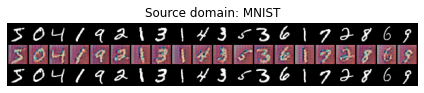

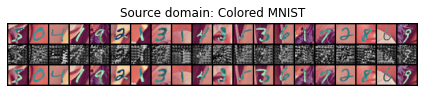

In [ ]:
q4_save_results(q4_res)

## Results

preprocessing data
putting into a loader
making discrims
making gennerators
running gans


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iter: 0, Epoch: 0, D: 0.8064, G:1.203, C:13.67
domain x, domain y, domain x real/reconstruction, domain y real/reconstruction


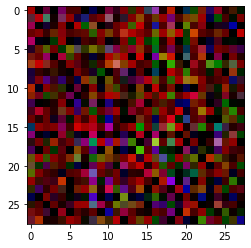

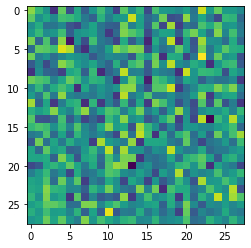

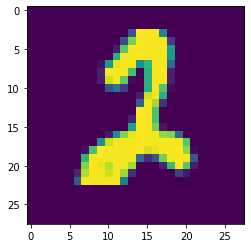

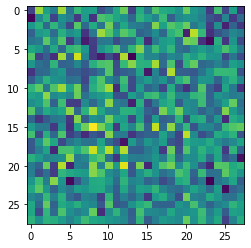

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


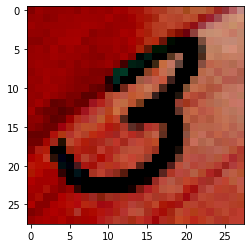

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


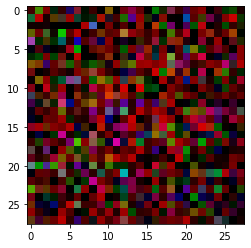

KeyboardInterrupt: ignored

In [ ]:
show_every = 100000000000
q4_save_results(q4)